In [1]:
%pylab inline

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.metrics.cluster import mutual_info_score
from sklearn.cluster import KMeans
from scipy.stats import entropy
import copy
import math
import os
import numpy as np
import matplotlib.pyplot as plt


## Model

In [3]:
class TransformerModel(nn.Module):
    def __init__(self, ntokens, emsize, nhead, d_hid, nlayers, dropout=0.5):
        super(TransformerModel, self).__init__()
        self.model_type = 'Transformer'
        self.src_mask = None
        self.pos_encoder = PositionalEncoding(emsize, dropout)
        encoder_layers = nn.TransformerEncoderLayer(emsize, nhead, d_hid, dropout)
        self.transformer_encoder = nn.TransformerEncoder(encoder_layers, nlayers)
        self.encoder = nn.Embedding(ntokens, emsize)
        self.emsize = emsize
        self.decoder = nn.Linear(emsize, ntokens)
        self.ntokens=ntokens
        self.init_weights()

    def _generate_square_subsequent_mask(self, sz):
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask

    def init_weights(self):
        initrange = 0.1
        self.encoder.weight.data.uniform_(-initrange, initrange)
        self.decoder.bias.data.zero_()
        self.decoder.weight.data.uniform_(-initrange, initrange)

    def forward(self, src,verbose=False):
        if self.src_mask is None or self.src_mask.size(0) != len(src):
            device = src.device
            mask = self._generate_square_subsequent_mask(len(src)).to(device)
            self.src_mask = mask

        src = self.encoder(src) * math.sqrt(self.emsize)
        src = self.pos_encoder(src)
        output = self.transformer_encoder(src, self.src_mask)
        self.store=output.detach().numpy().copy()
        if verbose:
            print(output.shape)
        output = self.decoder(output)
        return output

class PositionalEncoding(nn.Module):
    def __init__(self, d_model, dropout=0.1, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)

        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * -(math.log(10000.0) / d_model))
        pe = torch.zeros(max_len, 1, d_model)
        pe[:, 0, 0::2] = torch.sin(position * div_term)
        pe[:, 0, 1::2] = torch.cos(position * div_term)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.pe[:x.size(0)]
        return self.dropout(x)

# Parameters
ntokens = 8  # size of vocabulary
emsize = 20  # embedding dimension
nhead = 4  # number of heads in the nn.MultiheadAttention
d_hid = 20  # dimension of the feedforward network model in nn.TransformerEncoder
nlayers = 2  # number of nn.TransformerEncoderLayer
dropout = 0.03  # dropout probability

# Initialize the model
model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
print(model)

TransformerModel(
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.03, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-1): 2 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=20, out_features=20, bias=True)
        )
        (linear1): Linear(in_features=20, out_features=20, bias=True)
        (dropout): Dropout(p=0.03, inplace=False)
        (linear2): Linear(in_features=20, out_features=20, bias=True)
        (norm1): LayerNorm((20,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((20,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.03, inplace=False)
        (dropout2): Dropout(p=0.03, inplace=False)
      )
    )
  )
  (encoder): Embedding(8, 20)
  (decoder): Linear(in_features=20, out_features=8, bias=True)
)


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


## Test function

In [4]:
def test(model, source, target):
    model.eval()  # Set the model to evaluation mode
    correct = 0
    total = 0
    
    source = torch.tensor(source, dtype=torch.long)
    target = torch.tensor(target, dtype=torch.long)

    with torch.no_grad():  # No need to track gradients
        src = source.transpose(0, 1)  # Adjust for the expected input dimensions [sequence_length, batch_size]
        tgt = target.transpose(0, 1)  # Same adjustment for the target
        
        output = model(src)  # Compute the output
        
        # The output is [sequence_length, batch_size, ntokens]. Get the most likely token predictions
        predictions = output.argmax(dim=2)  # Get the index of the max log-probability
        print('prediction shape', predictions.shape)
        correct += (predictions == tgt).sum().item()  # Count how many predictions match the target
        total += tgt.numel()  # Total number of predictions
        
    accuracy = correct / total  # Calculate the accuracy
    return accuracy

## Dataset preparation

In [5]:

def getTrainingData(songStrings, nrOfSongs):
    notes = list("ABCDEFGHI")
    chord = [[0], [1], [2], [3], [4], [5], [6], [7],[8]]
    source = []
    target = []
    for s in range(nrOfSongs):
        for i in range(42):
            sentence = []
            answer = []
            for j in range(4):
                sentence.append(chord[notes.index(songStrings[s][(i+j)%42])][0])
                answer.append(chord[notes.index(songStrings[s][(i+j+1)%42])][0])
            source.append(sentence)
            target.append(answer)
    return np.array(source), np.array(target)

def split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction):
    total_rows = source.shape[0] // 2
    first_set_rows = int(total_rows * fraction)
    second_set_rows = total_rows - first_set_rows

    first_set_indices = np.random.choice(range(total_rows), first_set_rows, replace=False)
    second_set_indices = np.random.choice(range(total_rows, 2 * total_rows), second_set_rows, replace=False)

    combined_indices = np.concatenate((first_set_indices, second_set_indices))
    np.random.shuffle(combined_indices)

    input_list = source[combined_indices]
    output_list = target[combined_indices]

    return input_list, output_list


In [6]:
# Data generation and preparation
songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
    #"AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"
])

source_mixed, target_mixed = getTrainingData(songStrings, 2)
fraction = 0.5
input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source_mixed, target_mixed, fraction)

print(input_list.shape, output_list.shape)

(42, 4) (42, 4)


## Training and Testing for Songs GHI contradiction


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Model 0, Fraction 0.00, Epoch 1, Loss: 2.1875
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.3188
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.6090
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.2925
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.1767
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.1283
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.1045
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.0912
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.0830
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.0776
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.0712
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.0692
prediction sha

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Model 0, Fraction 0.10, Epoch 1, Loss: 2.2187
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 101, Loss: 1.3941
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 201, Loss: 0.7565
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 301, Loss: 0.4397
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 401, Loss: 0.2466
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 501, Loss: 0.1906
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 601, Loss: 0.1529
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 701, Loss: 0.1697
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 801, Loss: 0.1324
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 901, Loss: 0.1250
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1001, Loss: 0.1526
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1101, Loss: 0.1101
prediction shape 

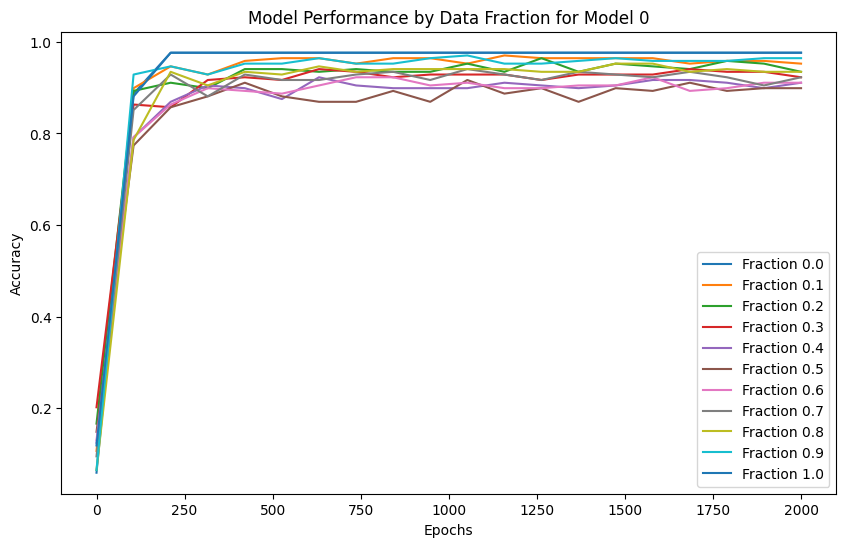

Model 1, Fraction 0.00, Epoch 1, Loss: 2.1942
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.3057
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.6458
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.3200
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.1923
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.1382
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.1112
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.0960
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.0867
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.0761
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.0730
prediction shape 

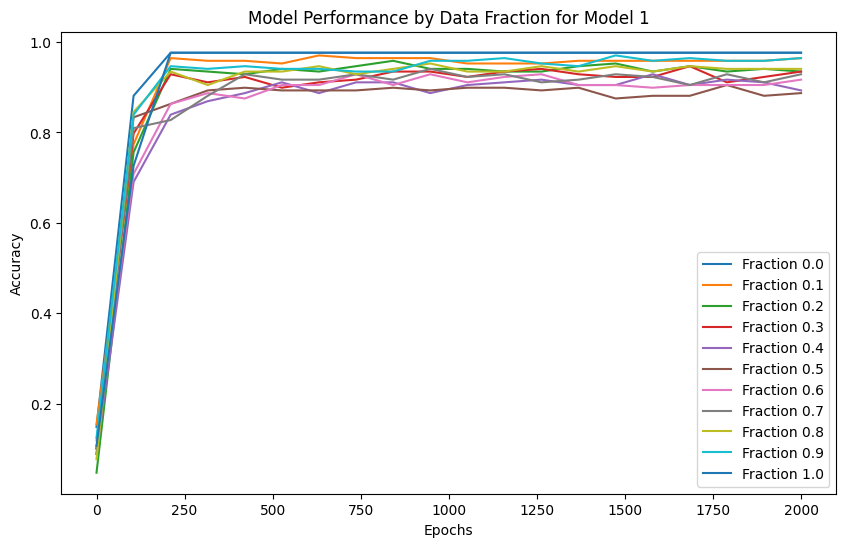

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2136
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.2582
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.5632
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.2747
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.1277
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.1053
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.0924
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.0842
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.0749
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.0721
prediction shape 

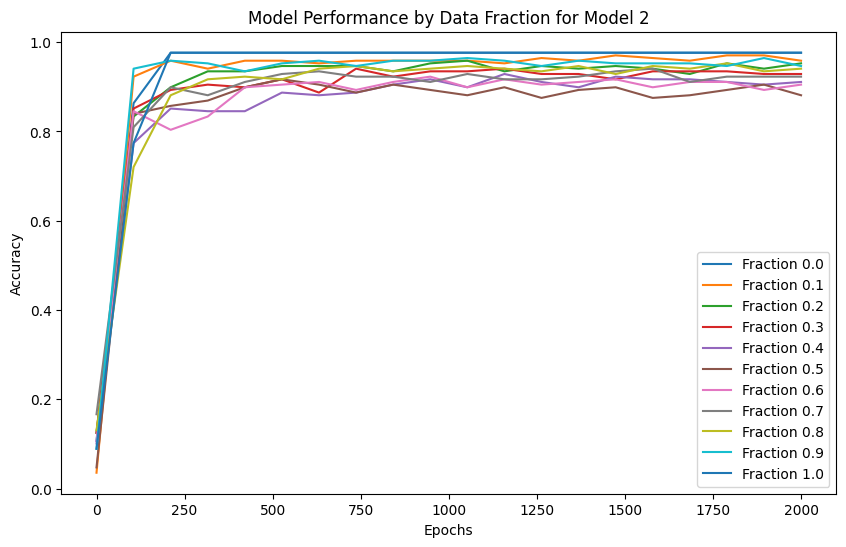

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2106
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.2436
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.5957
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.3040
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.1865
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.1349
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.1089
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.0942
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.0852
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.0752
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

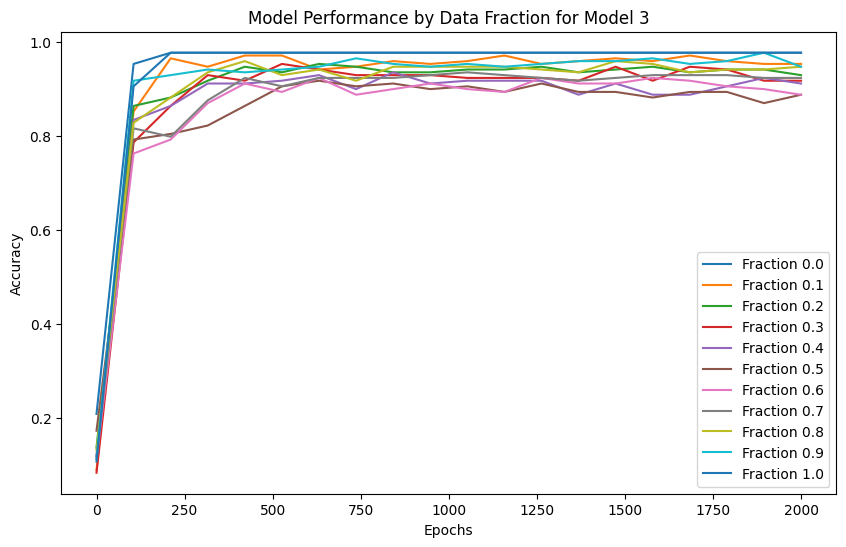

Model 4, Fraction 0.00, Epoch 1, Loss: 2.1975
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.3146
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.6224
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.3043
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.1863
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.1353
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.1095
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.0949
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.0858
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.0798
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.0756
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.0726
prediction shape 

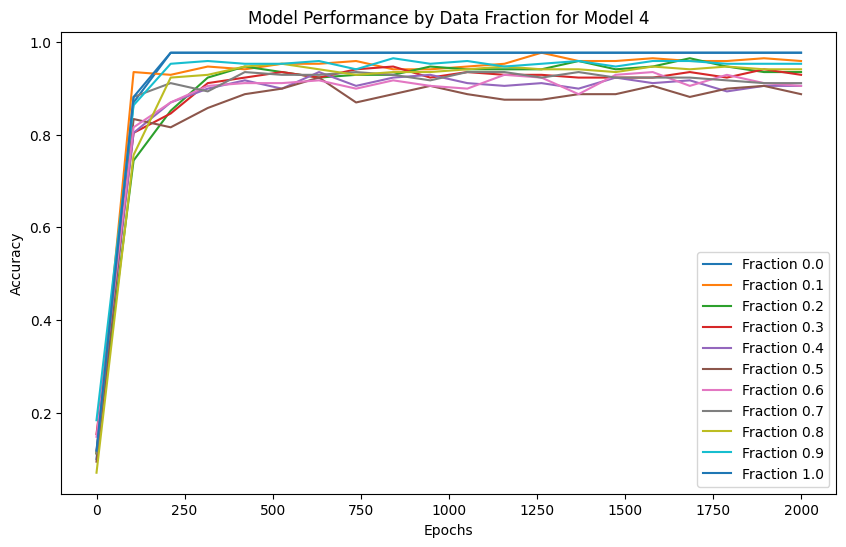

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2095
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.3088
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.5844
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.2832
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.1761
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.1300
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.1066
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.0931
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.0847
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.0723
prediction shape 

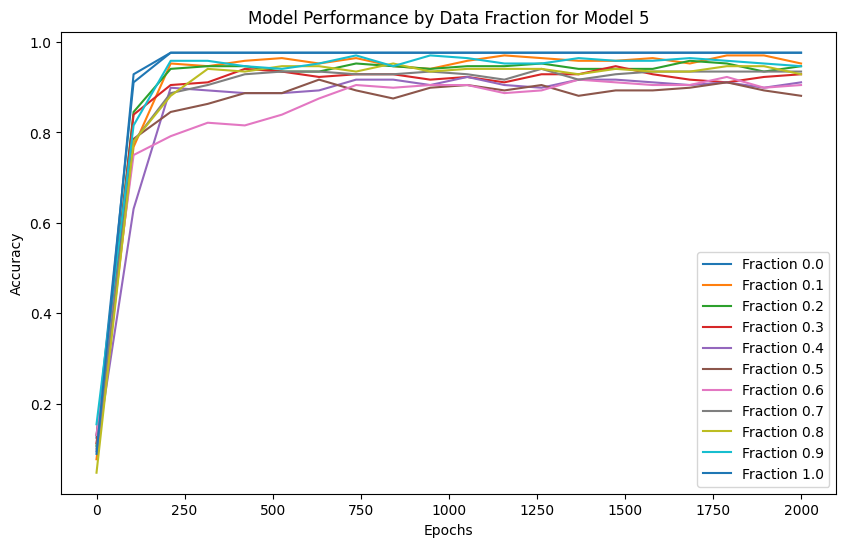

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2289
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.4221
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.6598
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.2981
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.1762
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.1275
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.1040
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.0909
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.0828
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.0775
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.0712
prediction shape 

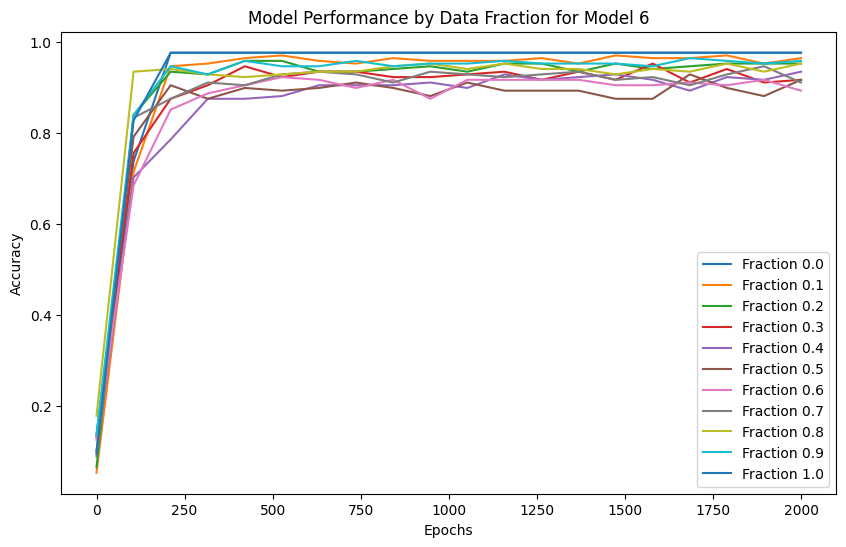

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2199
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.3784
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.6380
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.2990
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.1780
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.1291
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.1052
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.0918
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.0835
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.0781
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.0743
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.0716
prediction shape 

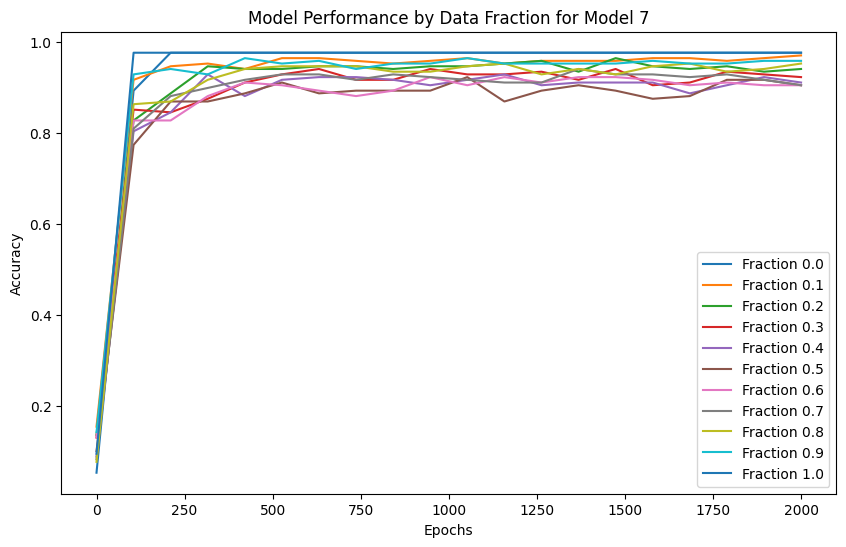

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2136
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.3647
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.6373
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.3100
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.1895
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.1378
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.1116
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.0966
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.0873
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.0810
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.0767
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.0735
prediction shape 

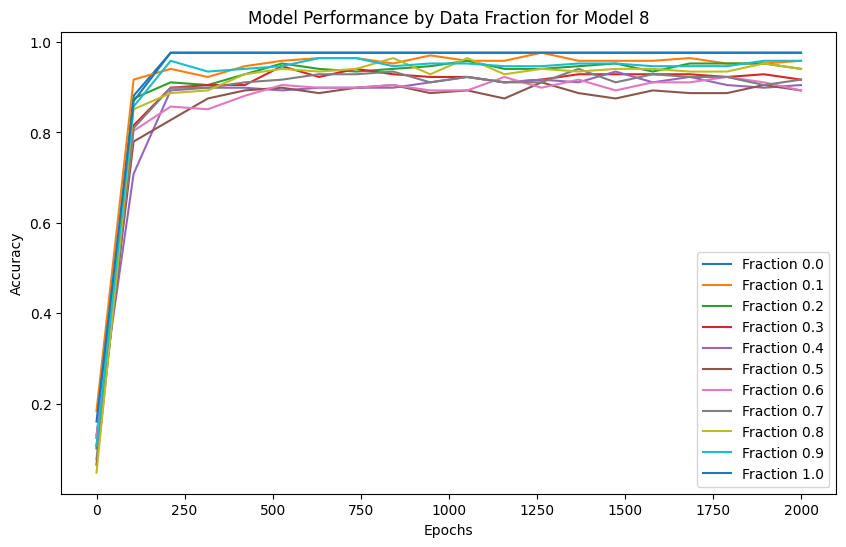

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2076
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.3072
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.5955
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.2934
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.1782
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.1292
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.1051
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.0916
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.0833
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.0779
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.0714
prediction shape 

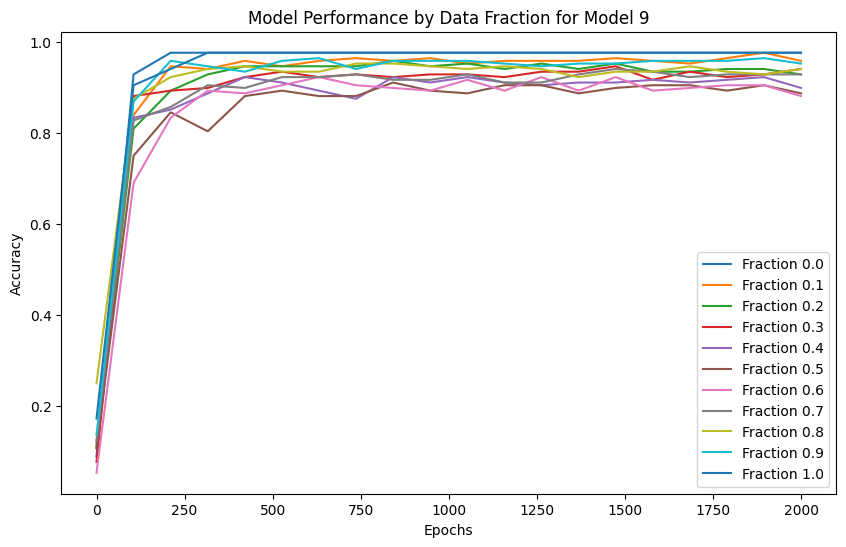

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2085
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.2912
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.5637
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.2775
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.1749
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.1300
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.1068
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.0933
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.0792
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.0752
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.0723
predi

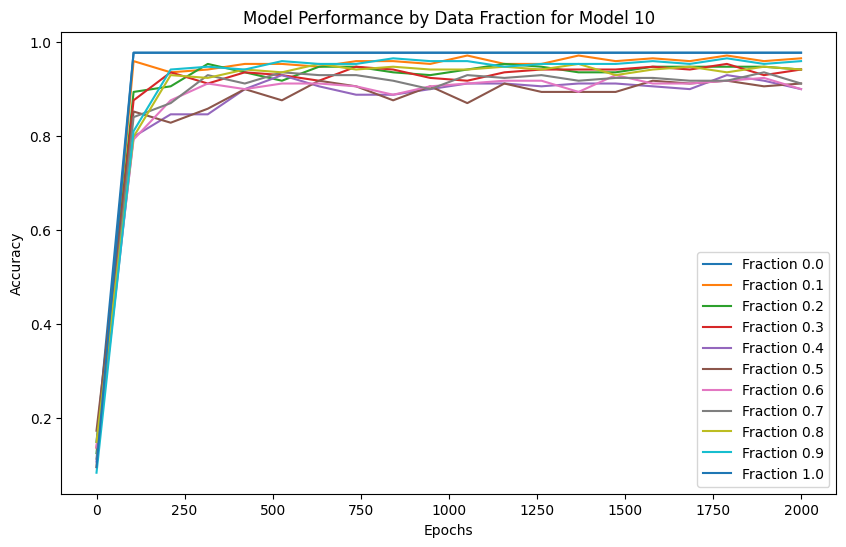

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2039
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.3113
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.5637
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.2686
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.1653
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.1220
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.1006
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.0886
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.0812
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.0763
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.0729
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.0704
predi

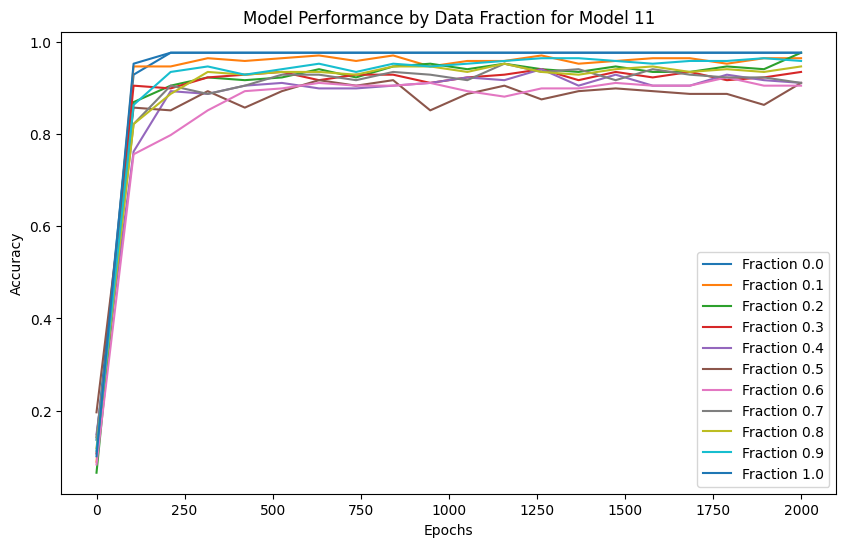

Model 12, Fraction 0.00, Epoch 1, Loss: 2.1904
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.2867
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.5990
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.2874
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.1752
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.1283
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.1050
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.0918
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.0836
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.0782
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.0716
predi

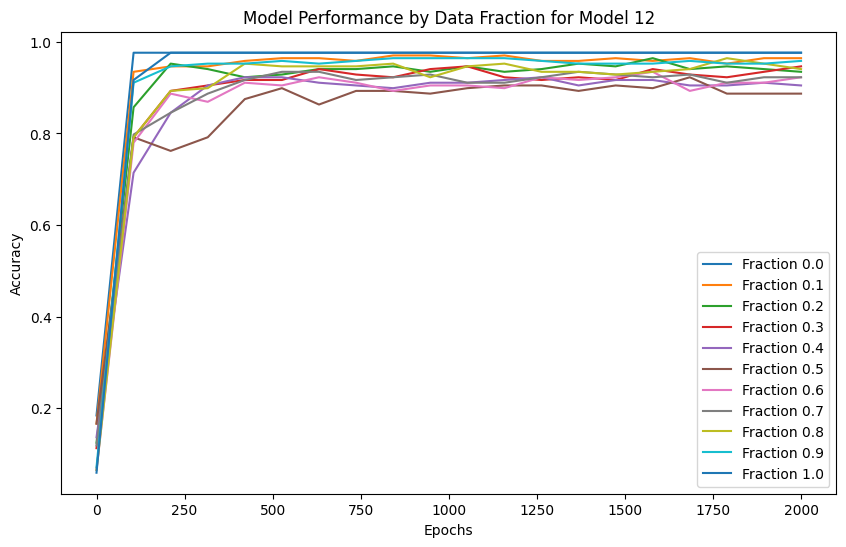

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2066
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.2959
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.5549
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.2766
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.1747
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.1298
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.1066
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.0931
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.0847
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.0790
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.0722
predi

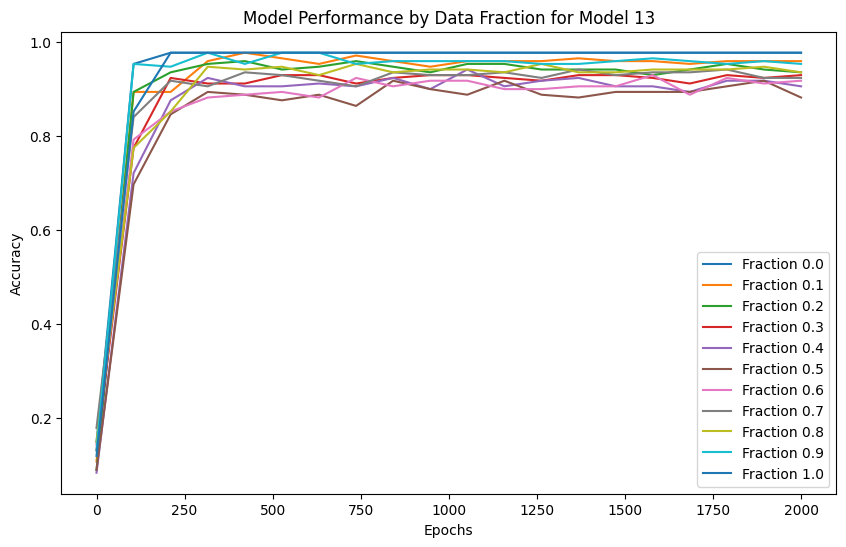

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2099
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.2707
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.5939
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.2868
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.1733
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.1267
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.1037
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.0908
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.0827
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.0775
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.0711
predi

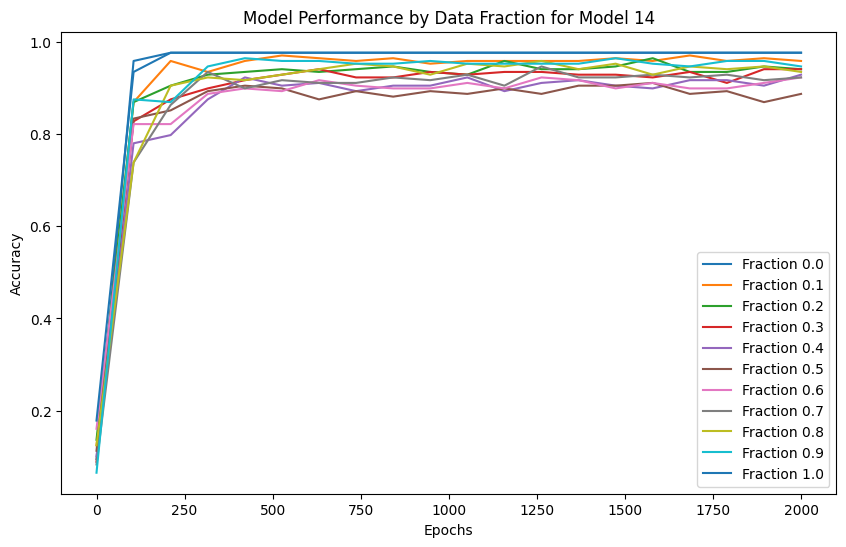

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2167
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.3066
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.6198
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.2888
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.1731
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.1265
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.1037
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.0908
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.0828
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.0776
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.0712
predi

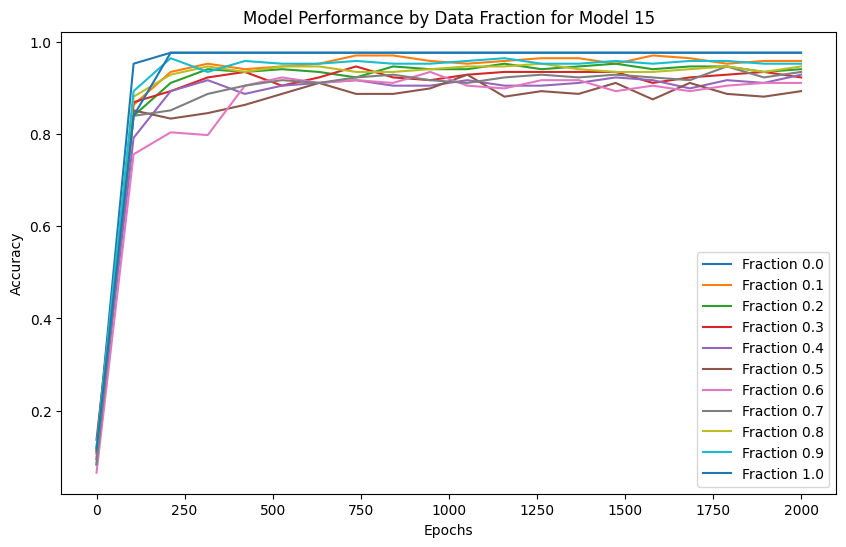

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2300
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.3061
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.5614
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.2700
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.1669
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.1239
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.1024
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.0902
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.0826
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.0774
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

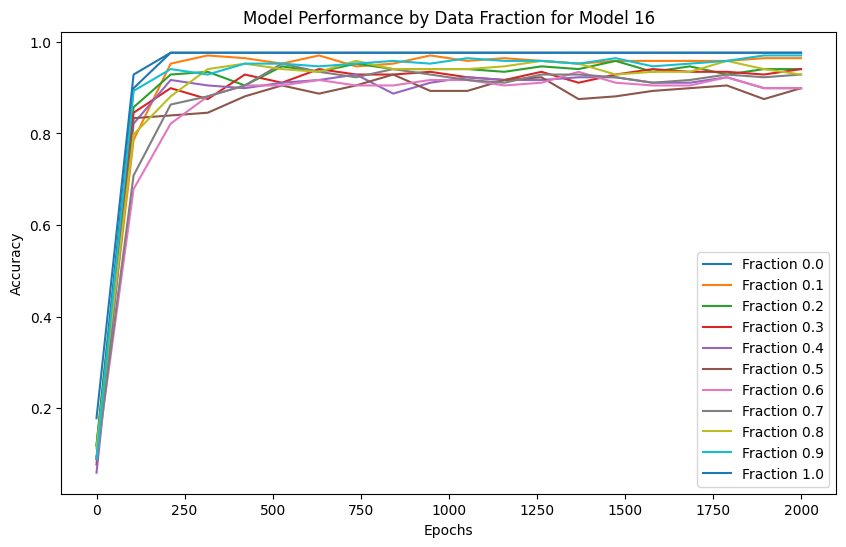

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2153
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.2981
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.6316
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.2992
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.1815
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.1326
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.1082
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.0942
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.0856
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.0798
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.0757
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.0727
predi

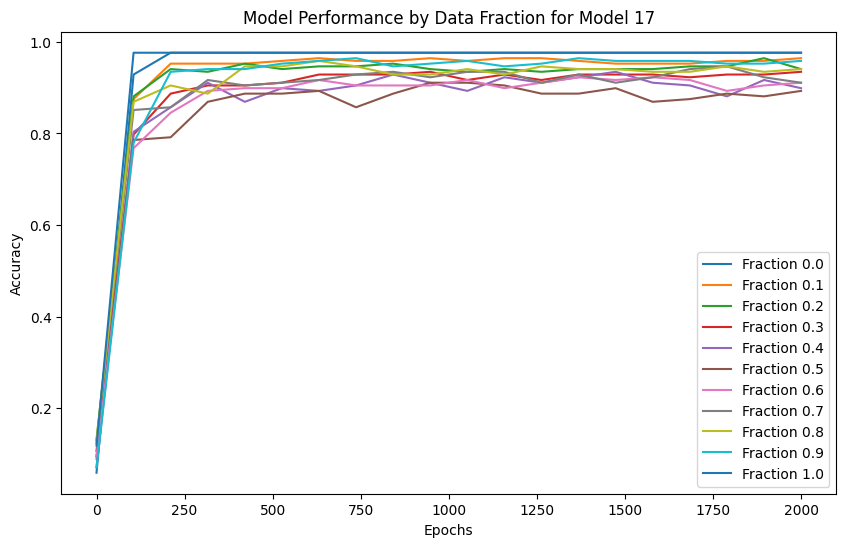

Model 18, Fraction 0.00, Epoch 1, Loss: 2.1961
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.2788
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.6283
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.3029
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.1807
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.1303
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.1057
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.0919
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.0835
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.0779
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

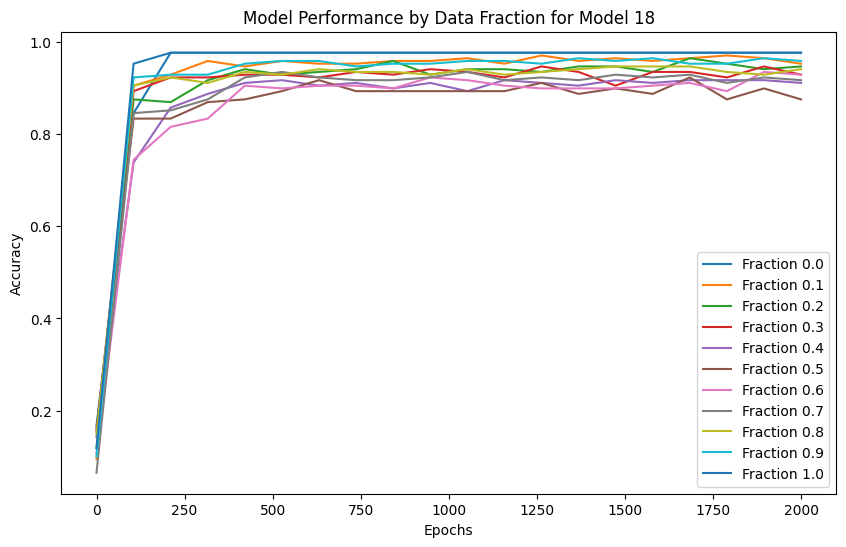

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2077
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.3040
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.6162
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.3143
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.1942
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.1403
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.1127
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.0970
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.0872
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.0808
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.0764
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.0731
predi

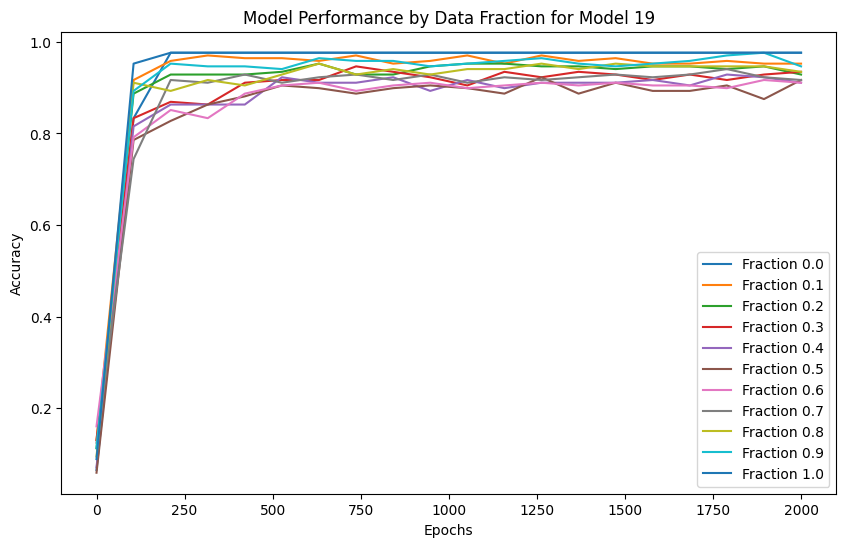

Model 20, Fraction 0.00, Epoch 1, Loss: 2.1884
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.2524
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.5792
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.2792
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.1718
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.1267
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.1042
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.0913
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.0833
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.0780
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.0743
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.0716
predi

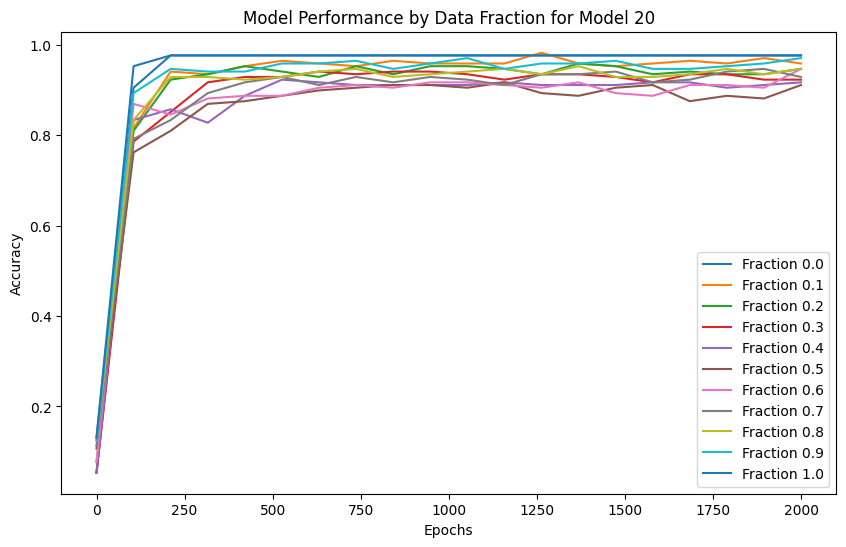

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2024
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.2891
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.5897
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.2889
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.1754
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.1277
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.1043
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.0912
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.0832
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.0779
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.0715
predi

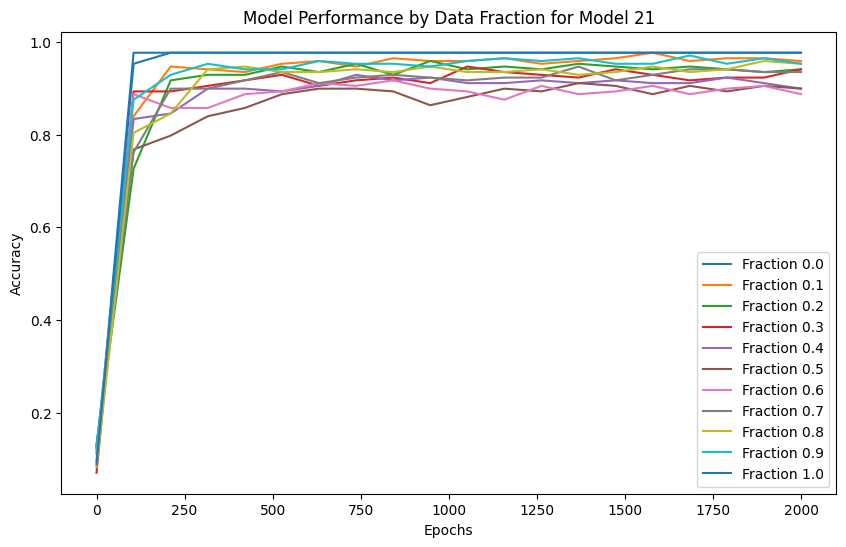

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2158
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.3653
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.7086
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.3722
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.2038
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.1363
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.1072
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.0921
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.0833
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.0777
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.0712
predi

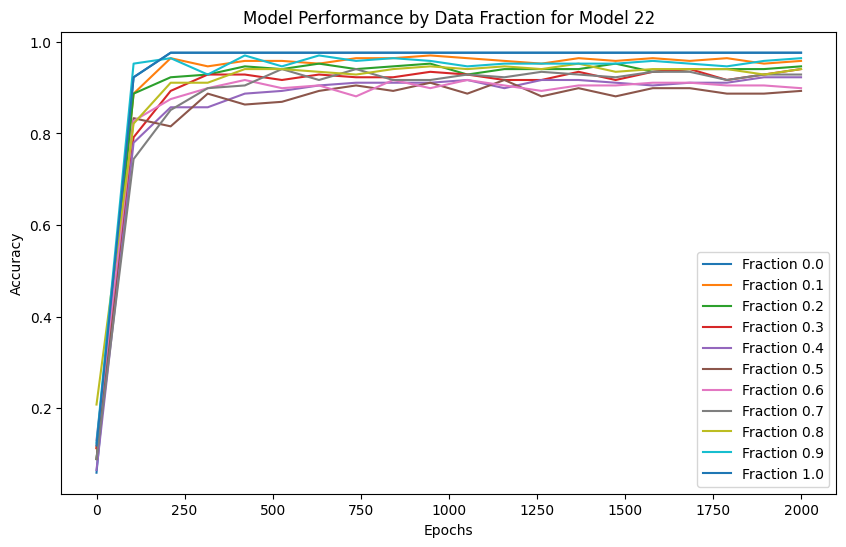

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2046
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.2809
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.6133
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.2881
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.1724
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.1260
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.1033
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.0906
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.0827
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.0775
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

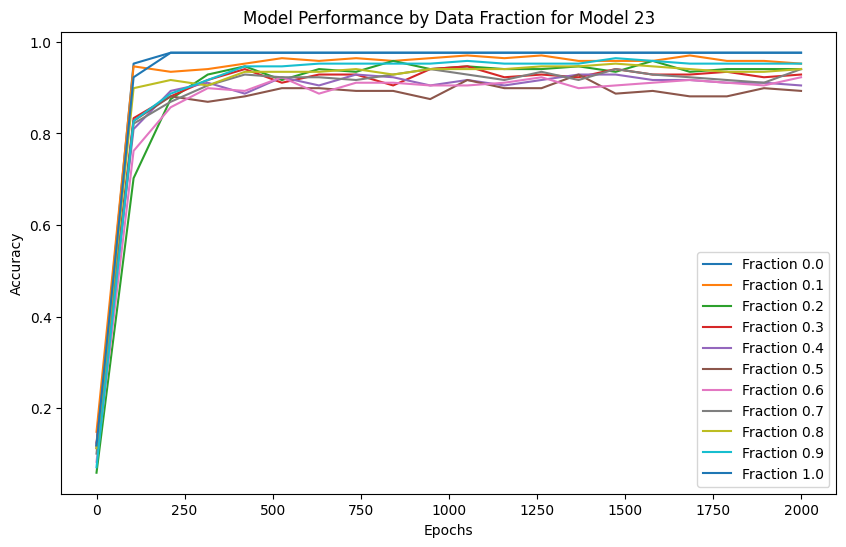

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2037
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.2894
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.5913
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.2755
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.1694
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.1254
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.1033
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.0907
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.0828
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.0776
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.0712
predi

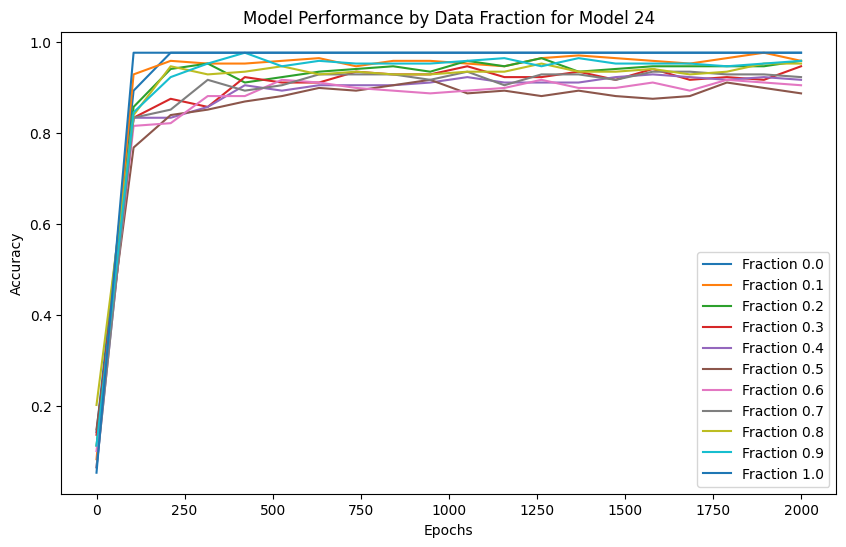

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2074
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.3232
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.5720
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.2785
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.1709
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.1260
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.1034
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.0906
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.0827
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.0774
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.0711
predi

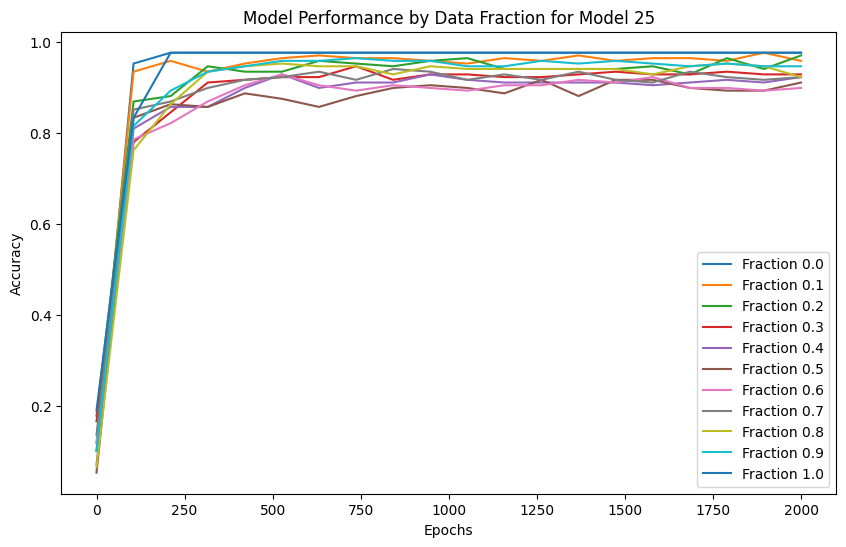

Model 26, Fraction 0.00, Epoch 1, Loss: 2.1939
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.2919
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.5757
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.2765
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.1728
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.1285
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.1059
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.0928
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.0846
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.0752
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.0724
predi

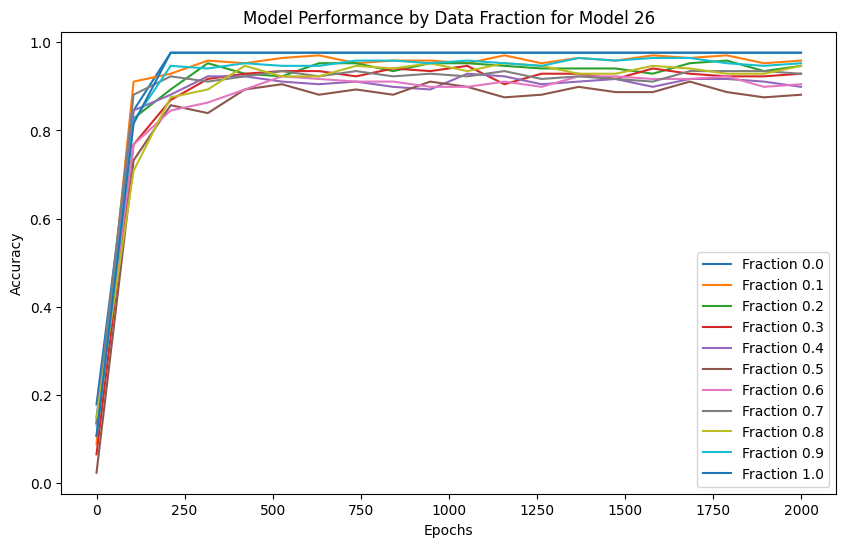

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2092
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.3037
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.6363
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.3122
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.1885
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.1345
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.1076
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.0928
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.0838
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.0780
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

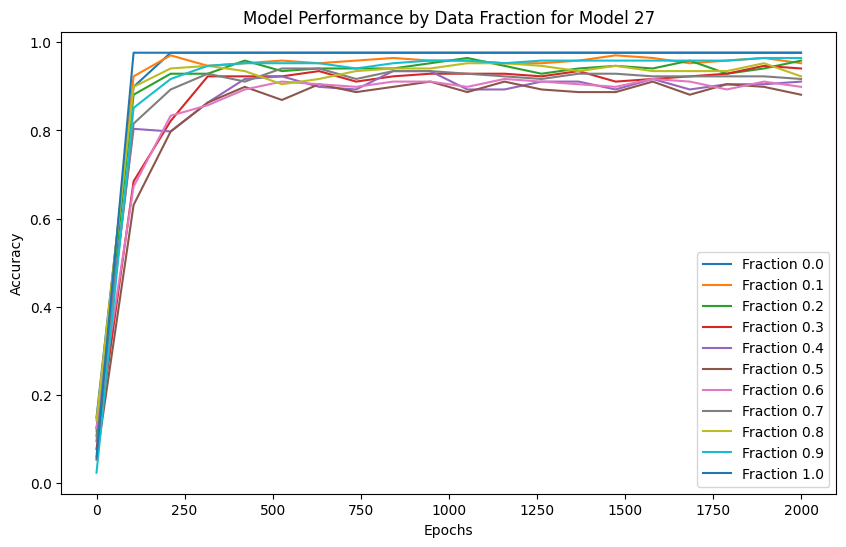

Model 28, Fraction 0.00, Epoch 1, Loss: 2.1804
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.1646
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.5157
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.2668
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.1714
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.1284
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.1059
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.0928
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.0845
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.0789
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.0750
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.0721
predi

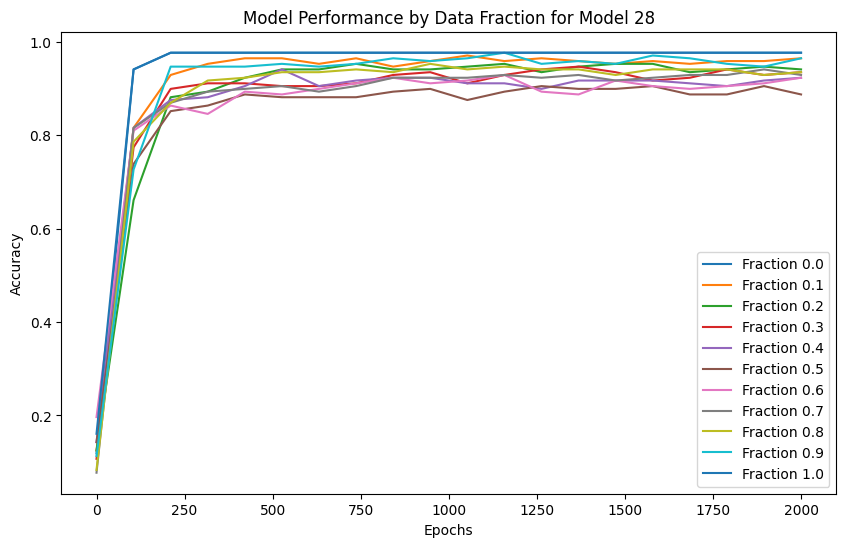

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2066
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.3575
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.6545
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.3075
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.1819
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.1309
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.1062
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.0924
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.0839
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.0717
predi

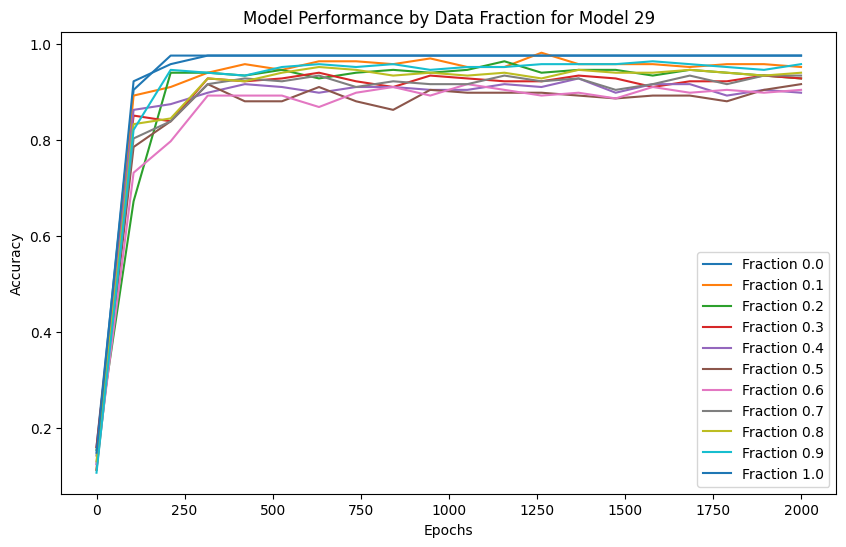

In [7]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    #"AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF", #normal
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"  #igh contradiction  #overlap 54  contradiction 24
])

for model_idx in range(num_models):
    model_dir = f"Songs_GHI_contradiction/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [8]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_GHI_contradiction"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.6905
  Fraction 0.10, Average Accuracy: 0.8095
  Fraction 0.20, Average Accuracy: 0.8095
  Fraction 0.30, Average Accuracy: 0.8095
  Fraction 0.40, Average Accuracy: 0.8127
  Fraction 0.50, Average Accuracy: 0.8929
  Fraction 0.60, Average Accuracy: 0.9659
  Fraction 0.70, Average Accuracy: 0.9754
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9762
  Fraction 0.30, Average Accuracy: 0.9762
  Fraction 0.40, Average Accuracy: 0.9730
  Fraction 0.50, Average Accuracy: 0.8929
  Fraction 0.60, Average Accuracy: 0.8198
  Fraction 0.70, Average Accuracy: 0.8103
  Fraction 0.80, Average Accuracy: 0.8095
  Fraction 0.90, Average Accuracy: 0.8095
  Fraction 1.00, Average Accuracy: 0.6897


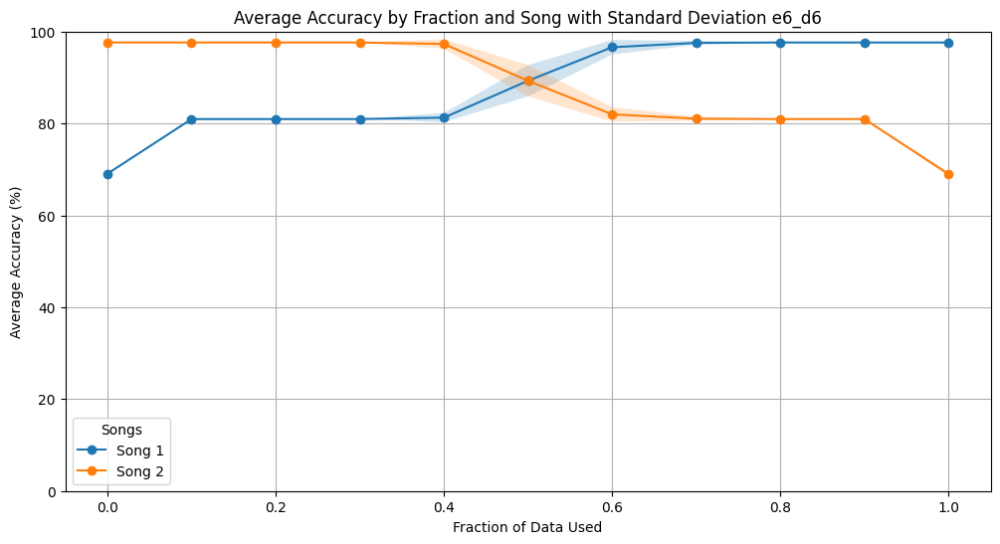

In [17]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


## Training and Testing for Songs GHI contradiction with lower parameter

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2073
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.9102
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.4180
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.0749
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.8197
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.6055
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4214
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.2938
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.2116
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.1642
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.1364
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.1186
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.1065
prediction sha

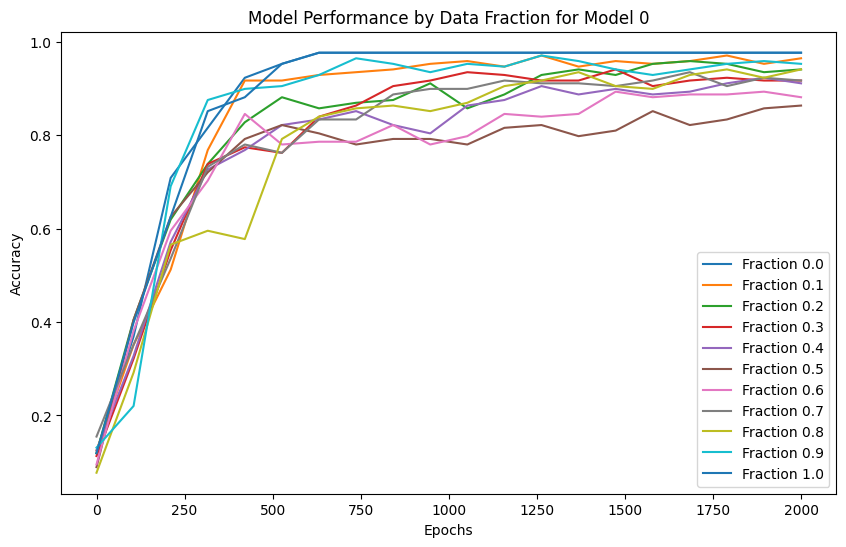

Model 1, Fraction 0.00, Epoch 1, Loss: 2.1938
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.8502
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.5281
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.1979
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.9279
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.6231
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4248
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.3124
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.2408
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.1929
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.1597
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.1363
prediction shape 

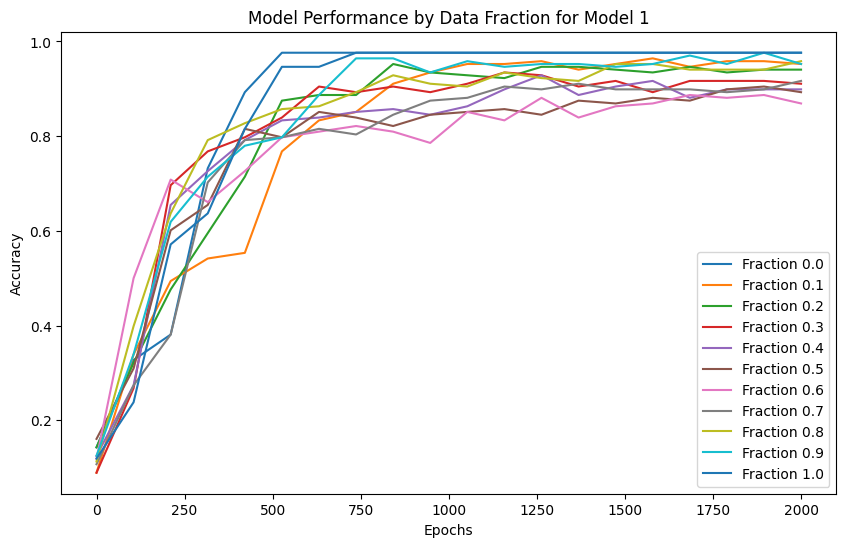

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.8843
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.4602
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.1362
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.8666
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.6545
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4495
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.2933
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.2159
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.1712
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.1439
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.1251
prediction shape 

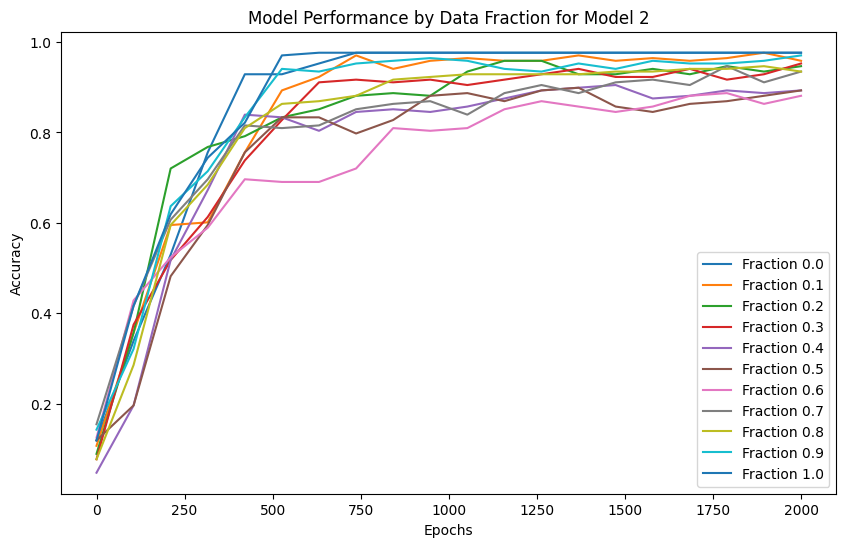

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2212
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.8959
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.4684
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.1700
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.9417
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.7782
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.6212
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.4029
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.2468
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.1829
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.1486
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.1275
prediction shape 

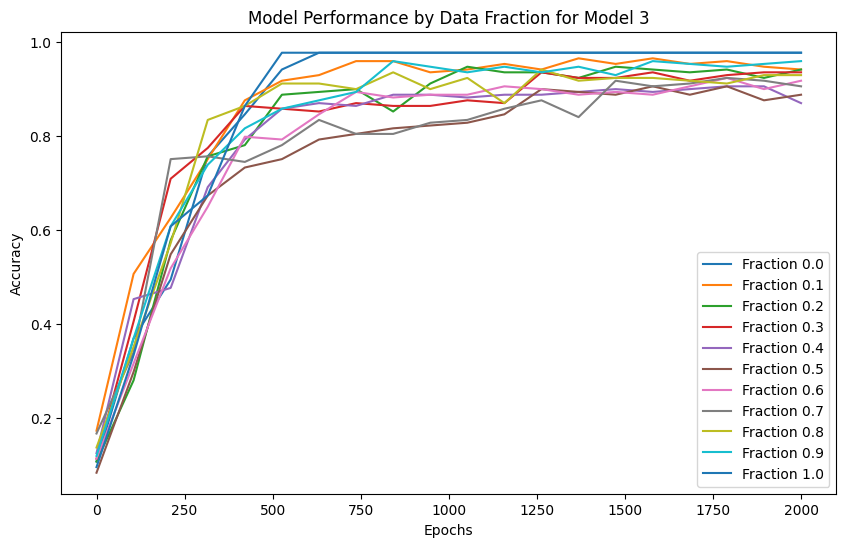

Model 4, Fraction 0.00, Epoch 1, Loss: 2.1988
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.8893
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.3736
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.0954
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.8227
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.5668
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.3935
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.2724
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.2081
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.1693
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.1437
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.1257
prediction shape 

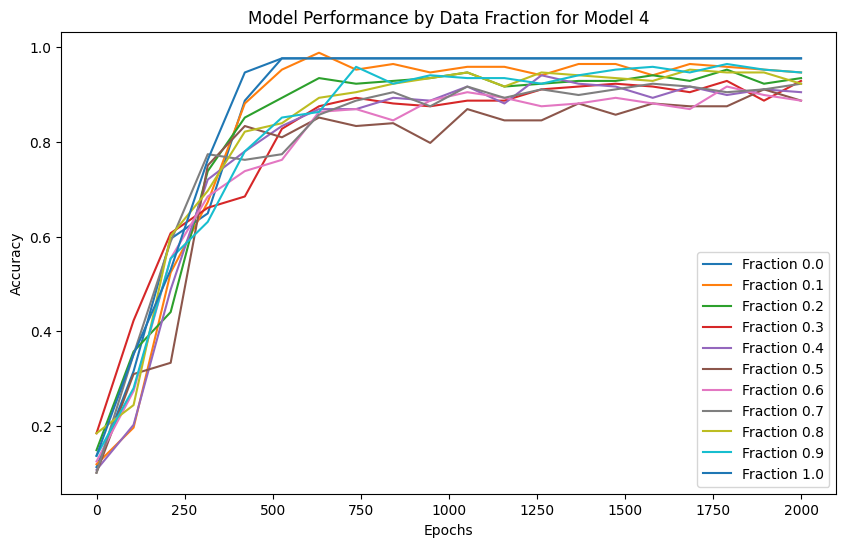

Model 5, Fraction 0.00, Epoch 1, Loss: 2.1987
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.8926
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.4128
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 1.1612
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.9770
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.7781
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.5697
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.4153
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.3242
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.2676
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.2281
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.1980
prediction shape 

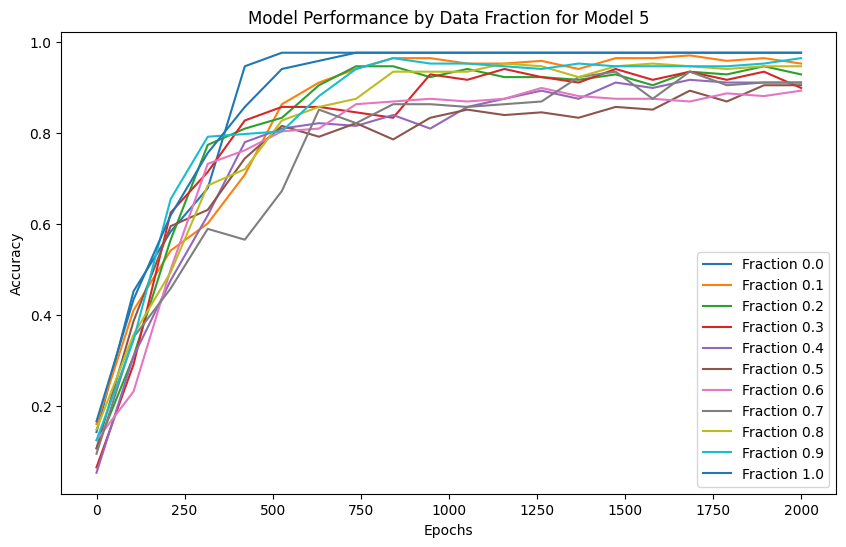

Model 6, Fraction 0.00, Epoch 1, Loss: 2.1995
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.8526
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.3422
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.9835
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.7248
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.5812
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4755
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.3647
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.2737
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.2131
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.1724
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.1462
prediction shape 

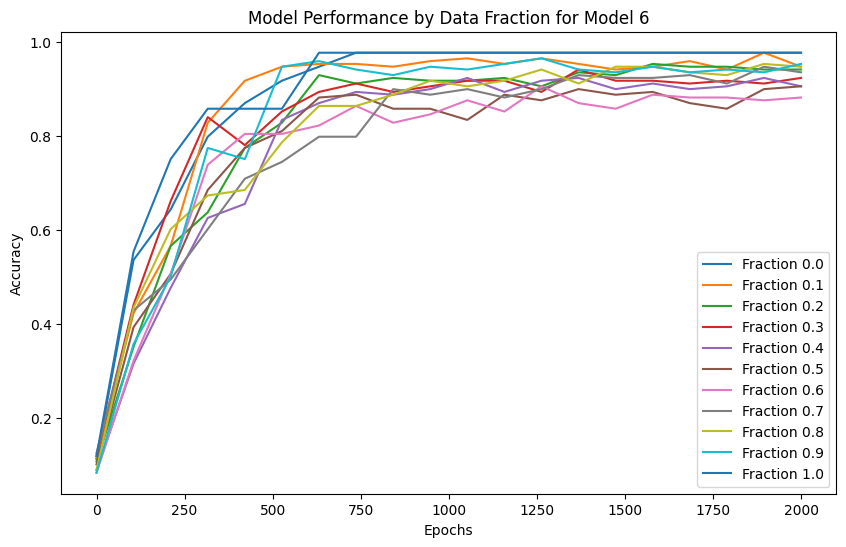

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2048
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.8853
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.3327
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 1.0241
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.8146
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.6149
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4578
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.3648
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.2961
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.2215
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.1615
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.1318
prediction shape 

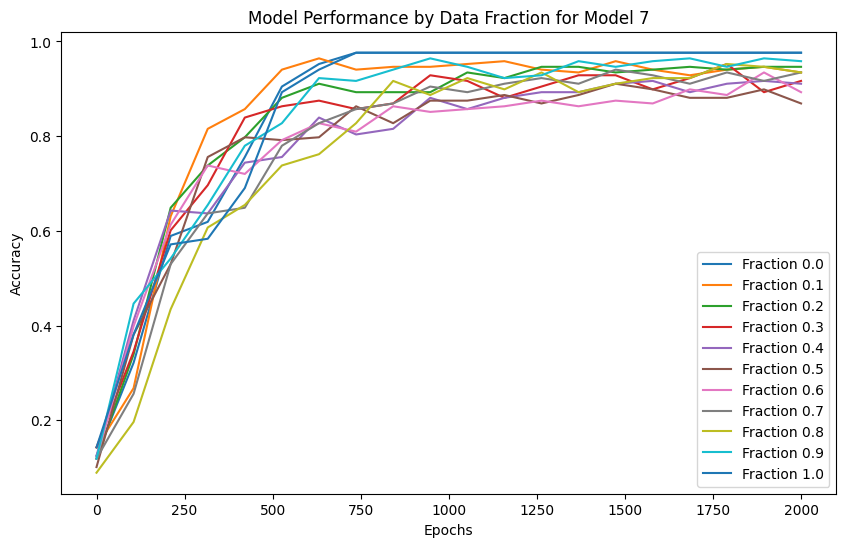

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2151
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.9207
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.3742
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.0418
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.7071
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.4887
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.3708
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.2940
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.2234
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.1749
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.1465
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.1275
prediction shape 

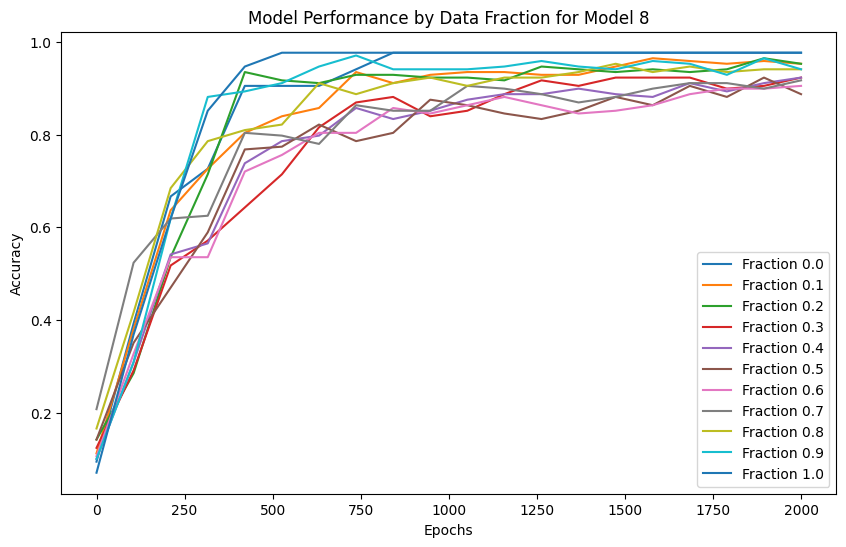

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2014
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.8676
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.4957
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.1451
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.7926
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.5397
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.3591
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.2554
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.1953
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.1580
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.1346
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.1186
prediction shape 

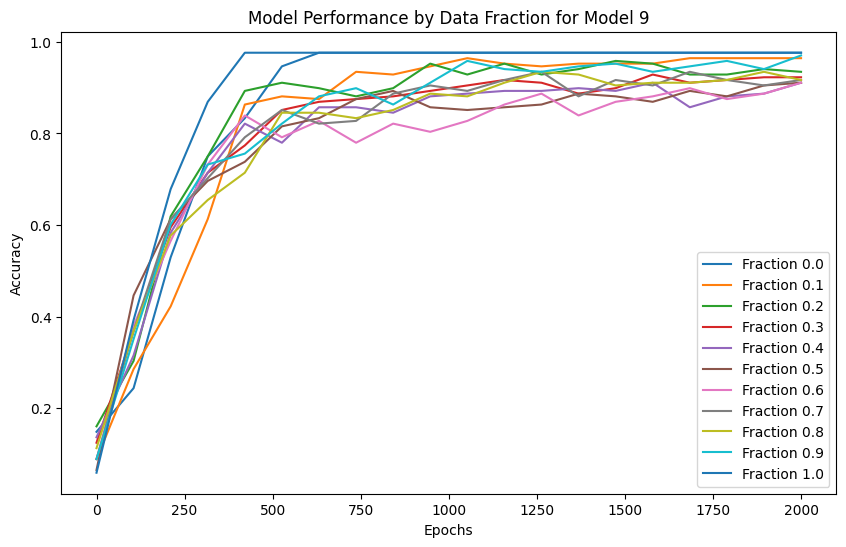

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2057
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.8949
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.4162
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 1.0269
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.6658
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.4415
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.3198
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.2455
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.1973
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.1648
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.1420
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.1255
predi

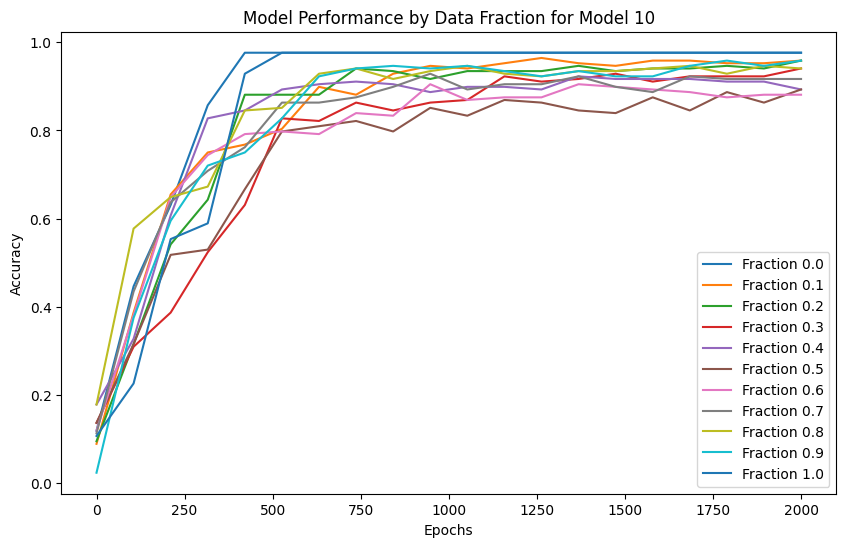

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2052
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.9371
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.4212
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 1.0412
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.7362
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.4943
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.3384
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.2498
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.1957
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.1604
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.1361
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.1189
predi

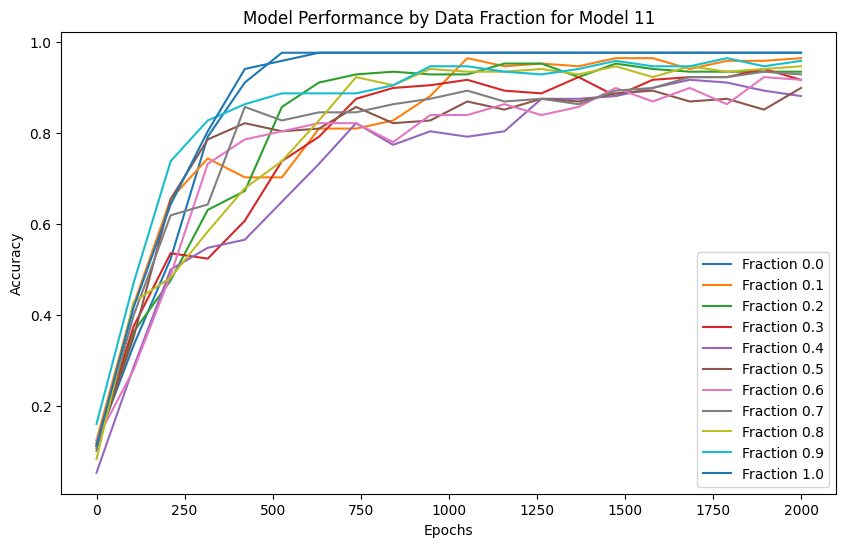

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2017
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.9018
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.3640
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.9855
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.7205
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.5645
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.2940
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.2238
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.1789
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.1487
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.1279
predi

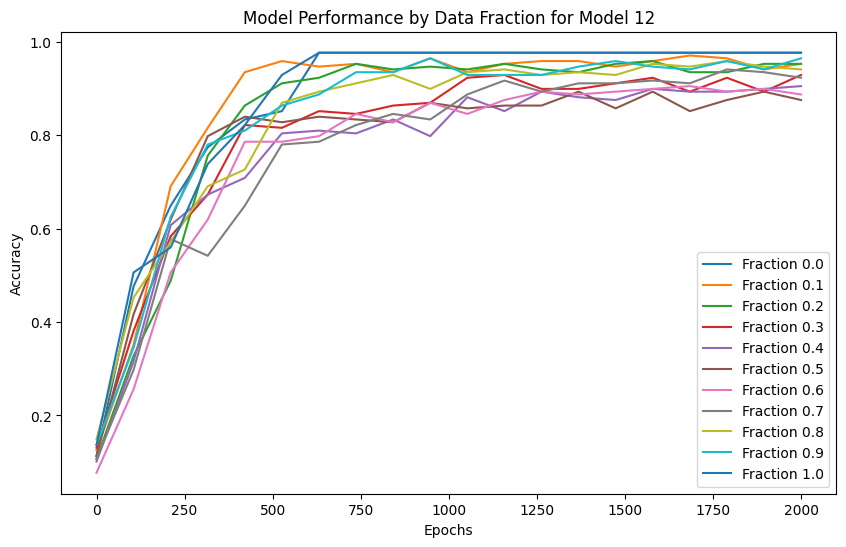

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2056
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.8684
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.3825
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 1.0821
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.9096
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.7769
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.5966
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.4015
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.2827
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.2092
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.1587
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.1308
predi

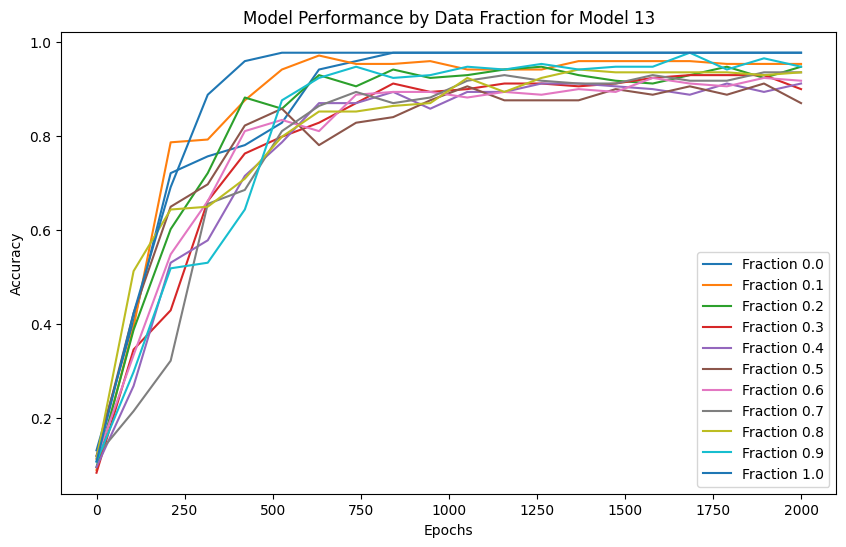

Model 14, Fraction 0.00, Epoch 1, Loss: 2.1948
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.8439
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.3639
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 1.0684
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.7757
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.5150
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.3613
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.2689
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.2098
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.1711
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.1453
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.1273
predi

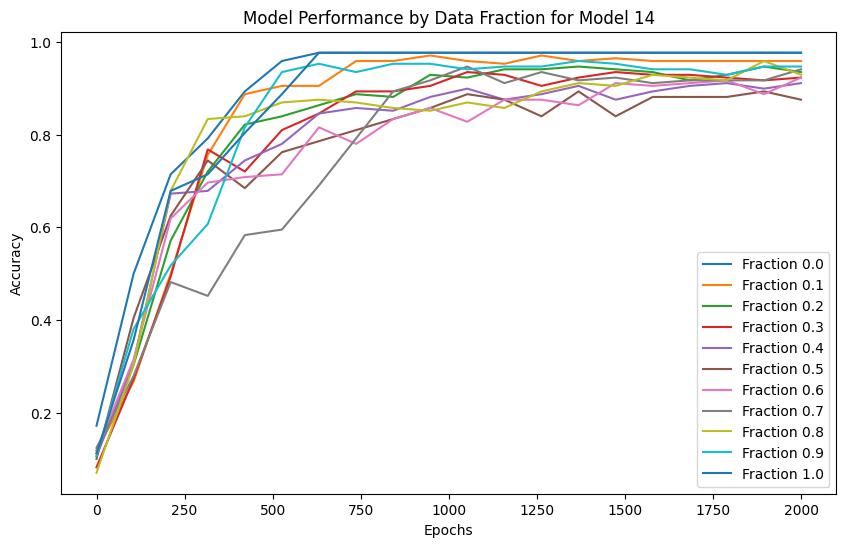

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2037
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.8953
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.3888
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 1.1128
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.8725
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.6463
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4661
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.3330
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.2446
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.1899
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.1564
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.1341
predi

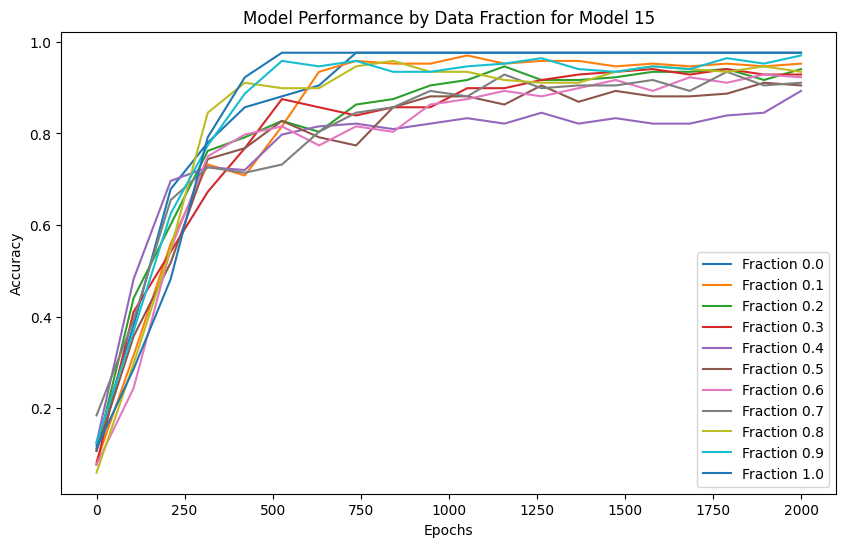

Model 16, Fraction 0.00, Epoch 1, Loss: 2.1974
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.8054
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.3825
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 1.1095
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.8432
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.5905
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.3896
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.2732
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.2071
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.1674
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.1415
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.1237
predi

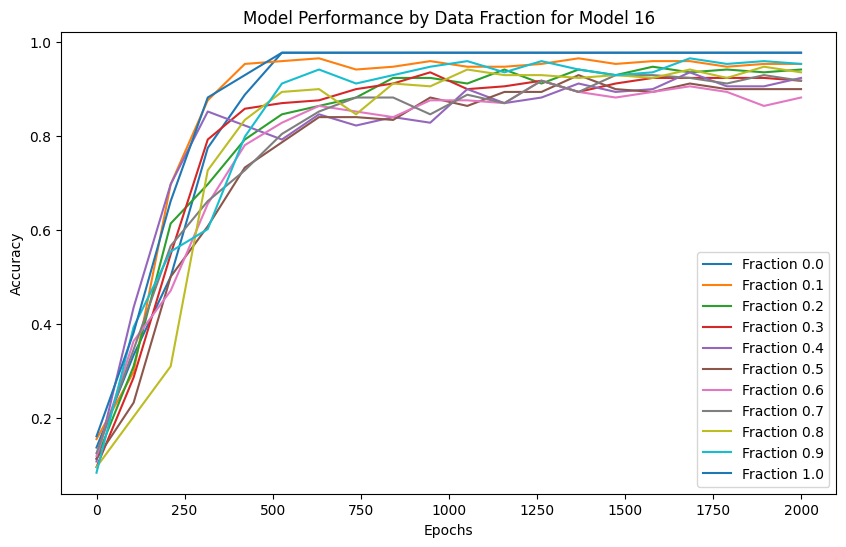

Model 17, Fraction 0.00, Epoch 1, Loss: 2.1941
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.8898
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.3781
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 1.1009
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.8931
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.6887
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.4986
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.3323
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.2486
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.1952
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.1602
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.1367
predi

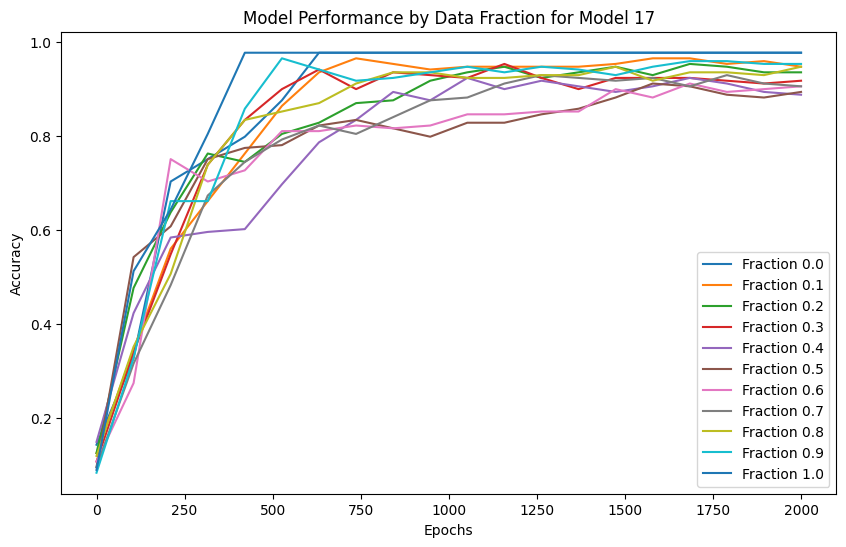

Model 18, Fraction 0.00, Epoch 1, Loss: 2.1991
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.9425
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.5243
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 1.2020
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.8673
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.5798
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.3818
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.2770
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.2142
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.1730
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.1452
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.1261
predi

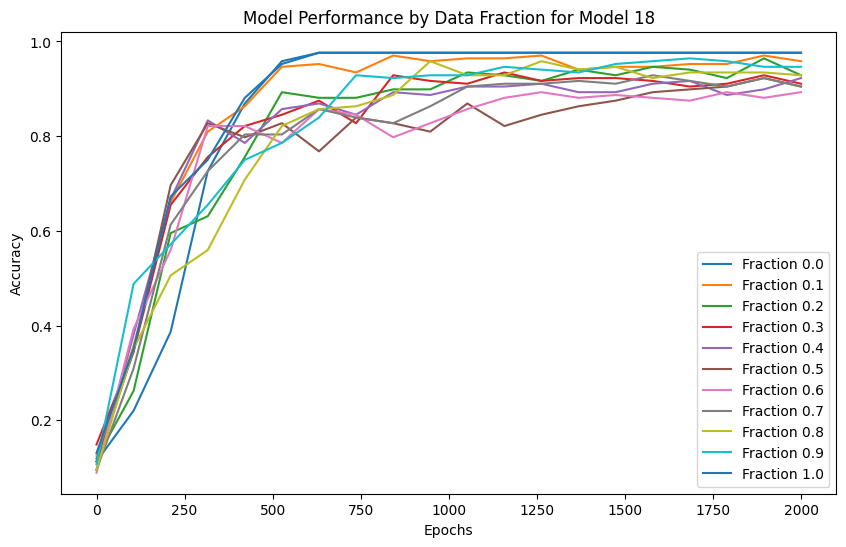

Model 19, Fraction 0.00, Epoch 1, Loss: 2.1993
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.9188
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.2906
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.8888
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.6563
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.5145
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.3797
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.2727
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.2094
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.1694
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.1426
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.1240
predi

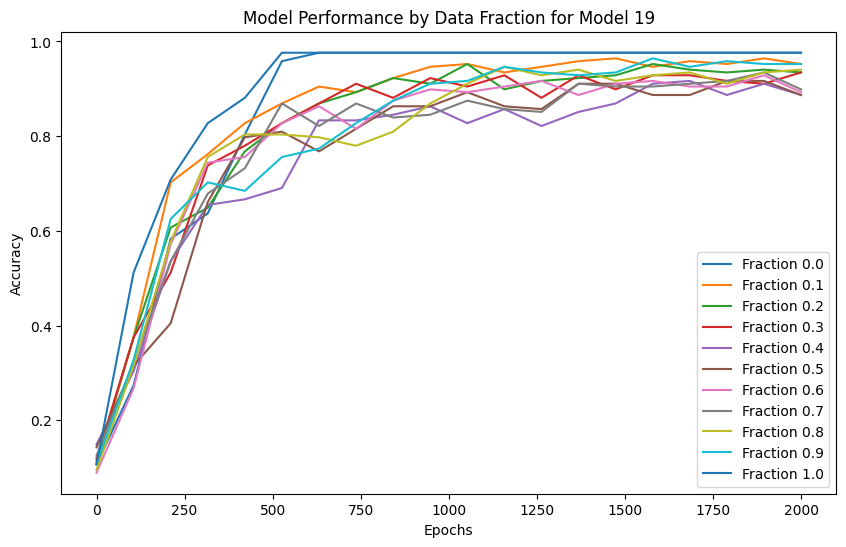

Model 20, Fraction 0.00, Epoch 1, Loss: 2.2137
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.9805
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.4692
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 1.0990
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.7794
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5491
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4208
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.3410
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.2850
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.2410
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.2049
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.1751
predi

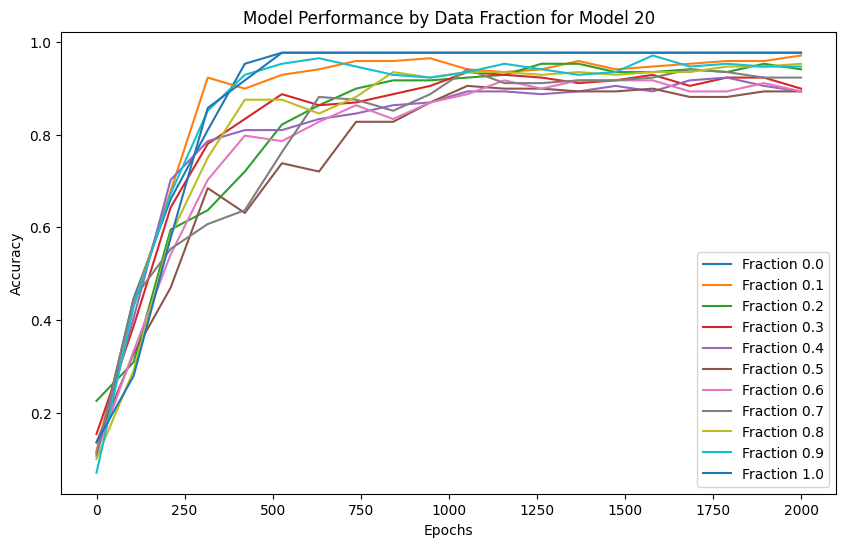

Model 21, Fraction 0.00, Epoch 1, Loss: 2.1956
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.8378
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.3189
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.9806
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.6960
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.4926
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.3596
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.2760
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.2203
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.1817
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.1540
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.1339
predi

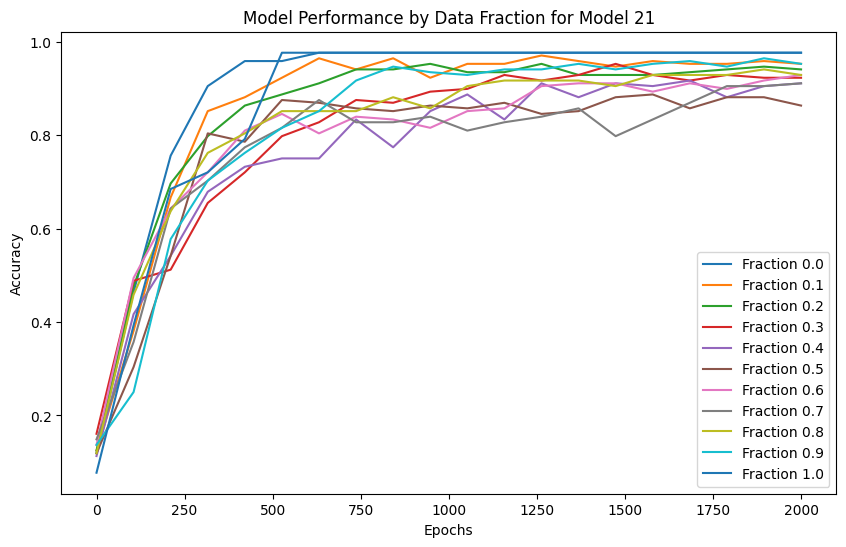

Model 22, Fraction 0.00, Epoch 1, Loss: 2.1997
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.8390
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.3560
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 1.0368
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.7561
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.5414
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.3884
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.2921
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.2293
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.1876
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.1583
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.1370
predi

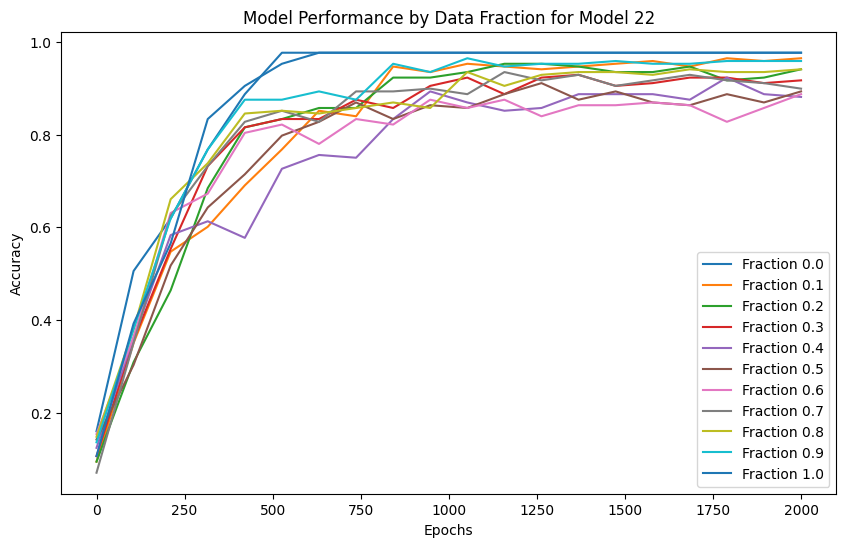

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2040
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.9441
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.4761
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 1.1069
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.7808
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.5322
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.3654
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.2656
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.2057
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.1673
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.1417
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.1239
predi

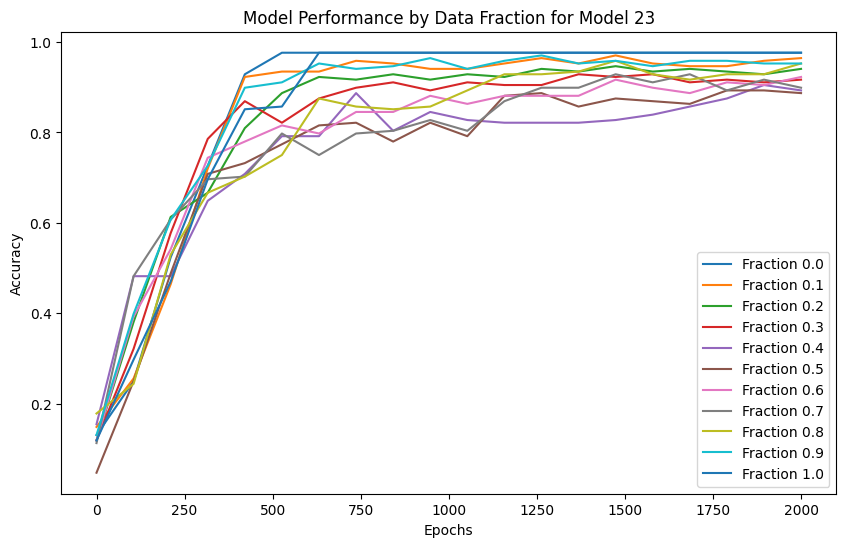

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2064
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.8883
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.4074
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 1.0425
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.7285
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.5463
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4353
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.3146
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.2227
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.1745
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.1460
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.1271
predi

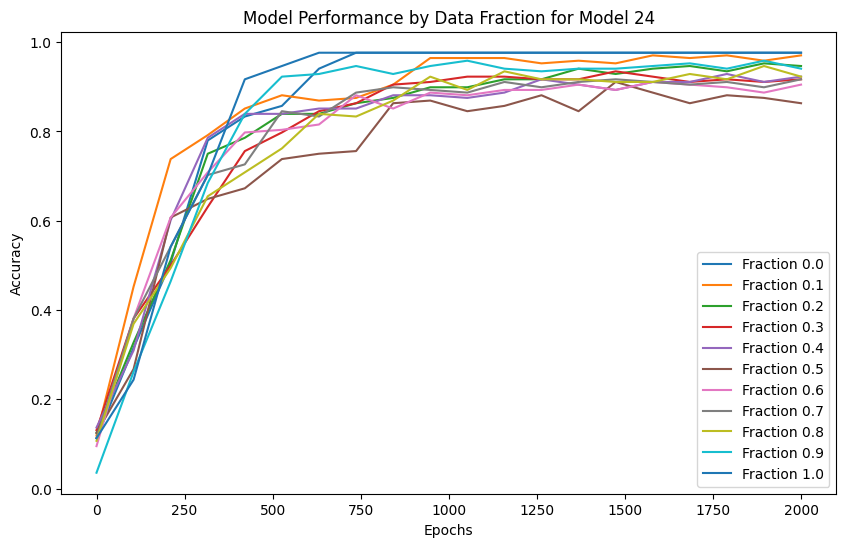

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2028
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.8836
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.3996
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 1.0964
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.8686
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.6128
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.4066
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.2708
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.1984
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.1577
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.1328
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.1165
predi

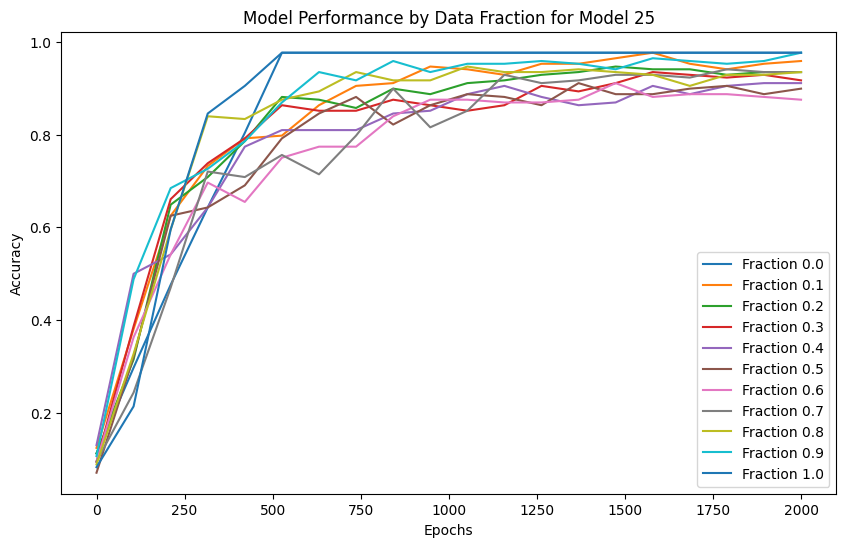

Model 26, Fraction 0.00, Epoch 1, Loss: 2.1997
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.9121
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.3453
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.9576
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.6782
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.4827
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.3547
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.2678
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.2092
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.1698
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.1430
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.1245
predi

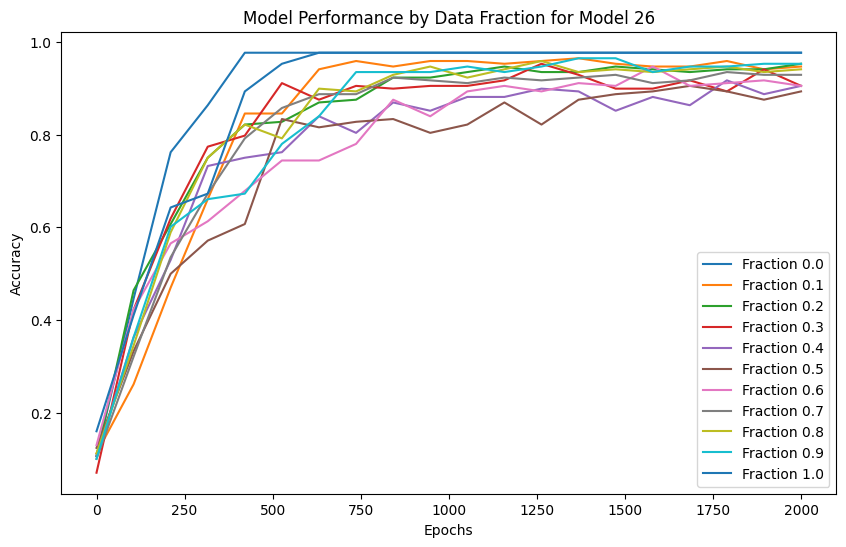

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2005
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.8994
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.3860
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 1.0917
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.8131
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.5775
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4166
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.3064
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.2299
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.1822
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.1518
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.1313
predi

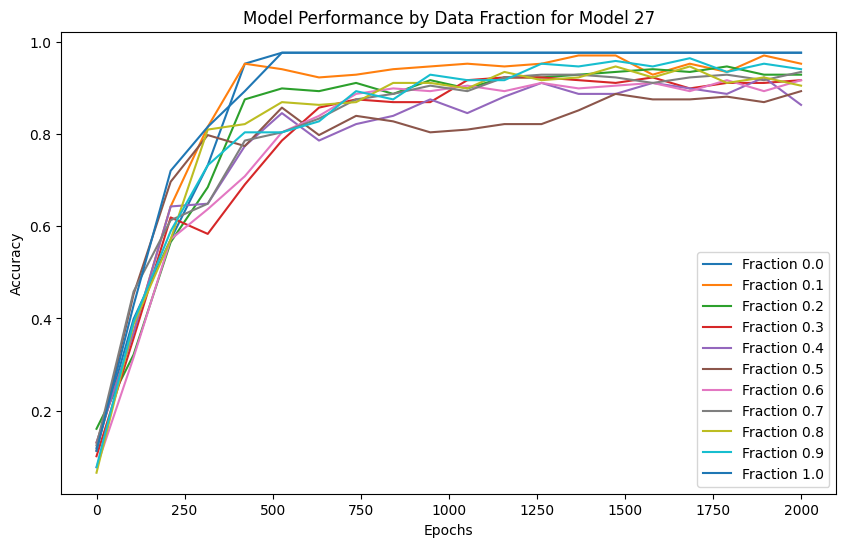

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2035
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.8650
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.4158
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 1.1025
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.8788
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.6702
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.4973
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.3573
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.2596
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.1998
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.1622
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.1370
predi

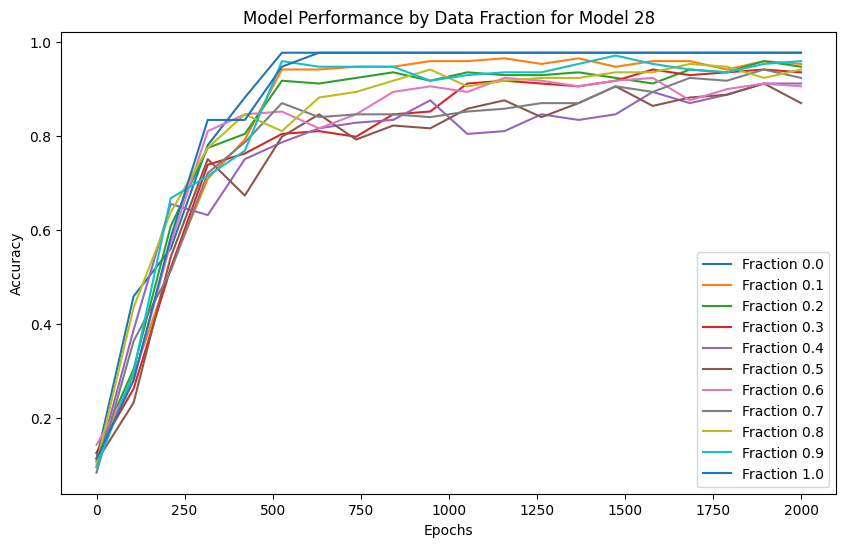

Model 29, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.8763
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.2973
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.8929
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.6688
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.4964
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.3666
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.2765
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.2135
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.1728
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.1457
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.1266
predi

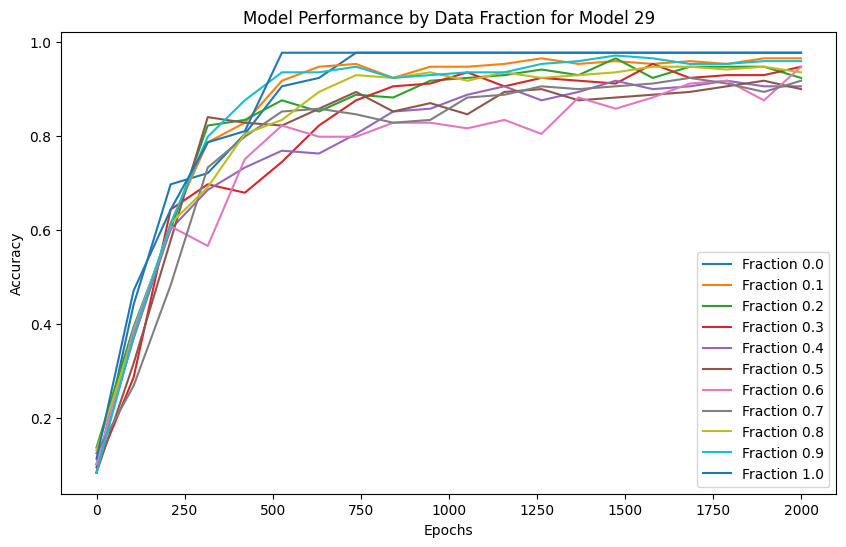

In [23]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    #"AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_GHI_contradiction_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [24]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_GHI_contradiction_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.6706
  Fraction 0.10, Average Accuracy: 0.7635
  Fraction 0.20, Average Accuracy: 0.7810
  Fraction 0.30, Average Accuracy: 0.7889
  Fraction 0.40, Average Accuracy: 0.7984
  Fraction 0.50, Average Accuracy: 0.8794
  Fraction 0.60, Average Accuracy: 0.9540
  Fraction 0.70, Average Accuracy: 0.9738
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9762
  Fraction 0.30, Average Accuracy: 0.9762
  Fraction 0.40, Average Accuracy: 0.9683
  Fraction 0.50, Average Accuracy: 0.8960
  Fraction 0.60, Average Accuracy: 0.8175
  Fraction 0.70, Average Accuracy: 0.7952
  Fraction 0.80, Average Accuracy: 0.7944
  Fraction 0.90, Average Accuracy: 0.7802
  Fraction 1.00, Average Accuracy: 0.6706


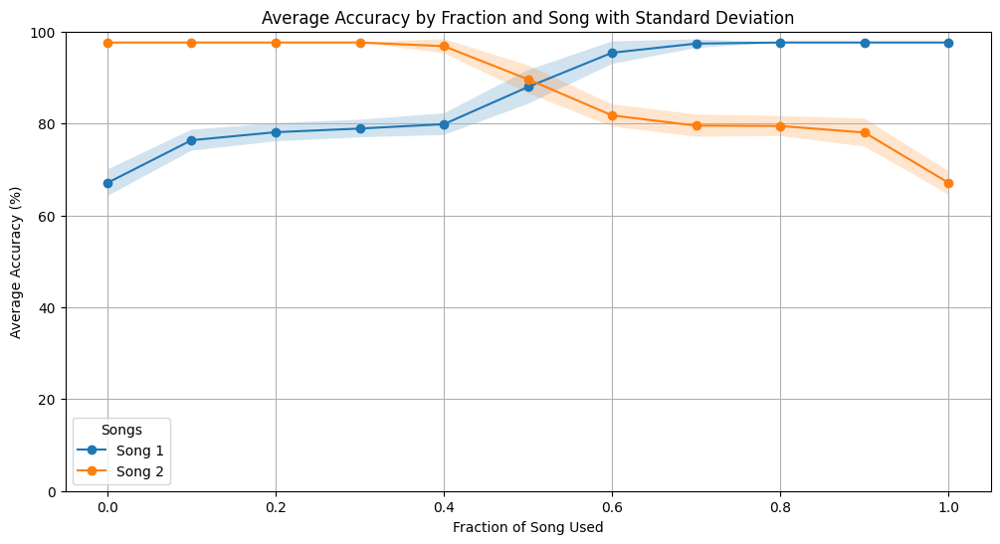

In [25]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


## Training and Testing for Different songs

Model 0, Fraction 0.00, Epoch 1, Loss: 2.1844
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.2284
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.5692
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.2879
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.1797
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.1320
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.1075
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.0935
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.0847
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.0790
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.0749
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.0720
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.0699
prediction sha

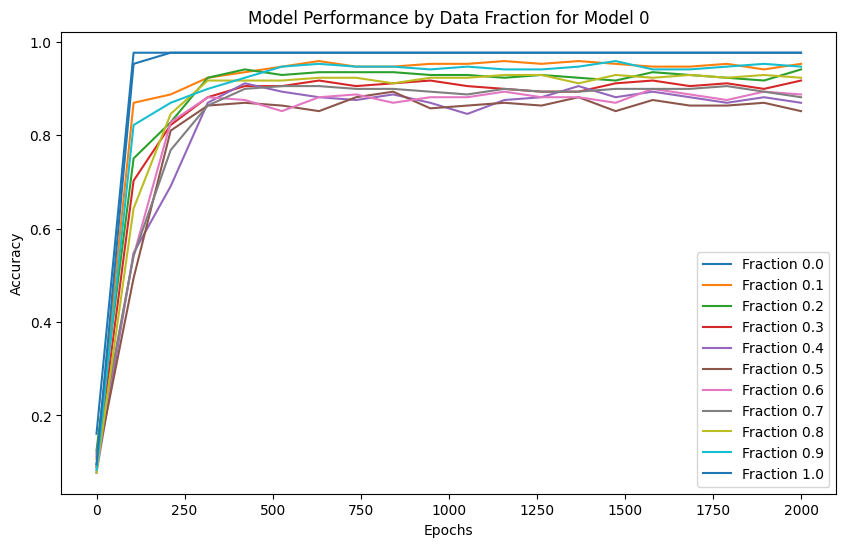

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2184
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.3392
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.6268
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.2958
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.1784
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.1302
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.1064
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.0929
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.0845
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.0789
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.0750
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

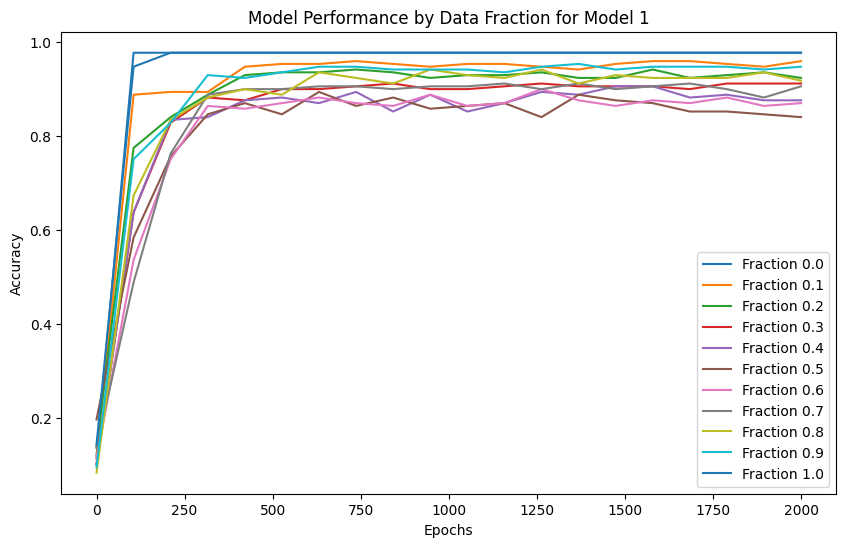

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2088
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.3385
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.5728
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.2745
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.1710
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.1273
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.1051
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.0923
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.0842
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.0750
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

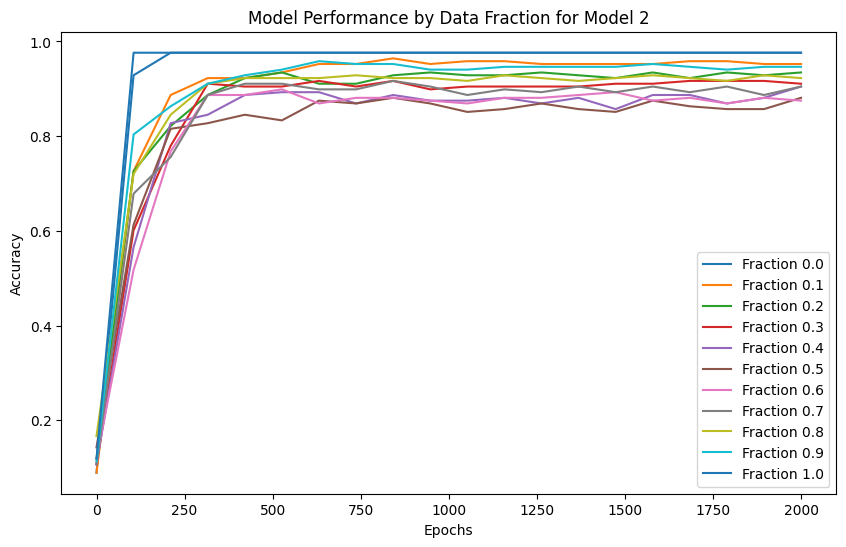

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2086
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.3118
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.6112
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.2928
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.1795
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.1318
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.1077
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.0939
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.0853
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.0796
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.0755
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.0726
prediction shape 

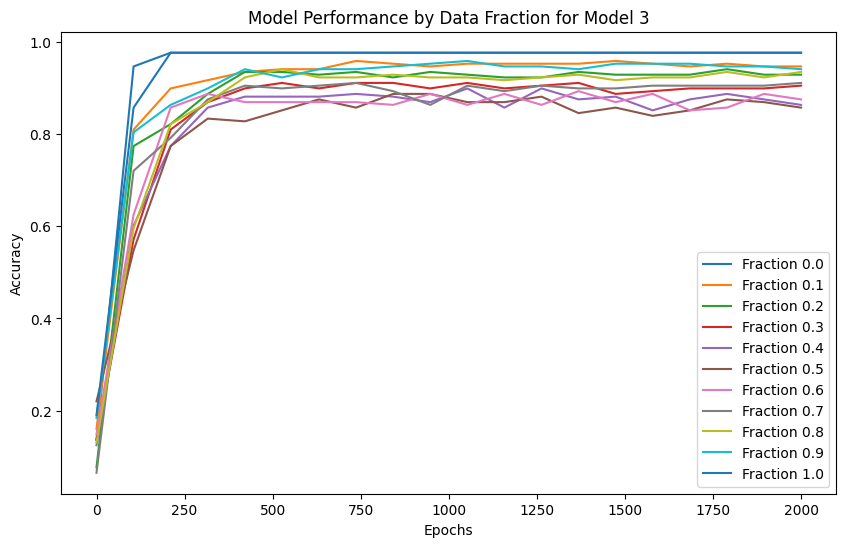

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2258
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.3577
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.6312
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.2979
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.1811
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.1321
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.1075
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.0936
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.0792
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

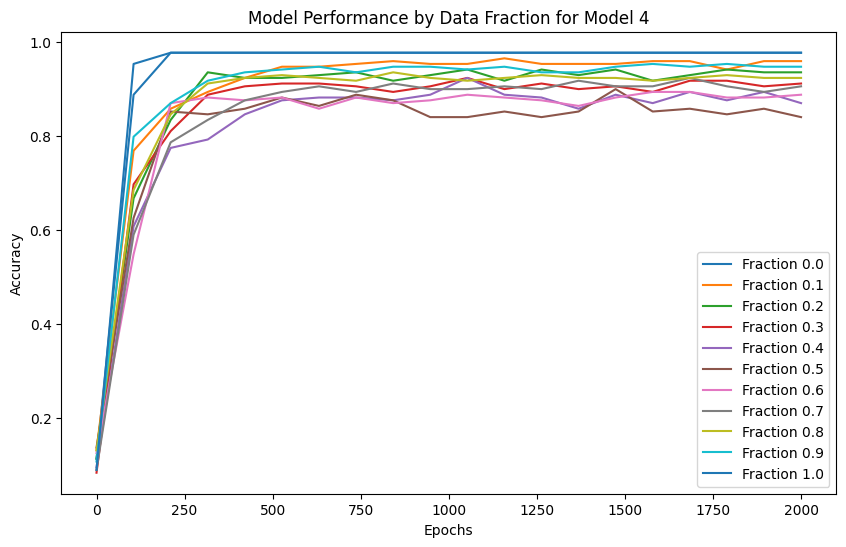

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2139
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.2934
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.6361
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.3117
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.1853
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.1336
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.1082
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.0939
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.0851
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.0752
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.0723
prediction shape 

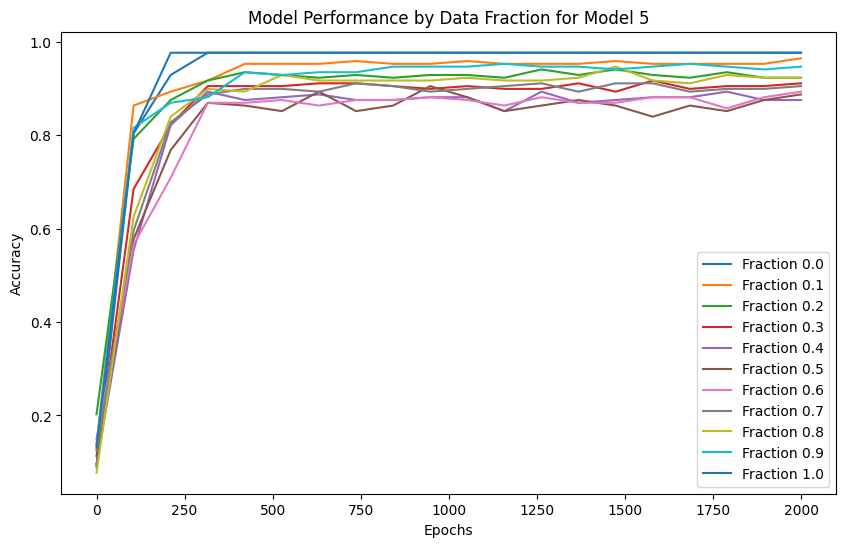

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2053
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.3502
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.6019
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.2863
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.1772
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.1308
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.1071
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.0935
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.0721
prediction shape 

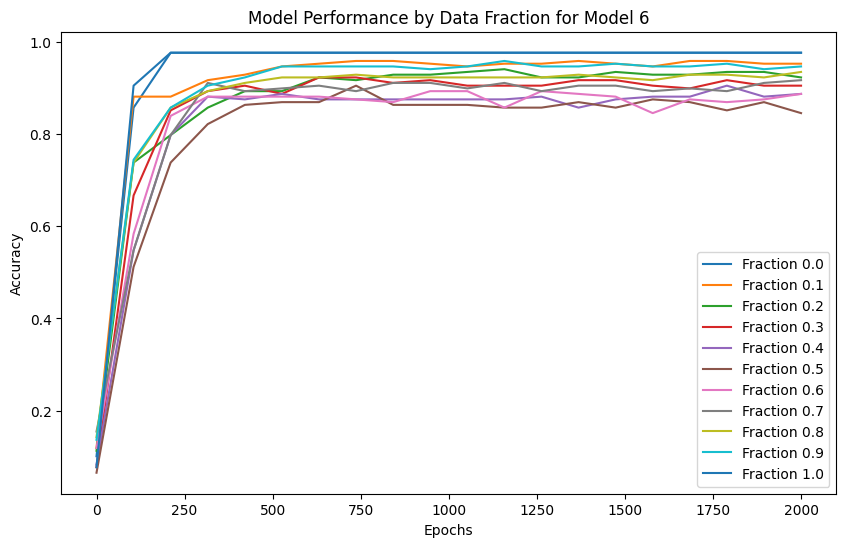

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2202
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.3819
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.6225
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.2924
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.1758
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.1283
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.1049
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.0918
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.0836
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.0782
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.0716
prediction shape 

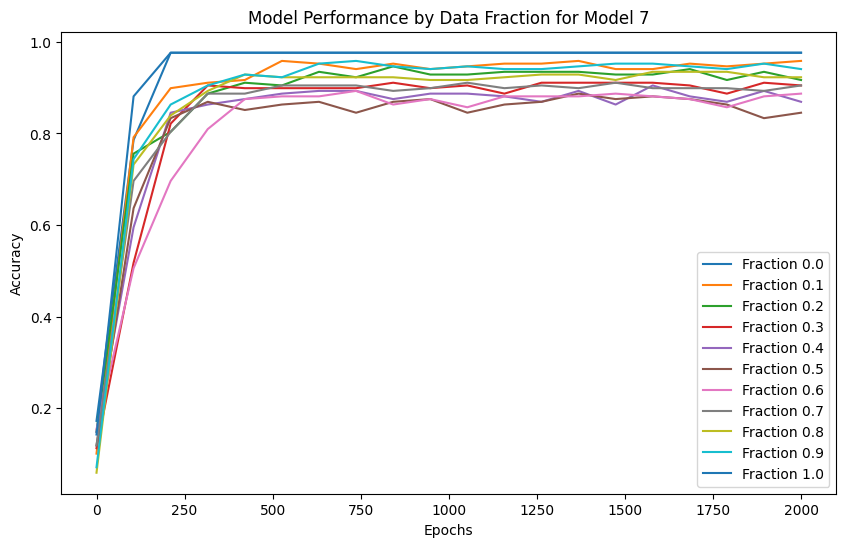

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2080
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.2874
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.5852
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.2906
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.1779
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.1292
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.1049
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.0913
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.0830
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.0776
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.0711
prediction shape 

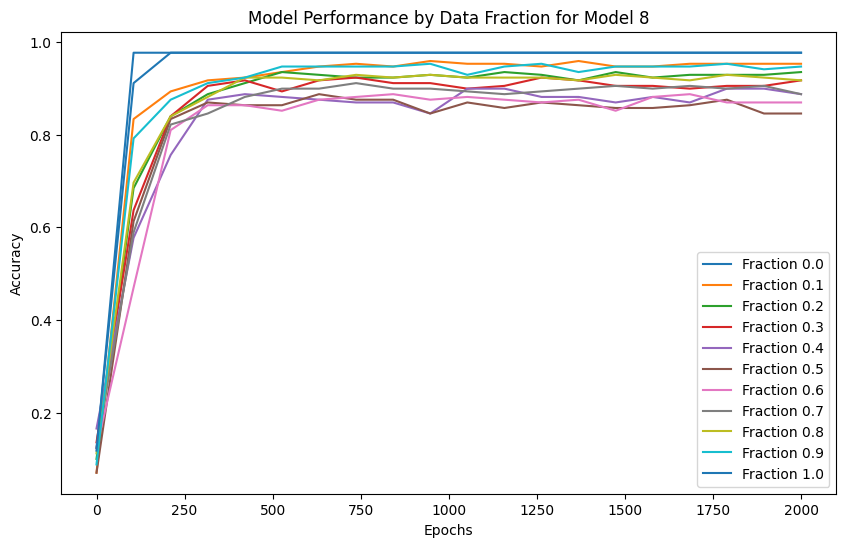

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2276
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.3336
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.6288
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.3115
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.1903
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.1376
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.1109
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.0958
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.0864
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.0802
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.0760
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.0728
prediction shape 

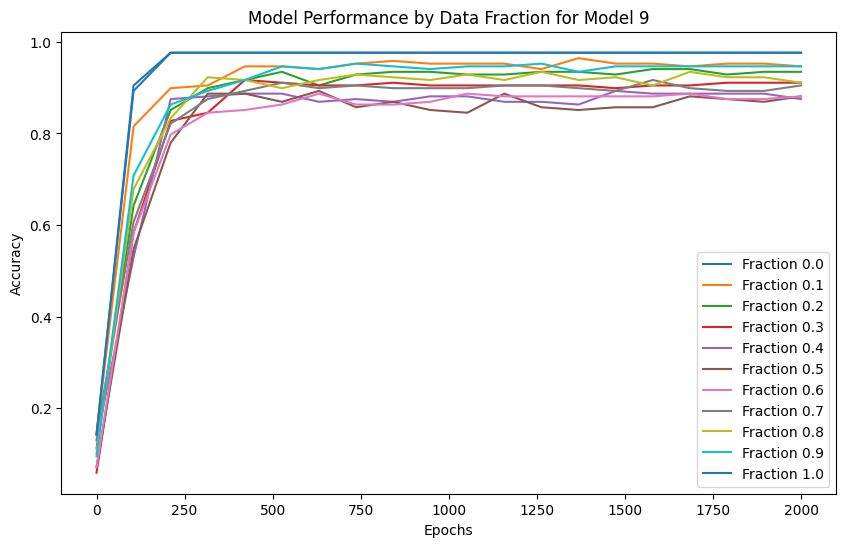

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2057
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.3281
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.6690
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.3298
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.1937
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.1370
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.1096
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.0944
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.0853
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.0722
predi

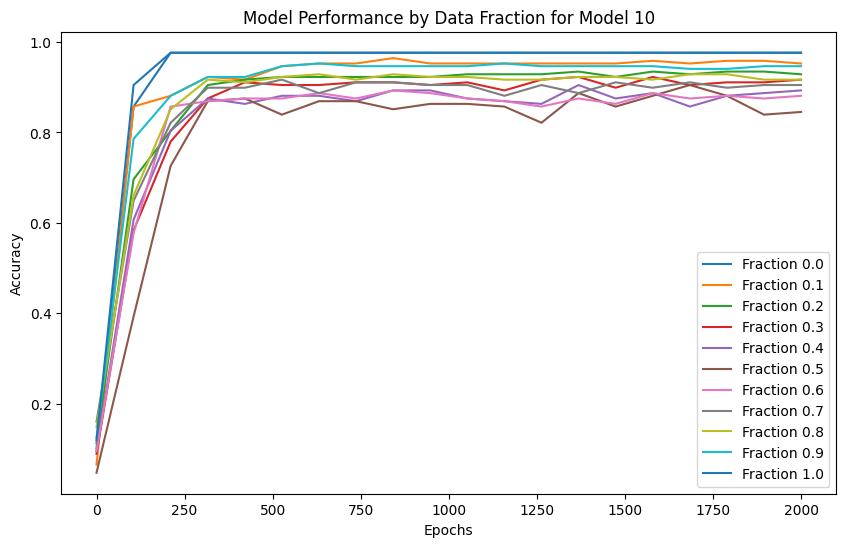

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2326
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.3467
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.6452
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.3076
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.1837
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.1324
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.1071
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.0929
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.0842
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.0785
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.0717
predi

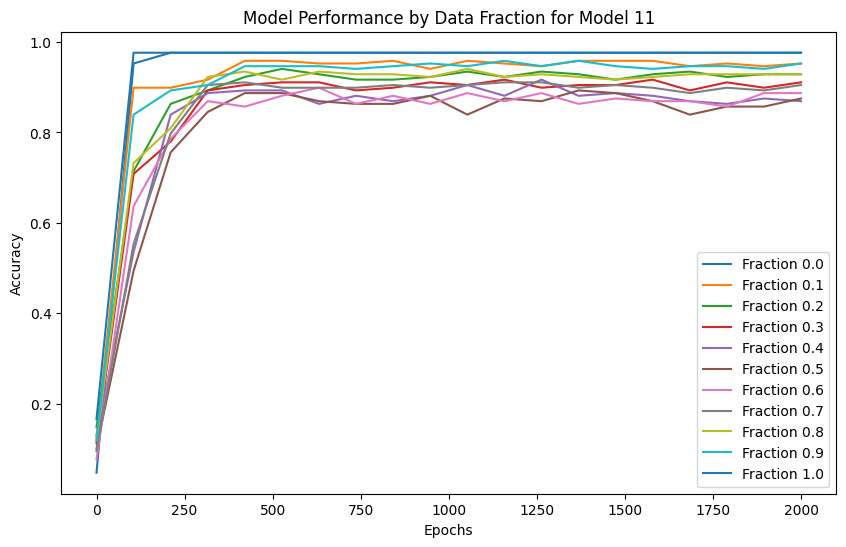

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2181
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.4442
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.6327
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.3130
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.1888
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.1355
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.1090
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.0941
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.0789
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.0748
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.0719
predi

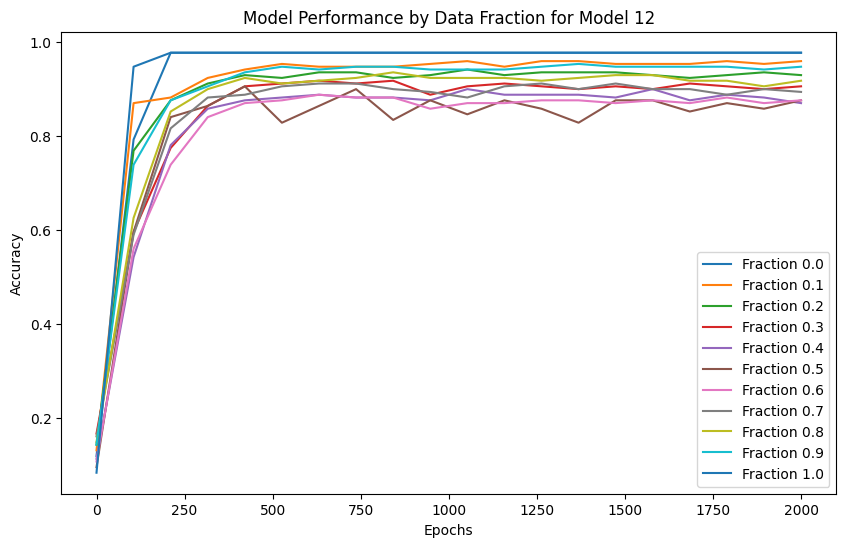

Model 13, Fraction 0.00, Epoch 1, Loss: 2.1909
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.3052
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.6206
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.3113
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.1901
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.1374
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.1109
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.0959
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.0866
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.0761
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.0730
predi

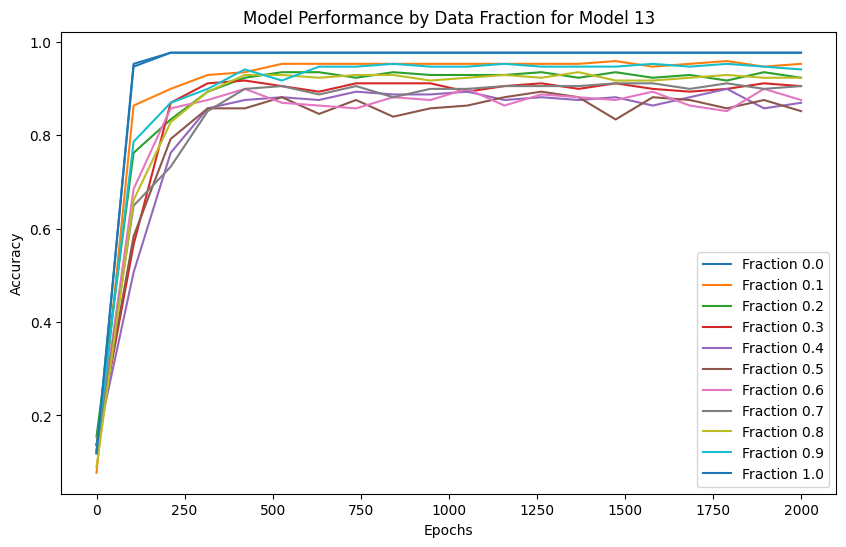

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2193
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.3068
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.6058
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.3031
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.1849
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.1340
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.1086
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.0942
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.0853
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.0794
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.0753
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.0723
predi

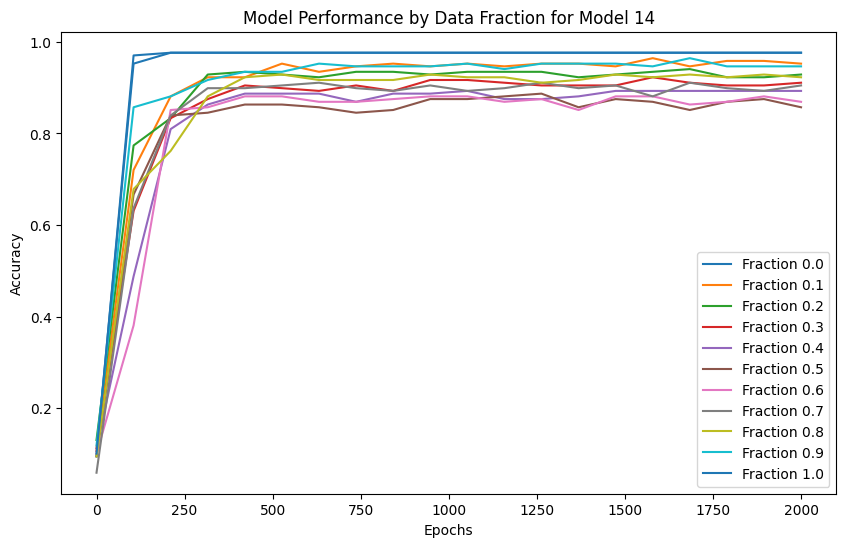

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2084
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.2706
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.6097
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.3051
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.1869
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.1352
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.1091
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.0944
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.0854
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.0794
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.0753
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.0723
predi

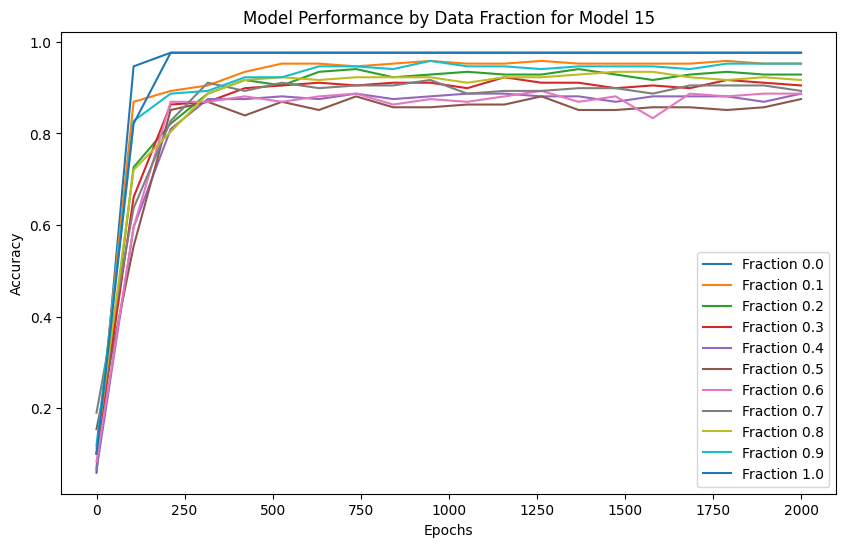

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2138
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.3460
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.6578
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.3273
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.1998
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.1440
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.1154
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.0990
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.0888
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.0820
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.0772
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.0738
predi

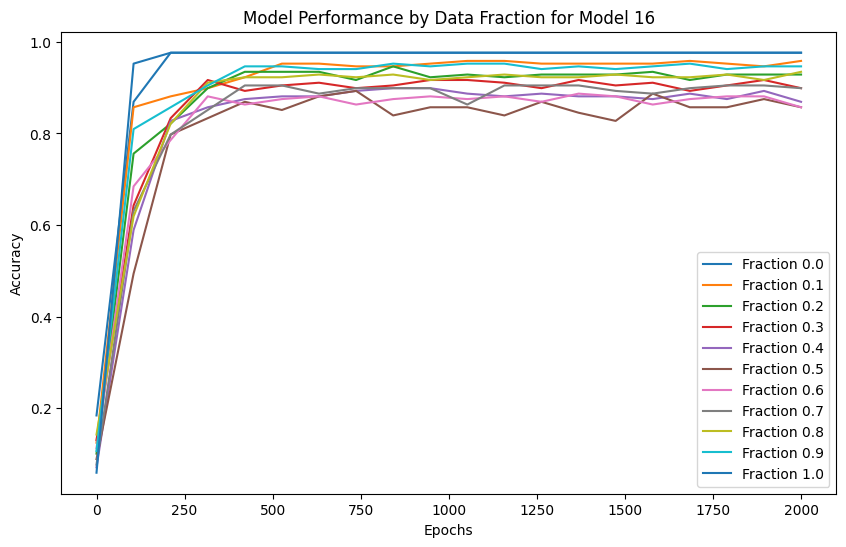

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2128
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.2869
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.5937
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.3002
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.1844
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.1333
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.1075
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.0930
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.0842
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.0715
predi

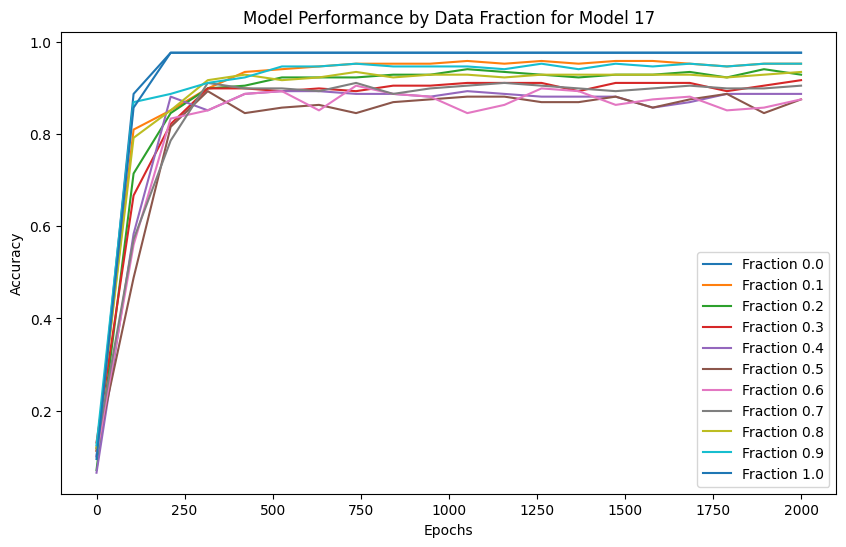

Model 18, Fraction 0.00, Epoch 1, Loss: 2.1959
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.3491
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.5884
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.2787
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.1711
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.1263
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.1038
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.0910
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.0831
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.0778
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.0714
predi

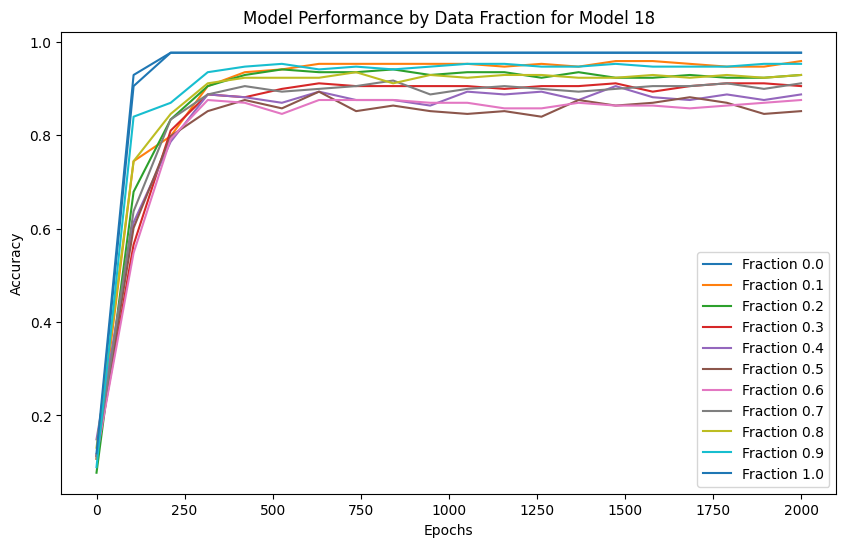

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2135
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.3321
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.6503
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.3146
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.1893
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.1367
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.1105
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.0957
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.0865
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.0762
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.0731
predi

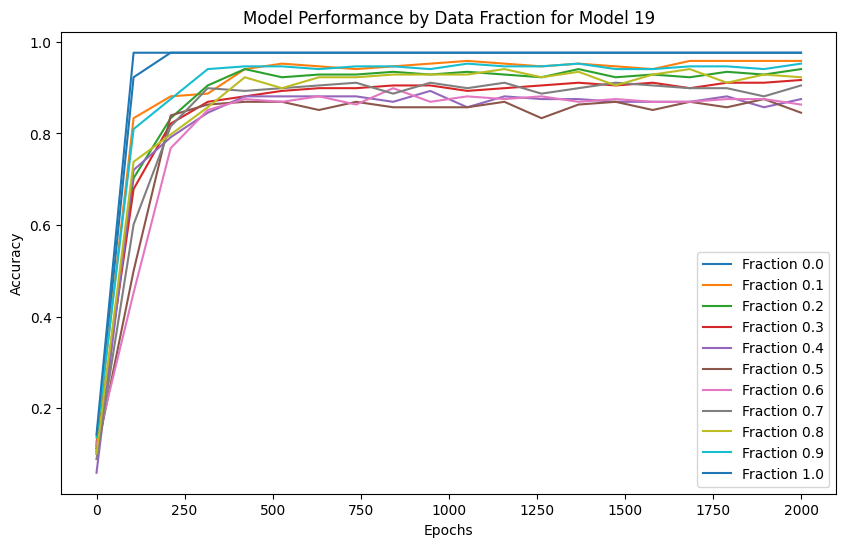

Model 20, Fraction 0.00, Epoch 1, Loss: 2.1943
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.2698
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.6377
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.3166
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.1892
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.1359
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.1097
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.0950
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.0859
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.0799
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.0757
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.0727
predi

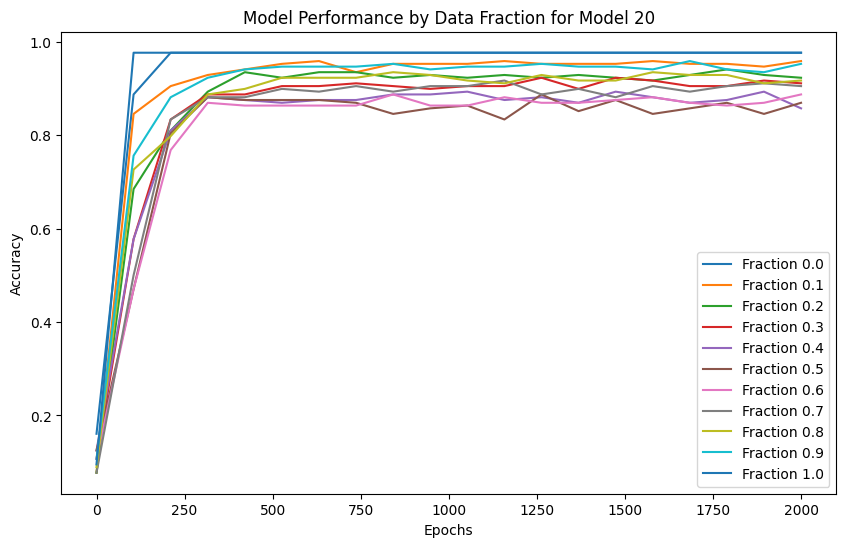

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2222
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.3348
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.5921
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.2847
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.1742
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.1275
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.1043
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.0912
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.0831
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.0778
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

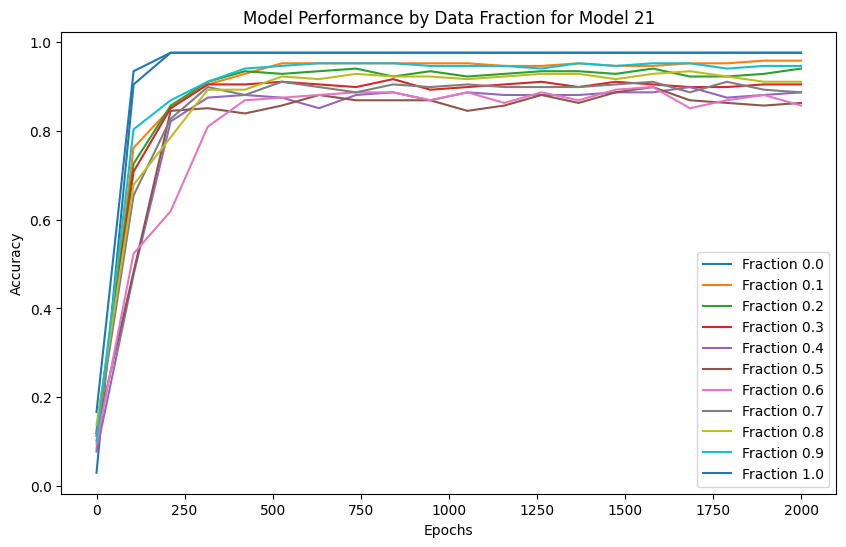

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2048
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.3152
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.5863
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.2929
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.1818
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.1332
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.1085
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.0943
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.0855
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.0797
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.0756
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.0726
predi

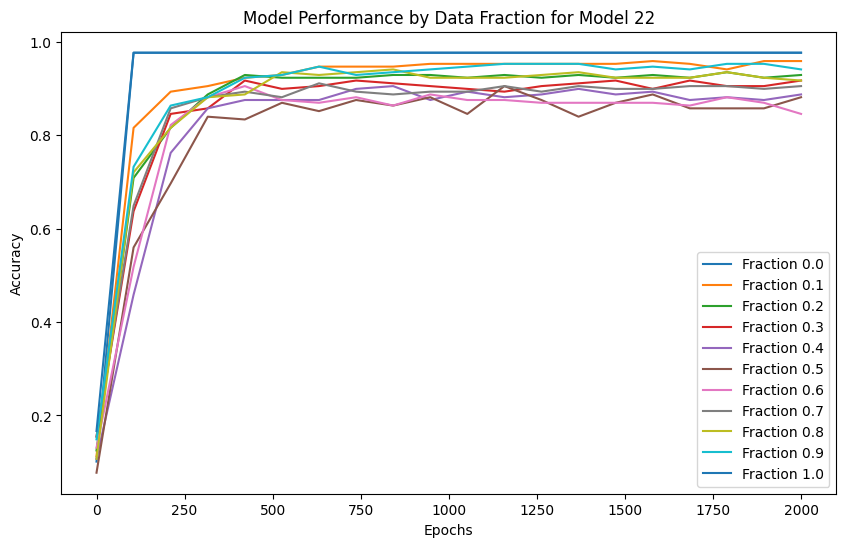

Model 23, Fraction 0.00, Epoch 1, Loss: 2.1994
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.2728
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.5976
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.2912
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.1755
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.1280
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.1048
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.0917
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.0837
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.0783
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.0718
predi

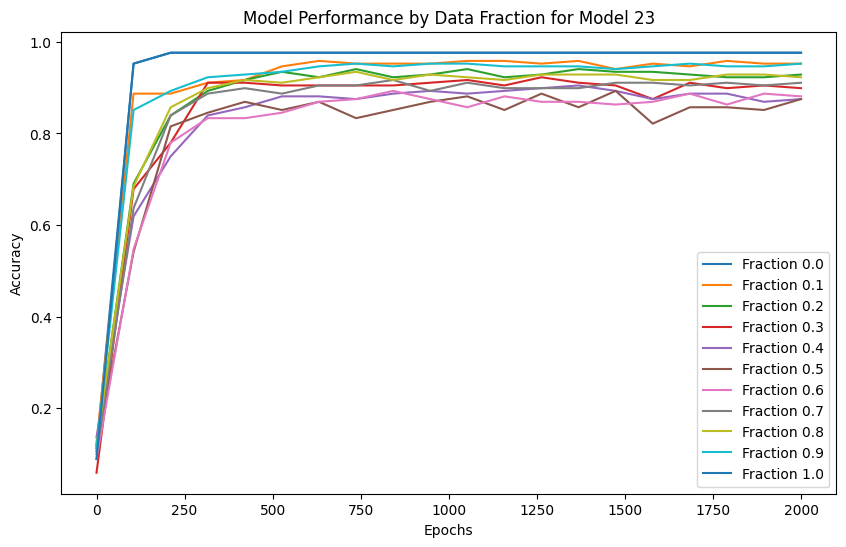

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2103
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.3676
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.6303
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.2951
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.1778
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.1298
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.1059
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.0923
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.0839
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.0783
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.0716
predi

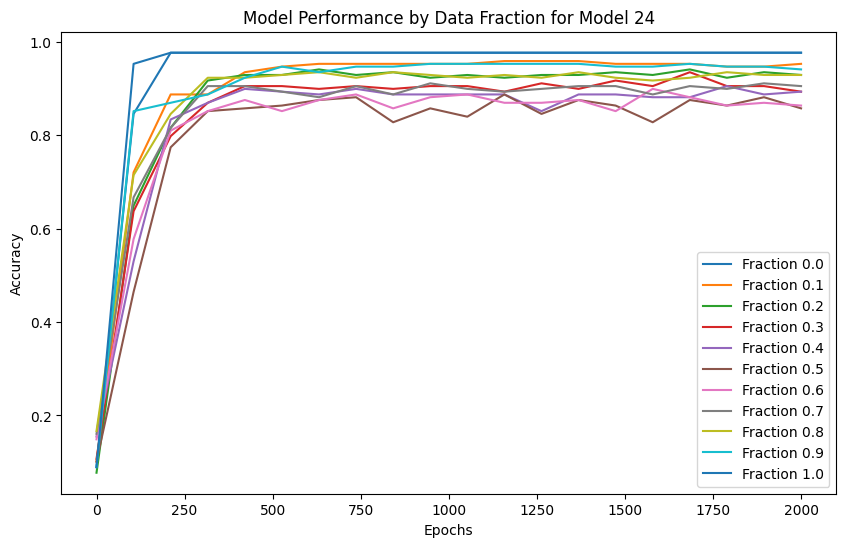

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2015
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.2543
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.5532
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.2567
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.1601
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.1207
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.1008
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.0893
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.0820
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.0771
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.0737
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.0711
predi

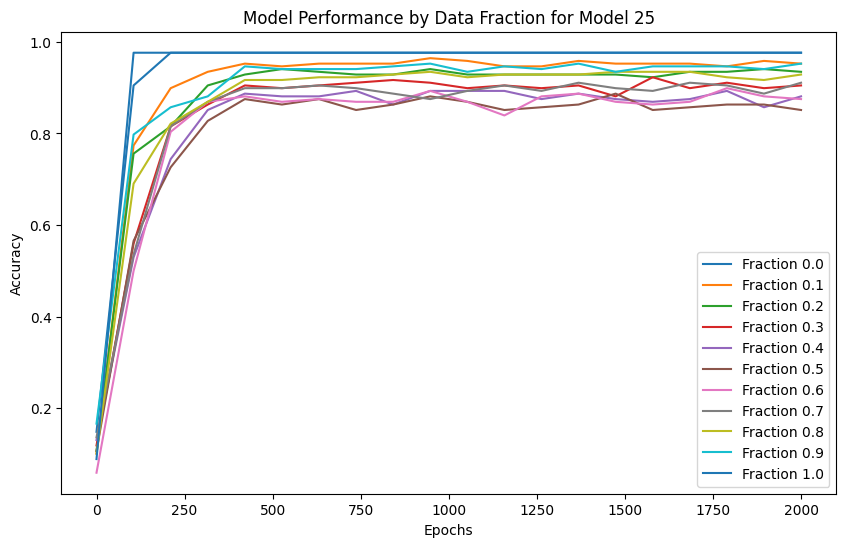

Model 26, Fraction 0.00, Epoch 1, Loss: 2.2157
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.3086
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.5626
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.2656
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.1633
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.1207
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.0995
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.0877
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.0757
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.0723
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.0700
predi

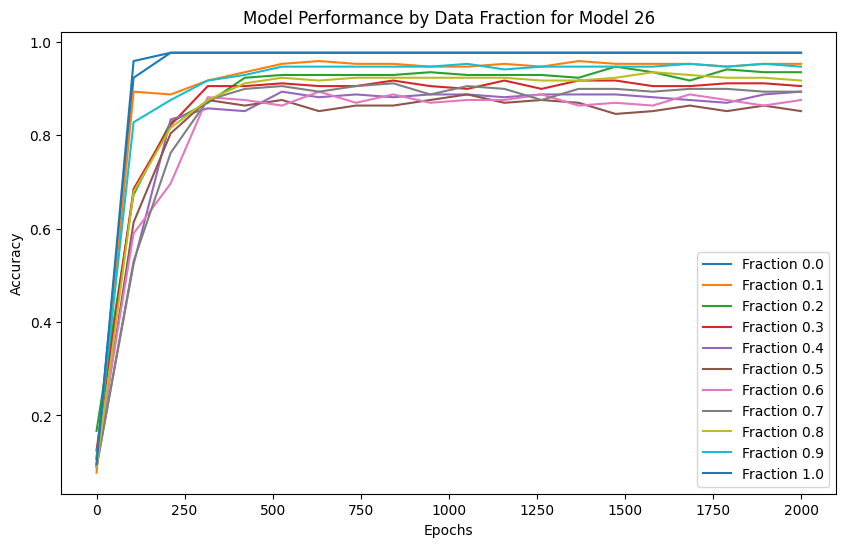

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2020
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.3266
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.6598
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.3108
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.1839
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.1324
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.1073
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.0933
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.0847
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.0790
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.0750
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.0722
predi

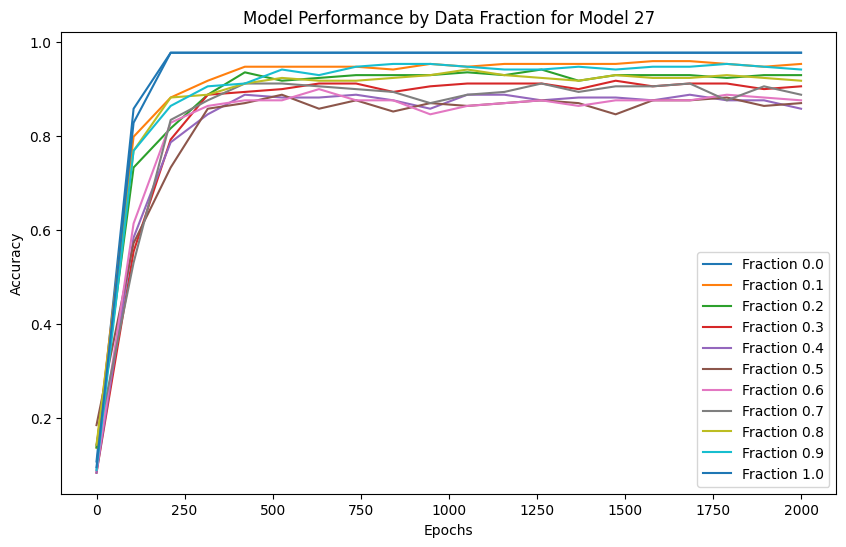

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2089
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.3025
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.6573
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.3337
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.1992
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.1407
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.1118
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.0958
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.0862
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.0799
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.0756
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.0726
predi

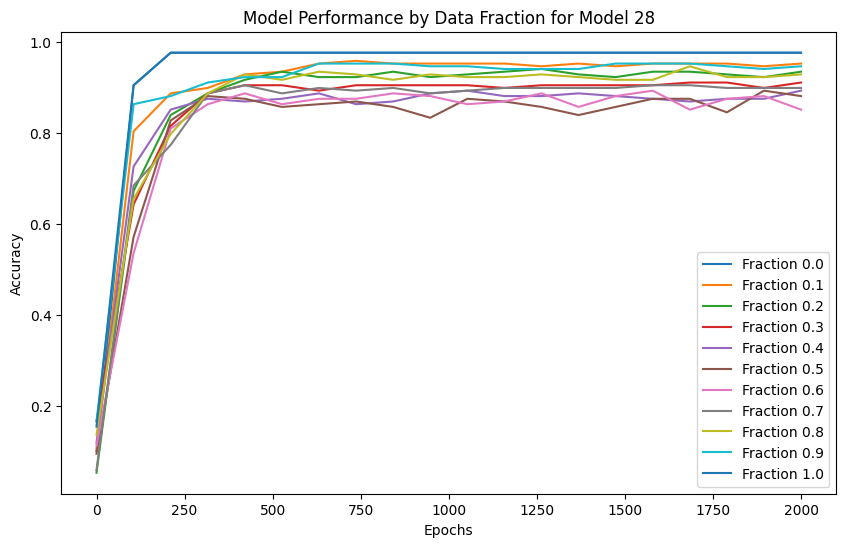

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2430
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.3887
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.6458
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.3175
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.1886
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.1342
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.1075
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.0930
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.0841
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.0716
predi

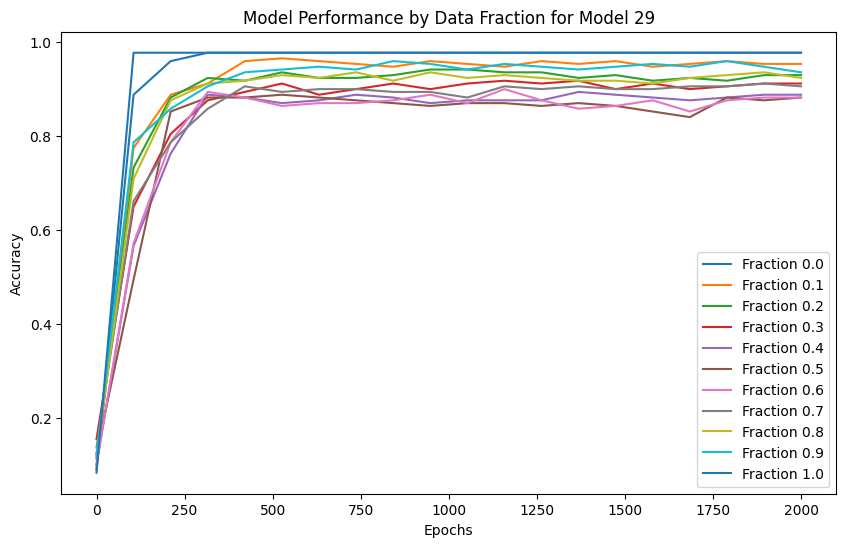

In [26]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
    #"ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_different_normal_reverse/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [27]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_normal_reverse"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0000
  Fraction 0.10, Average Accuracy: 0.7315
  Fraction 0.20, Average Accuracy: 0.7331
  Fraction 0.30, Average Accuracy: 0.7331
  Fraction 0.40, Average Accuracy: 0.7607
  Fraction 0.50, Average Accuracy: 0.8530
  Fraction 0.60, Average Accuracy: 0.9442
  Fraction 0.70, Average Accuracy: 0.9704
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9754
  Fraction 0.30, Average Accuracy: 0.9754
  Fraction 0.40, Average Accuracy: 0.9528
  Fraction 0.50, Average Accuracy: 0.8675
  Fraction 0.60, Average Accuracy: 0.7704
  Fraction 0.70, Average Accuracy: 0.7389
  Fraction 0.80, Average Accuracy: 0.7321
  Fraction 0.90, Average Accuracy: 0.7321
  Fraction 1.00, Average Accuracy: 0.0022


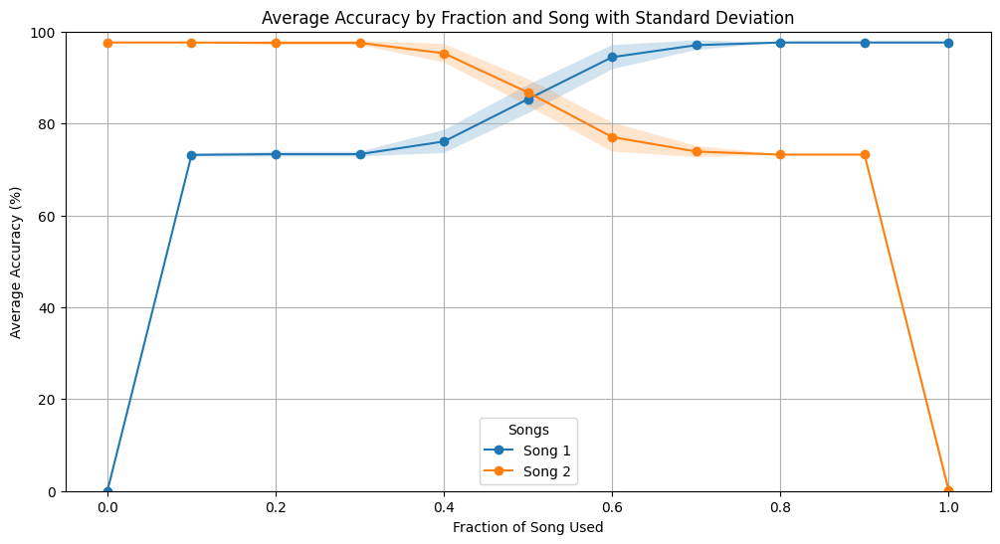

In [28]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


## training and testing for different songs lower parameters

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2050
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 101, Loss: 1.8370
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 201, Loss: 1.3519
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.0797
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.8865
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.6744
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4707
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.3272
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.2440
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.1928
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.1595
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.1368
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.1207
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1301, Loss: 0.1090
prediction sh

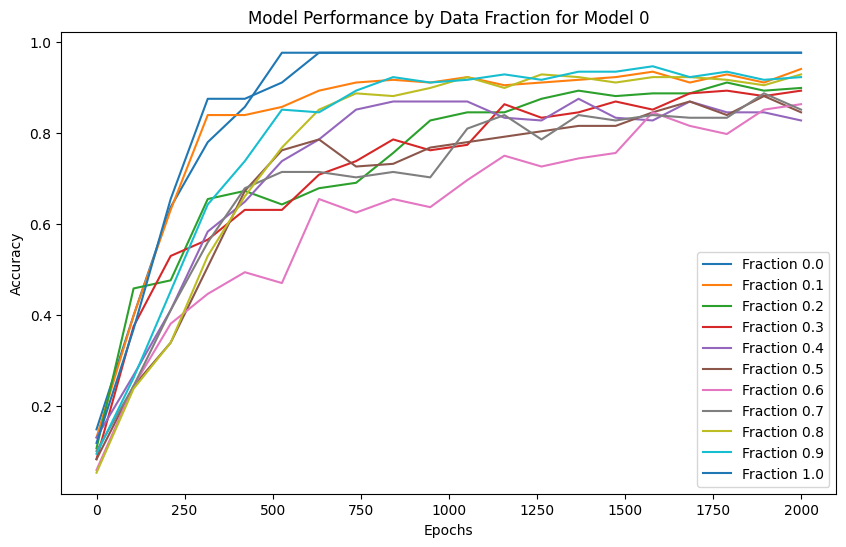

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2173
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.9190
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.3759
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.0197
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.7384
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.5410
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.3906
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.2930
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.2311
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.1889
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.1590
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.1372
prediction shape 

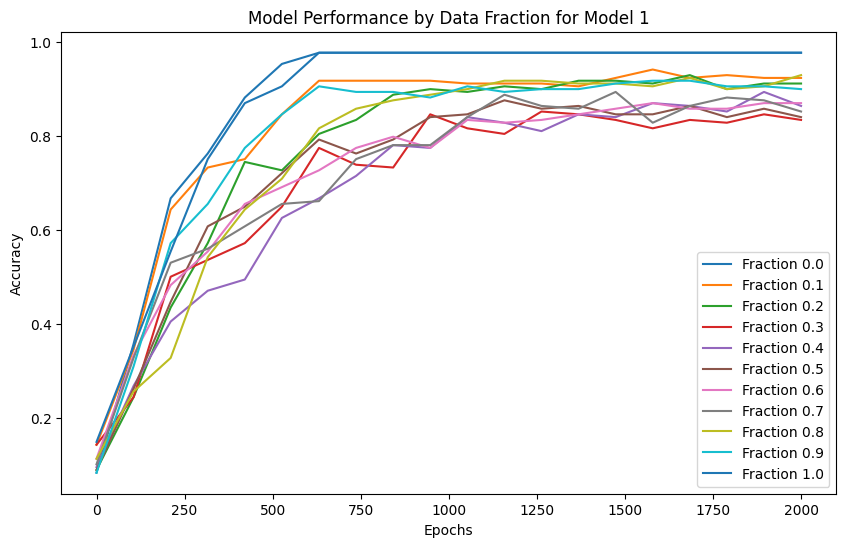

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.8514
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.4418
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.1198
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.8809
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.7285
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.6072
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.4989
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.4103
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.3199
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.2239
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.1696
prediction shape 

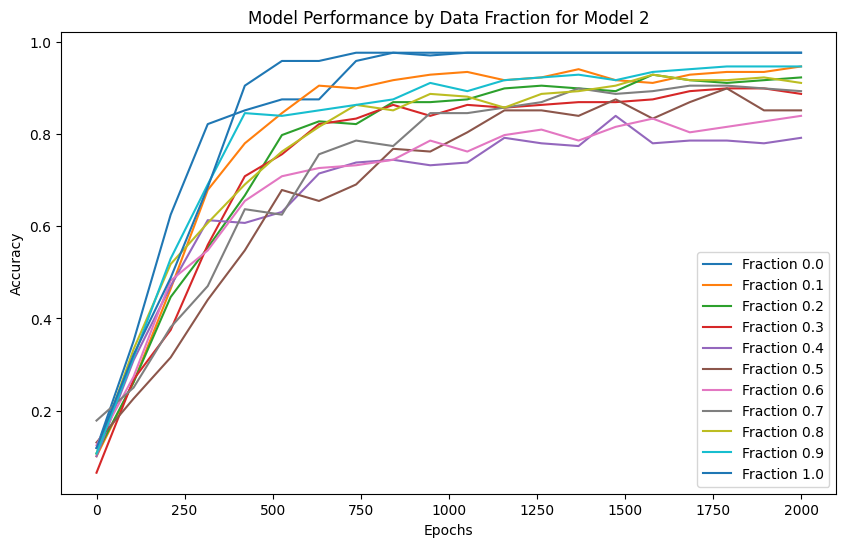

Model 3, Fraction 0.00, Epoch 1, Loss: 2.1976
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.8614
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.3463
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.0130
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.7996
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.6425
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.5007
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.3712
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.2638
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.1906
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.1474
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.1243
prediction shape 

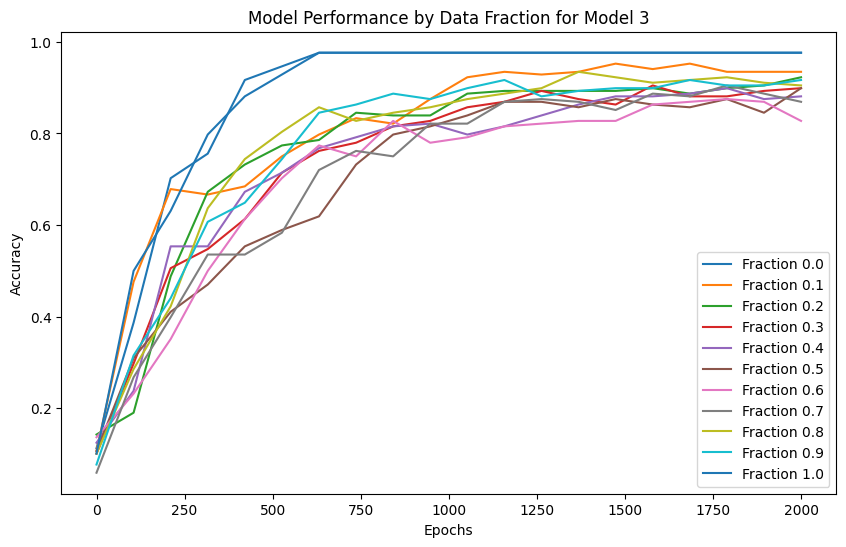

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2081
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.9348
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.4618
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.0653
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.7403
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.5402
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.3826
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.2835
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.2210
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.1803
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.1527
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.1331
prediction shape 

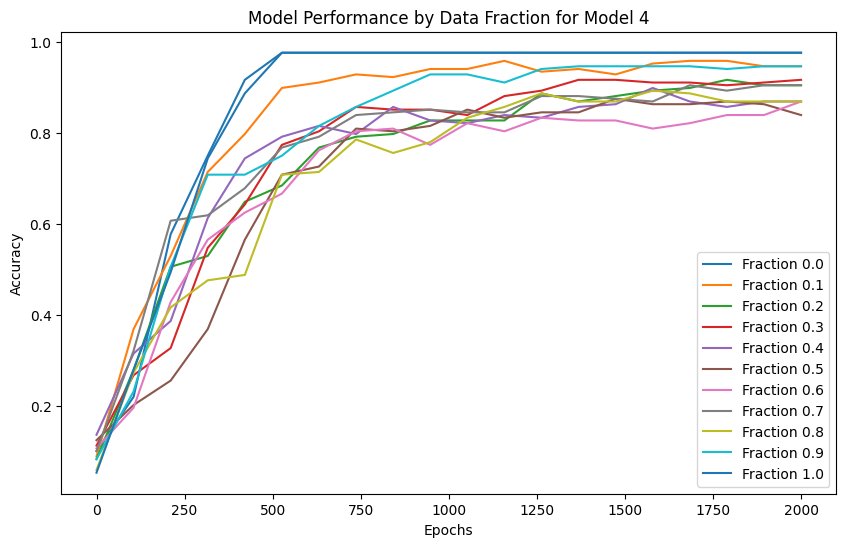

Model 5, Fraction 0.00, Epoch 1, Loss: 2.1968
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.8220
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.2785
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.9657
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.7614
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.6232
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.4806
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.3679
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.2866
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.2261
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.1783
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.1448
prediction shape 

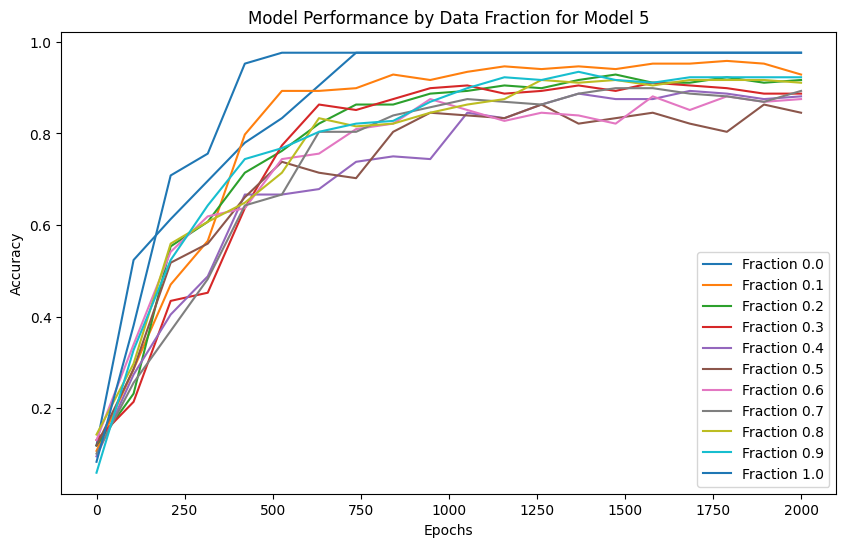

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2051
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.9114
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.4056
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 1.1036
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.8621
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.6246
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4527
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.3262
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.2420
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.1910
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.1590
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.1373
prediction shape 

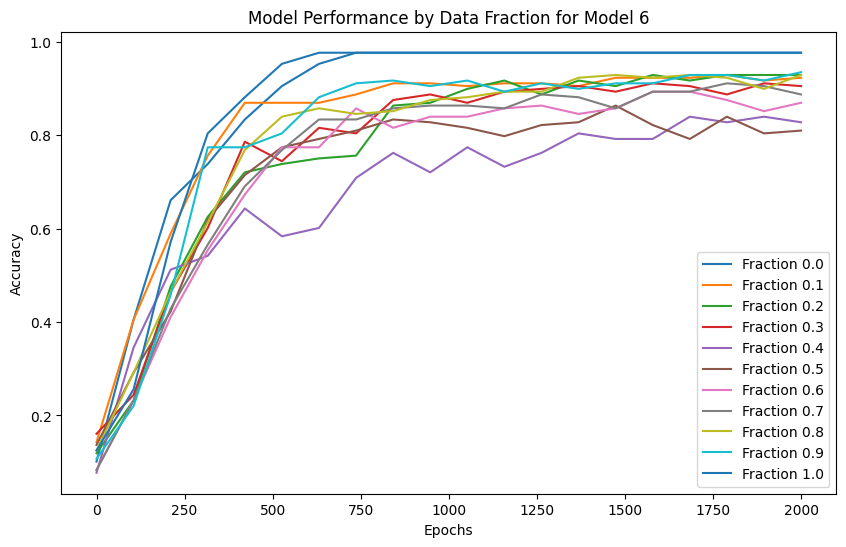

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2039
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.8986
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.3814
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.9998
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.6692
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.4686
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.3475
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.2631
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.2048
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.1663
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.1405
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.1228
prediction shape 

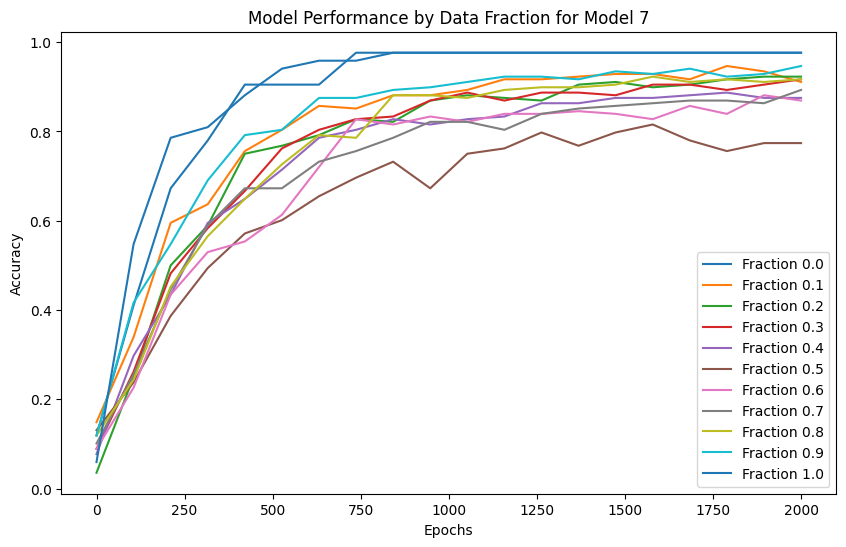

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2076
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.9197
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.4052
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.1100
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.7899
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.5194
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.3577
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.2622
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.2040
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.1666
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.1412
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.1237
prediction shape 

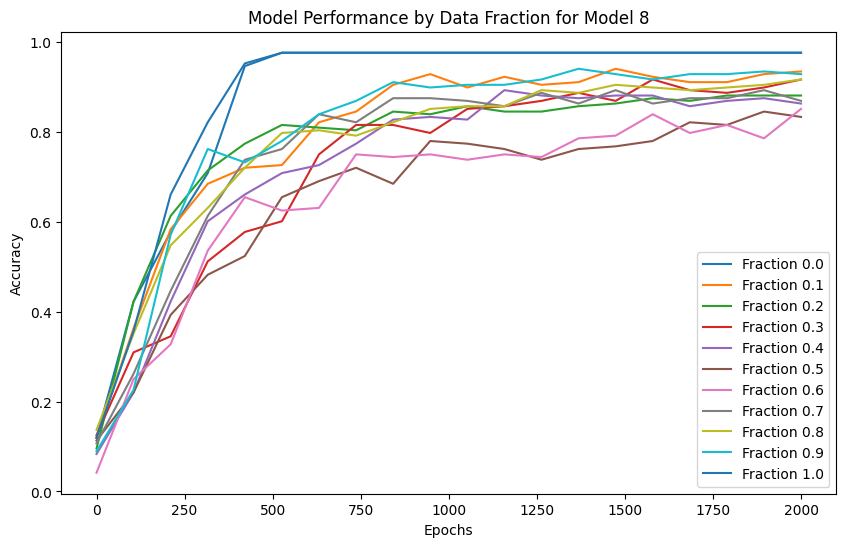

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2078
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.9289
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.4301
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.0373
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.7569
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.5354
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.3667
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.2646
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.2044
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.1662
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.1408
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.1231
prediction shape 

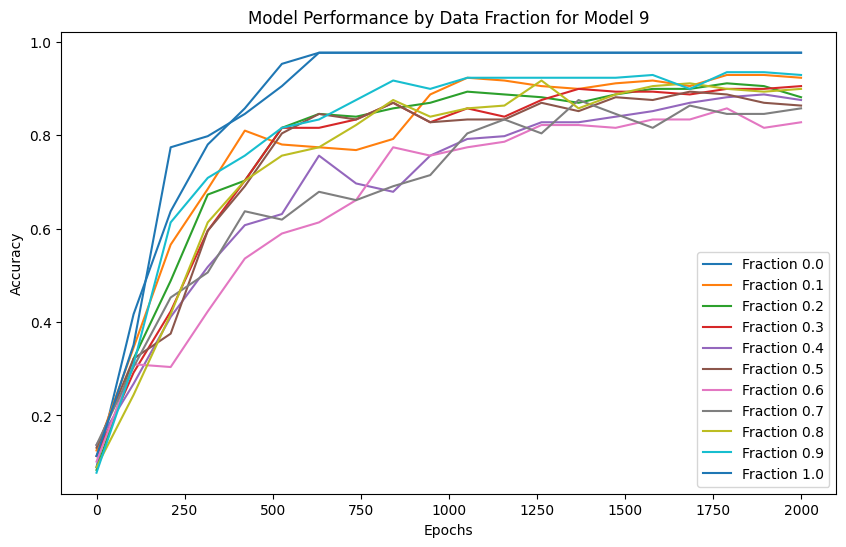

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2168
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.9287
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.4652
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 1.1203
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.8281
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.5681
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.4125
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.3154
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.2453
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.1937
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.1592
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.1350
predi

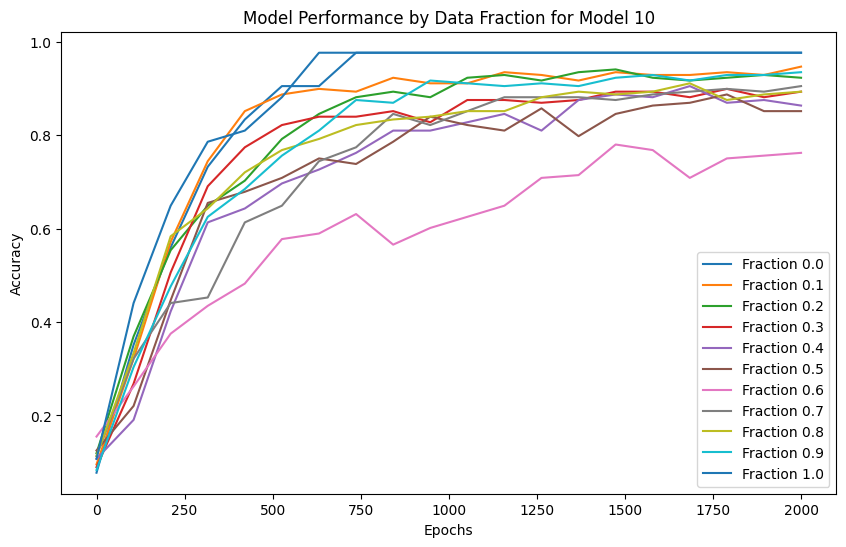

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2185
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.9751
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.4025
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 1.0505
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.7958
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.5962
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.4428
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.3332
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.2537
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.1997
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.1633
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.1386
predi

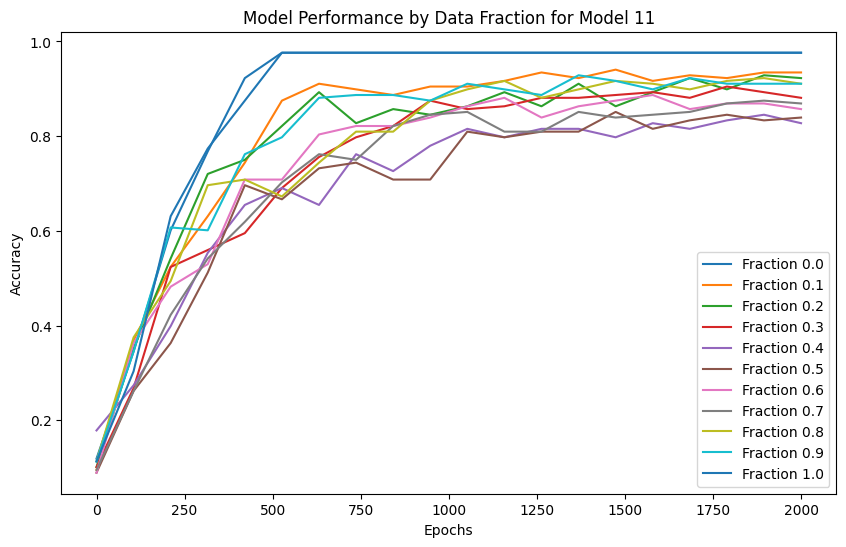

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2086
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.8753
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.5045
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 1.1912
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.8686
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.5736
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.3742
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.2662
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.2050
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.1670
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.1419
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.1244
predi

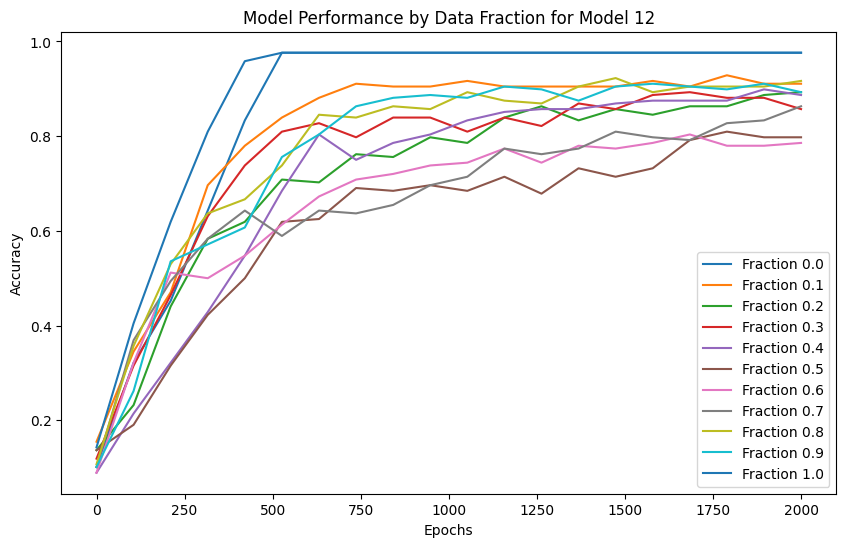

Model 13, Fraction 0.00, Epoch 1, Loss: 2.1913
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.8171
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.3370
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.9936
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.7727
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.6178
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.4504
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.3234
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.2410
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.1891
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.1557
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.1334
predi

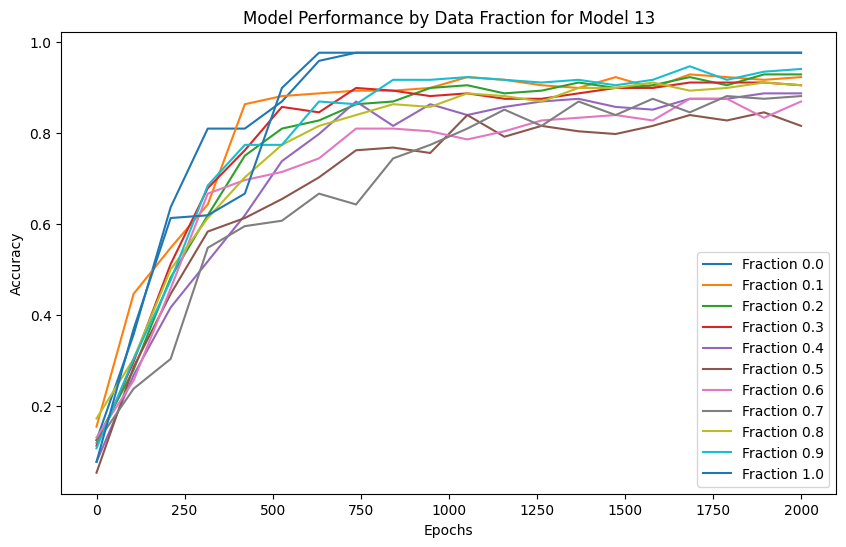

Model 14, Fraction 0.00, Epoch 1, Loss: 2.1917
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.8365
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.3394
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 1.0399
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.7703
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.5324
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.3791
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.2796
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.2132
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.1708
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.1438
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.1256
predi

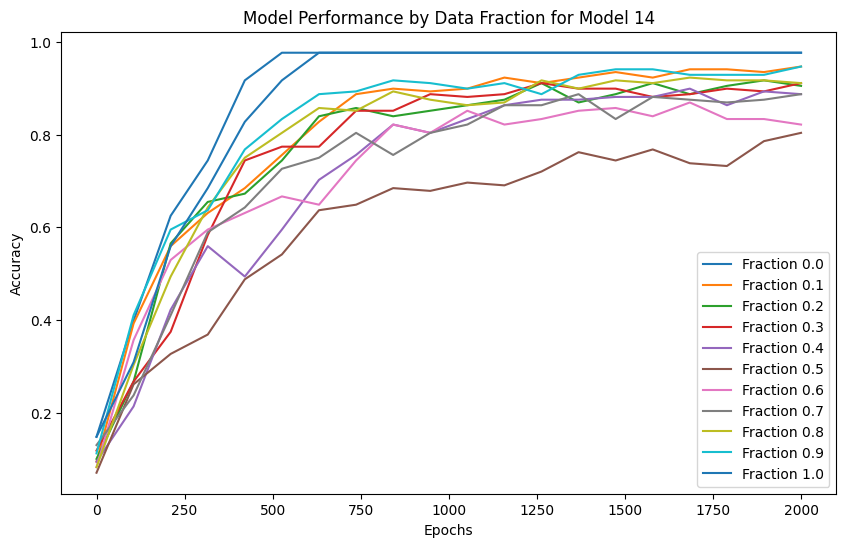

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2040
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.8966
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.3985
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 1.1026
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.8374
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.6215
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4656
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.3521
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.2681
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.2066
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.1605
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.1323
predi

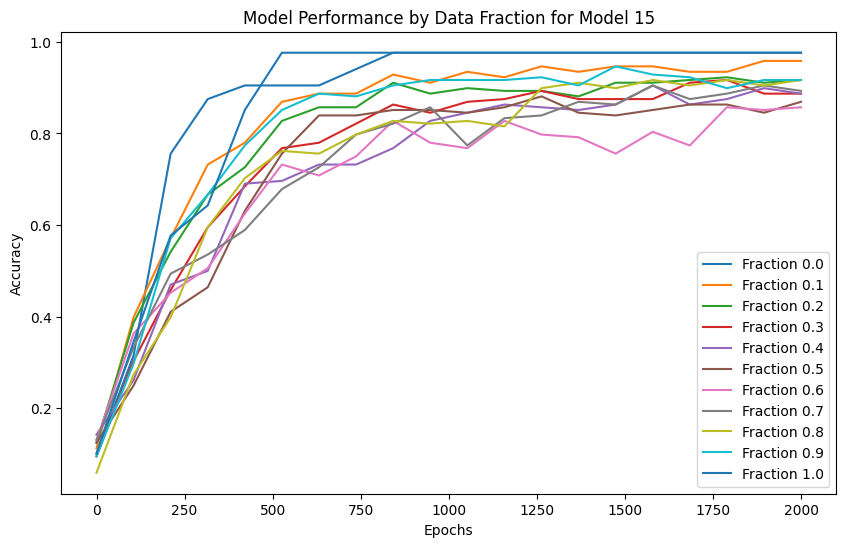

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2001
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.9171
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.3987
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 1.1253
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.8024
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.5518
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.3683
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.2632
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.2018
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.1625
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.1372
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.1198
predi

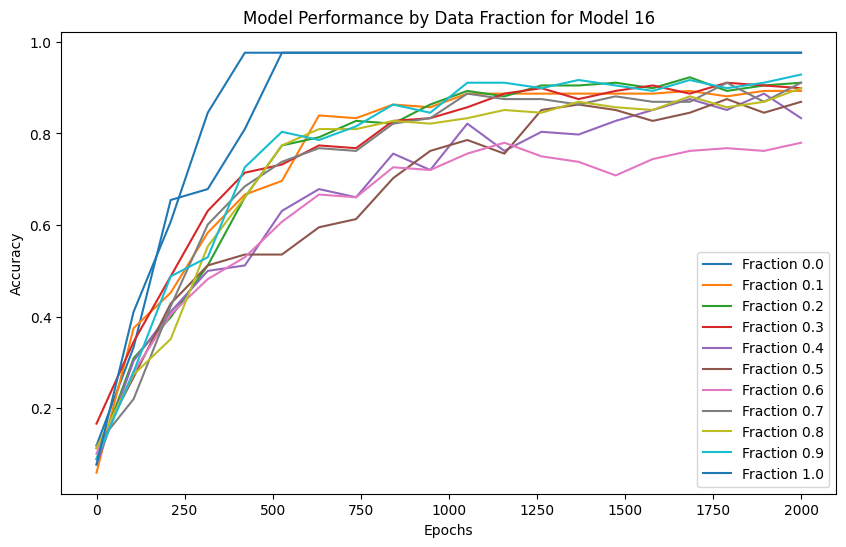

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2081
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.9824
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.3735
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.9543
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.6934
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.5002
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.3547
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.2636
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.2079
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.1465
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.1289
predi

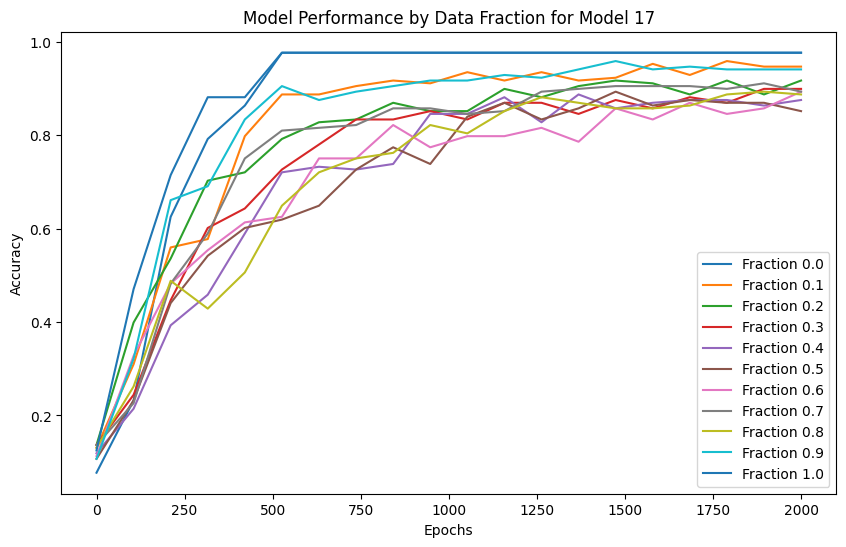

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2006
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.8832
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.3367
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.9815
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.7481
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.5955
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.4523
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.3211
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.2384
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.1869
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.1542
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.1324
predi

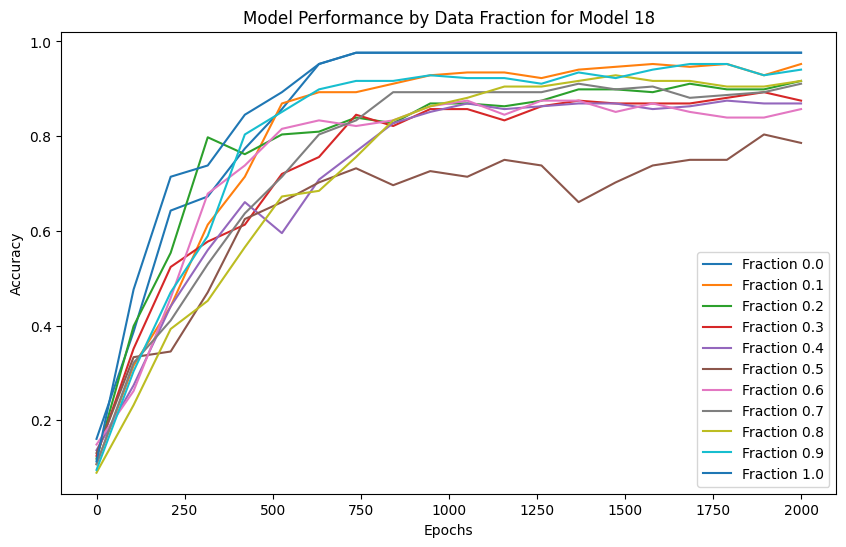

Model 19, Fraction 0.00, Epoch 1, Loss: 2.1994
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.9353
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.3731
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 1.0694
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.8407
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.6726
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.5167
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.3632
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.2522
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.1792
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.1428
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.1220
predi

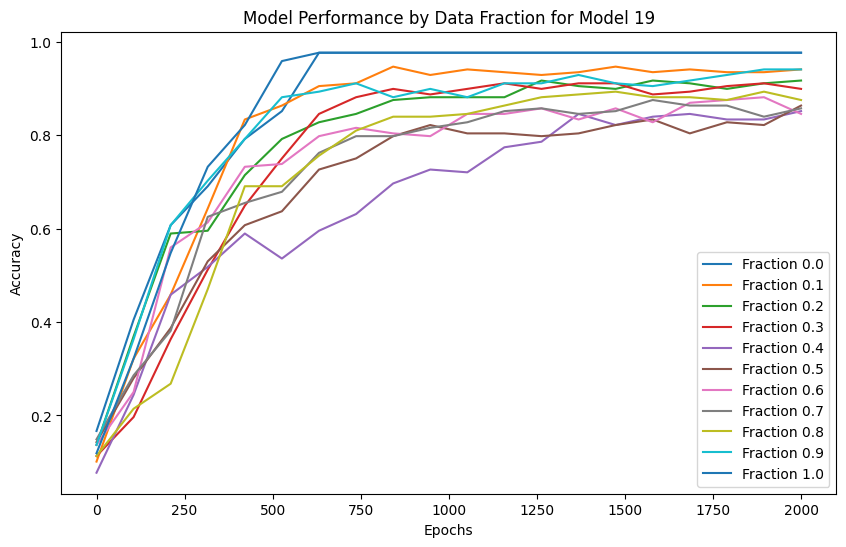

Model 20, Fraction 0.00, Epoch 1, Loss: 2.2148
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.9161
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.4214
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 1.0952
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.7668
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5564
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4032
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.2917
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.2214
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.1787
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.1506
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.1311
predi

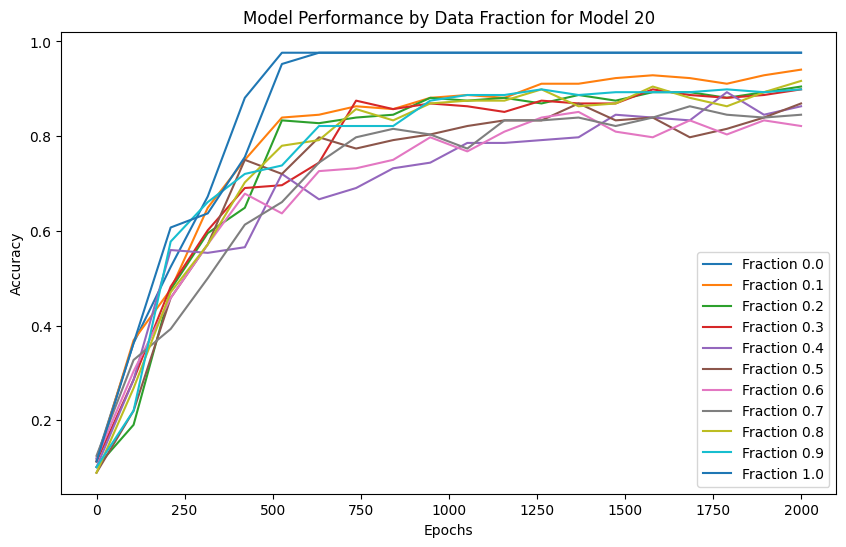

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2050
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.8802
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.3096
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.9317
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.6934
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.5475
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.3938
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.2834
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.2183
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.1771
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.1496
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.1304
predi

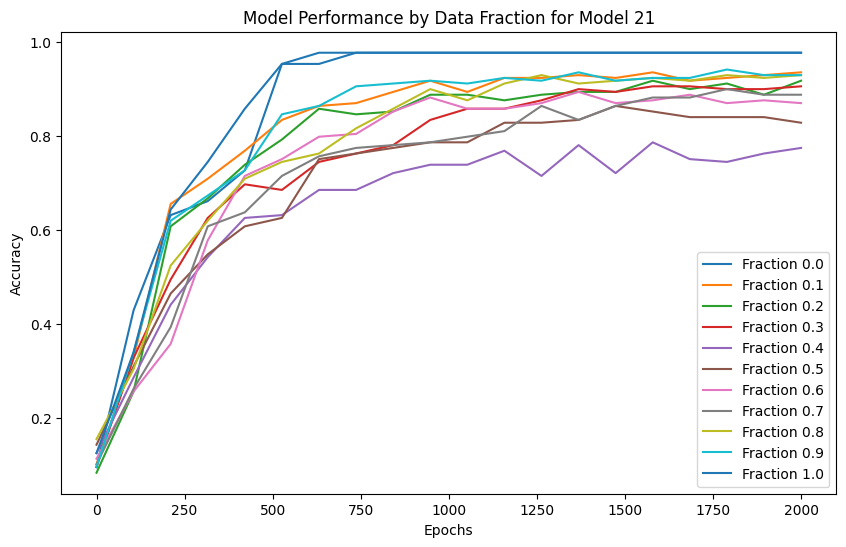

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2072
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.9946
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.3930
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 1.0060
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.7096
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.4694
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.3363
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.2551
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.2020
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.1661
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.1413
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.1239
predi

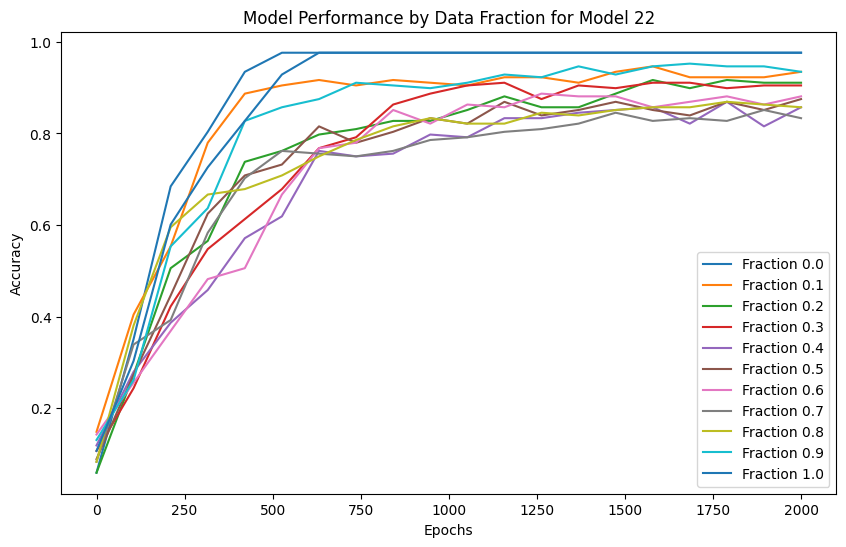

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2019
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.9152
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.4162
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 1.0462
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.7742
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.5692
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.4211
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.3105
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.2344
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.1865
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.1558
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.1350
predi

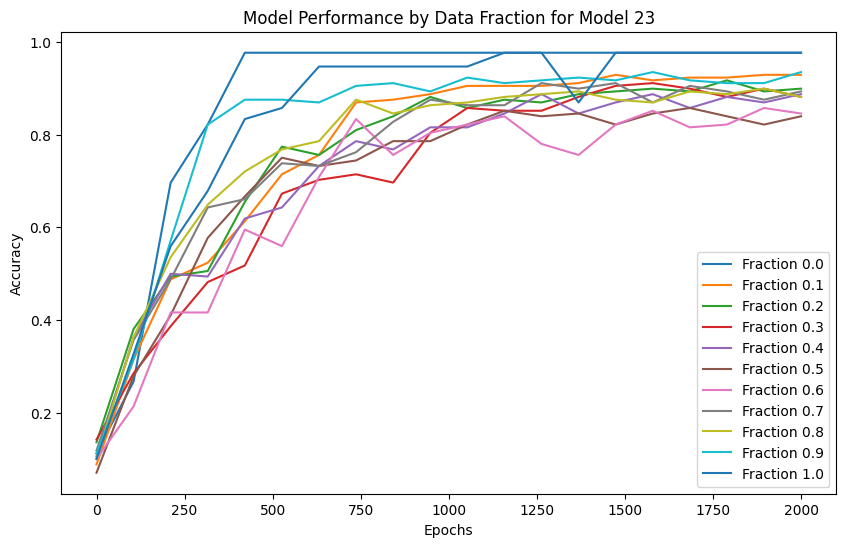

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2132
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.9138
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.3639
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 1.0346
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.7903
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.6139
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4691
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.3546
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.2543
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.1867
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.1506
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.1286
predi

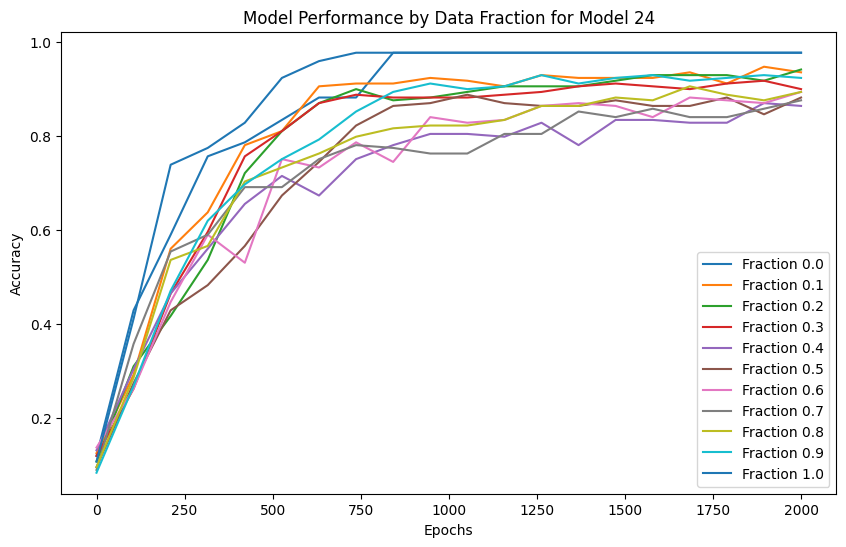

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2052
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.8737
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.3970
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 1.1211
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.9243
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.7096
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.5311
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.4135
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.3245
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.2600
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.2131
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.1774
predi

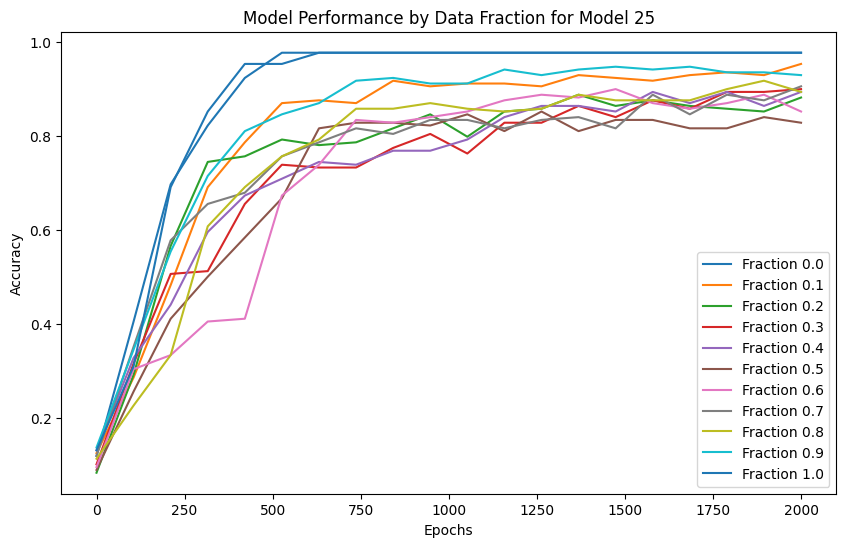

Model 26, Fraction 0.00, Epoch 1, Loss: 2.2055
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.8755
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.4153
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 1.0825
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.8497
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.6657
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.4706
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.3071
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.2267
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.1811
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.1517
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.1314
predi

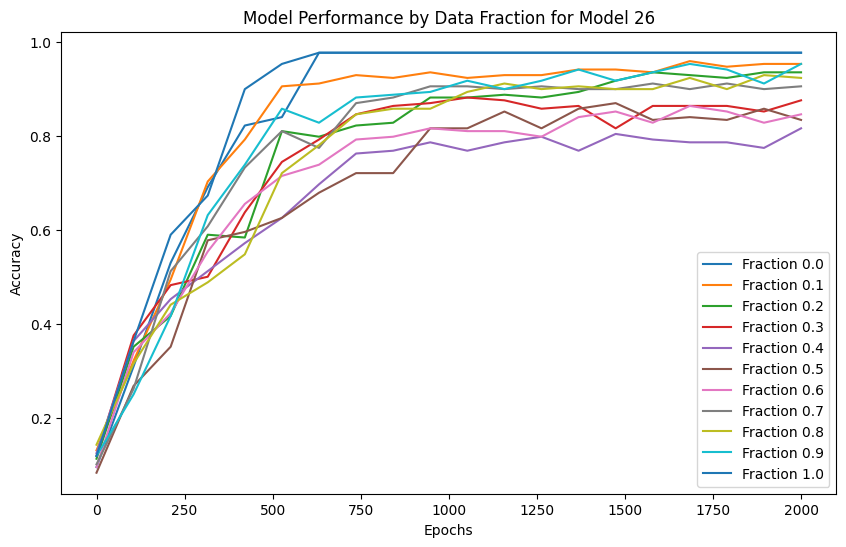

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2151
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.9202
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.3643
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 1.0643
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.7954
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.5717
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4062
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.2920
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.2236
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.1798
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.1512
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.1312
predi

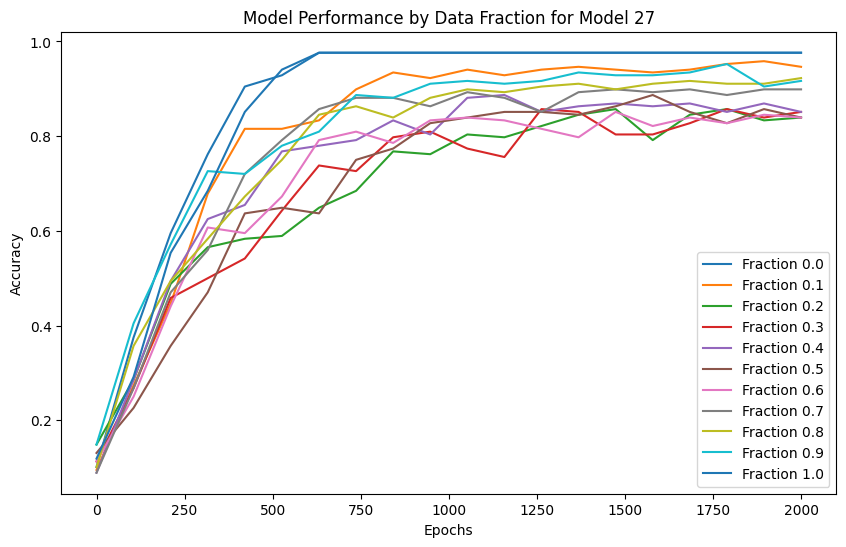

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2046
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.8854
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.4489
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 1.1544
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.9383
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.7260
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.5186
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.3530
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.2360
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.1796
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.1485
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.1284
predi

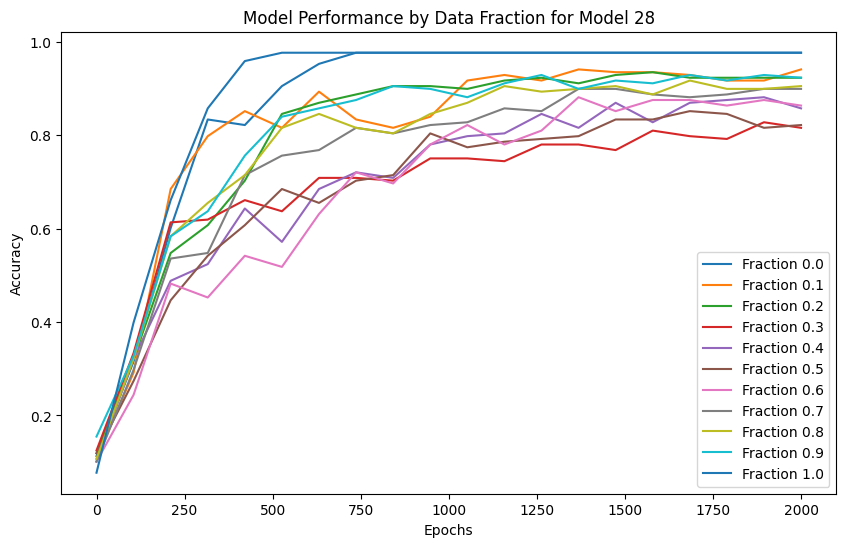

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.9958
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.3441
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.9760
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.7120
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.5637
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.4626
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.3449
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.2670
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.2143
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.1767
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.1496
predi

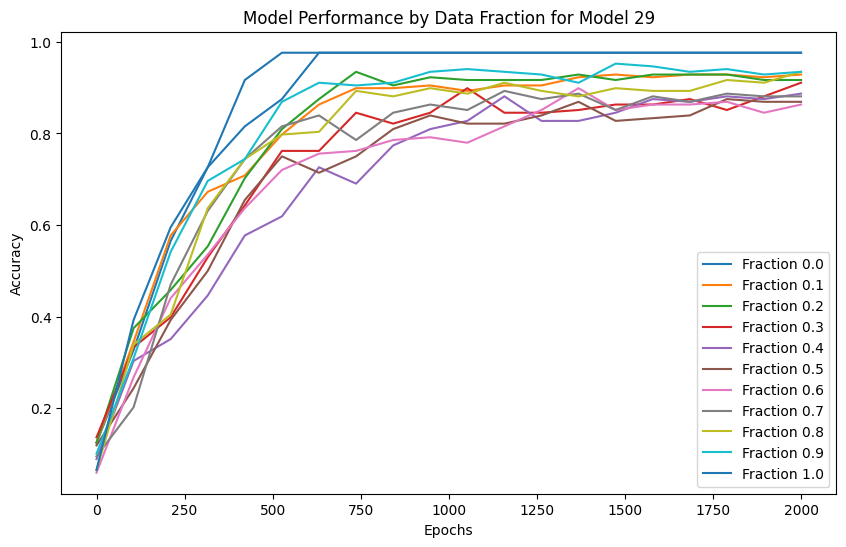

In [29]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
    #"ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_different_normal_reverse_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [30]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_normal_reverse_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0155
  Fraction 0.10, Average Accuracy: 0.5381
  Fraction 0.20, Average Accuracy: 0.6446
  Fraction 0.30, Average Accuracy: 0.7012
  Fraction 0.40, Average Accuracy: 0.7292
  Fraction 0.50, Average Accuracy: 0.8415
  Fraction 0.60, Average Accuracy: 0.9141
  Fraction 0.70, Average Accuracy: 0.9589
  Fraction 0.80, Average Accuracy: 0.9724
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9756
  Fraction 0.20, Average Accuracy: 0.9752
  Fraction 0.30, Average Accuracy: 0.9714
  Fraction 0.40, Average Accuracy: 0.9444
  Fraction 0.50, Average Accuracy: 0.8472
  Fraction 0.60, Average Accuracy: 0.7579
  Fraction 0.70, Average Accuracy: 0.7097
  Fraction 0.80, Average Accuracy: 0.6683
  Fraction 0.90, Average Accuracy: 0.6000
  Fraction 1.00, Average Accuracy: 0.0147


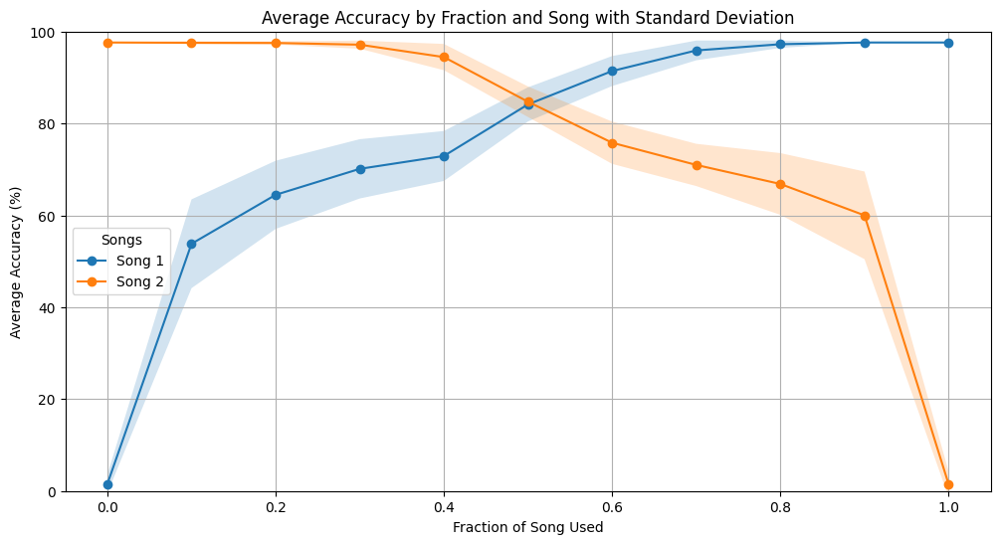

In [31]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


## training and testing for different harder songs

Model 0, Fraction 0.00, Epoch 1, Loss: 2.1959
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_27373/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_27373/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.1846
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.6105
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.4664
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.4310
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.4167
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4093
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.4057
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.4020
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.4004
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.3987
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.3977
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.3973
prediction sha

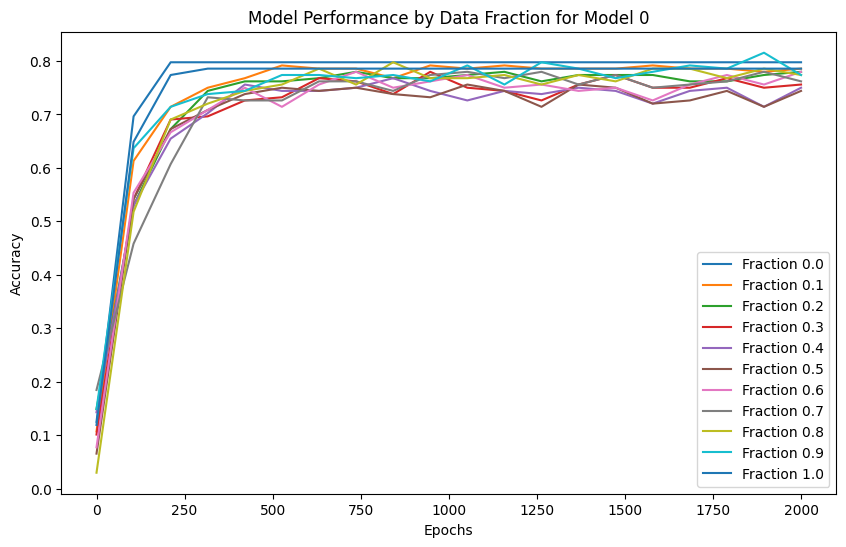

Model 1, Fraction 0.00, Epoch 1, Loss: 2.1850
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.1365
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.5964
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.4609
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.4281
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.4161
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4082
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.4040
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.4014
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.3996
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.3986
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.3975
prediction shape 

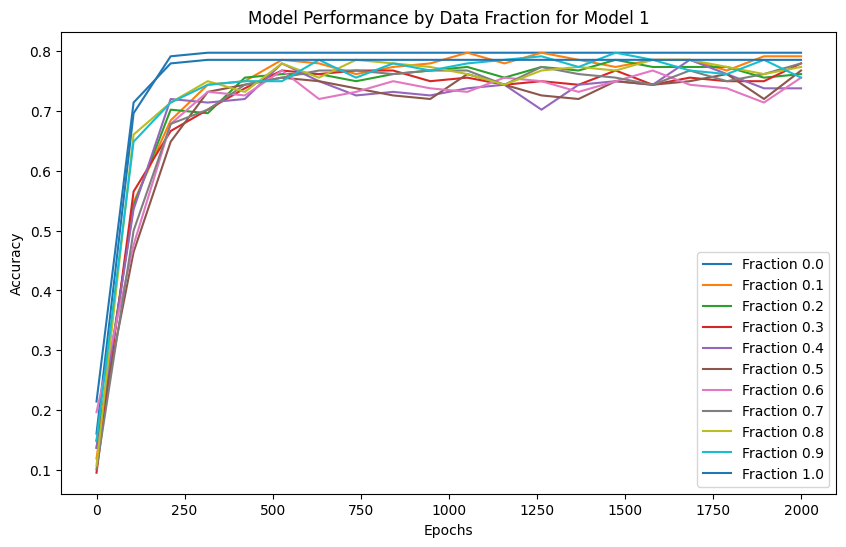

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2330
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.1923
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.7036
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.4972
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.4385
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.4197
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4108
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.4061
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.4027
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.4006
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.3990
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.3983
prediction shape 

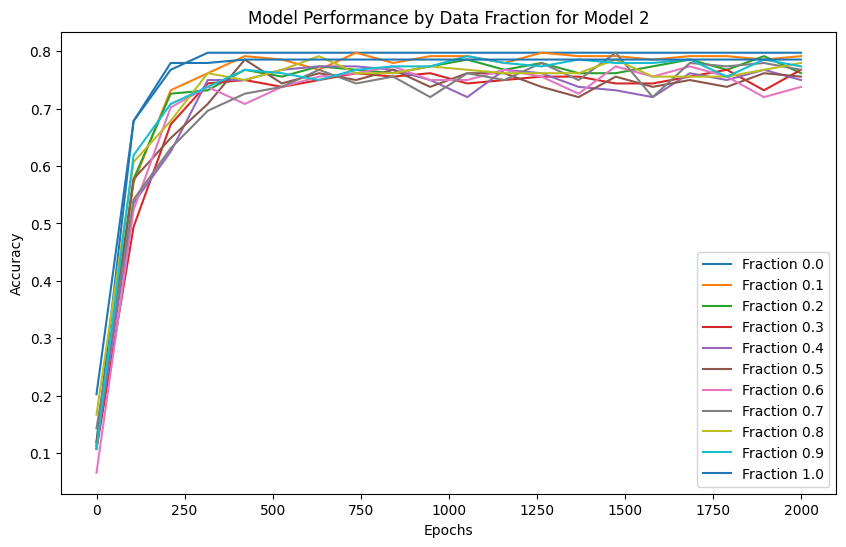

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2401
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.2117
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.6268
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.4678
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.4312
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.4162
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.4090
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.4044
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.4016
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.4000
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.4011
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.3992
prediction shape 

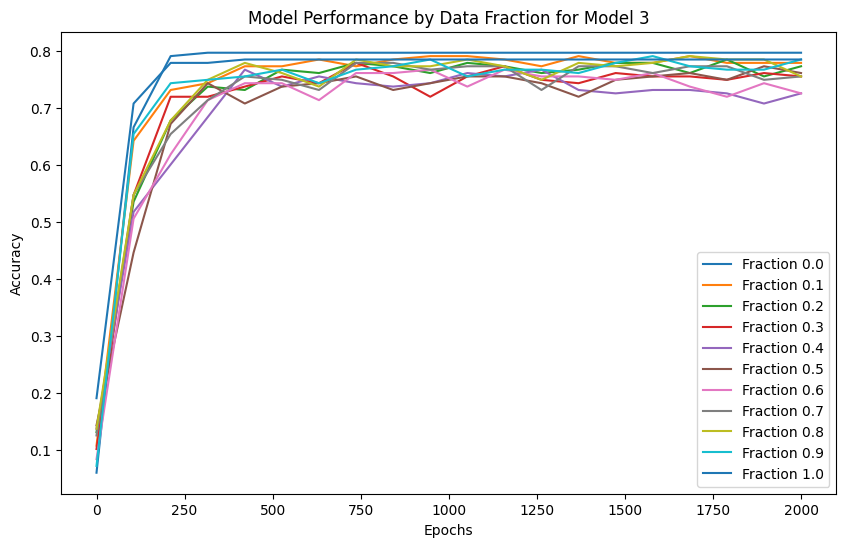

Model 4, Fraction 0.00, Epoch 1, Loss: 2.1969
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.1517
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.6582
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.4795
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.4335
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.4176
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.4109
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.4050
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.4035
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.4002
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.3988
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.3978
prediction shape 

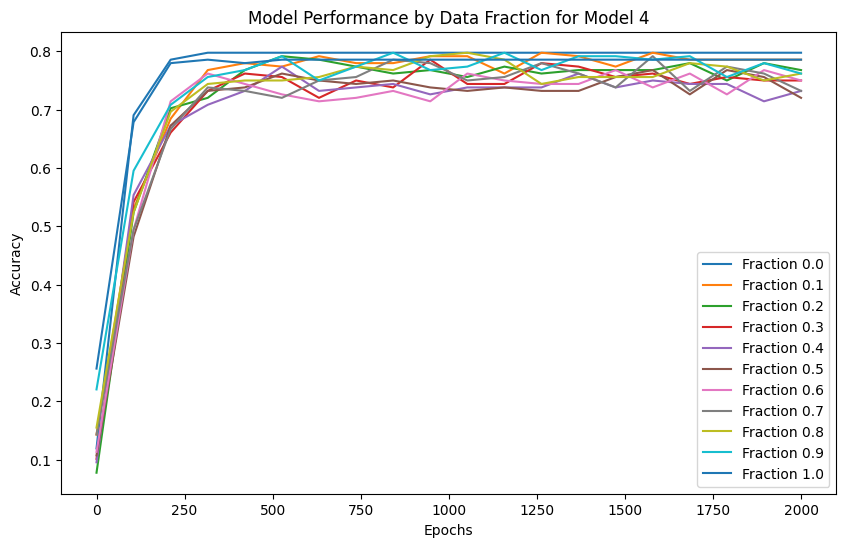

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2076
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.1962
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.6777
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.4800
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.4312
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.4163
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.4080
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.4051
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.4012
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.3996
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.3995
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.3973
prediction shape 

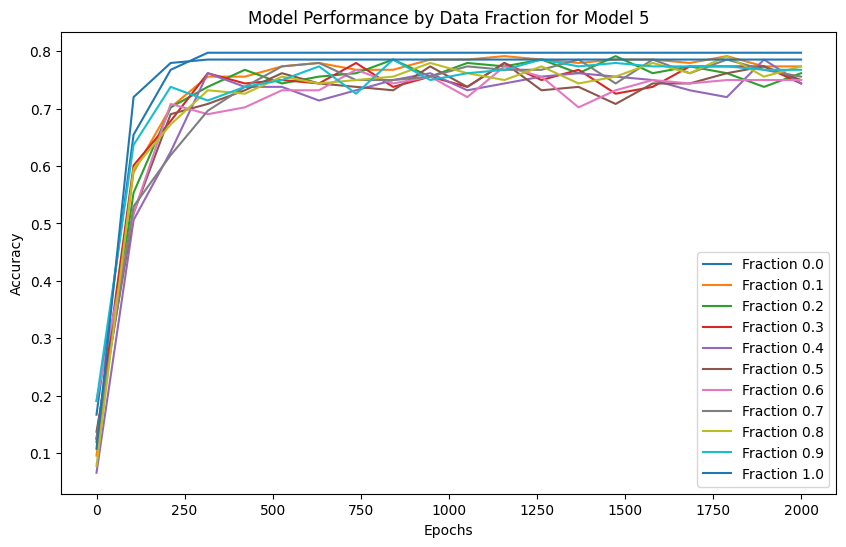

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2512
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.2259
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.6625
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.4805
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.4297
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.4150
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4103
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.4039
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.4013
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.3993
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.3981
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.3972
prediction shape 

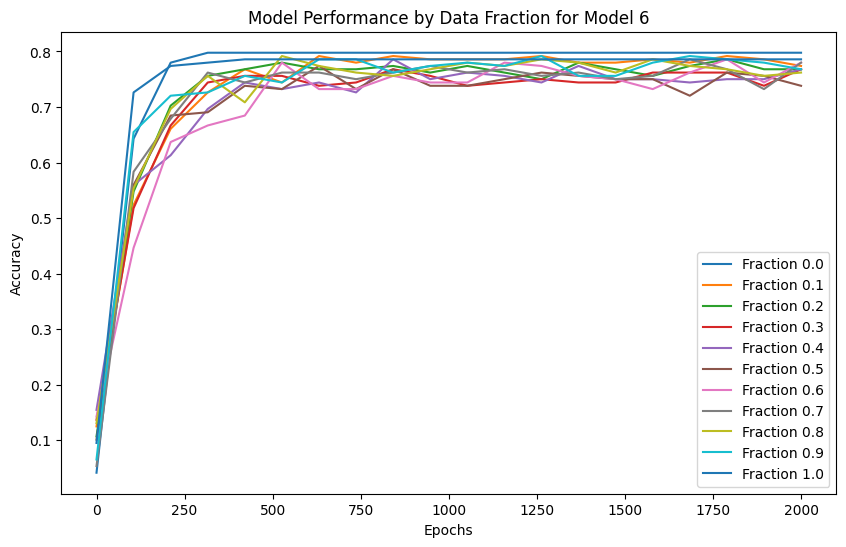

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2213
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.1941
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.6315
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.4718
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.4320
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.4167
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4091
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.4045
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.4022
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.3999
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.3985
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.3977
prediction shape 

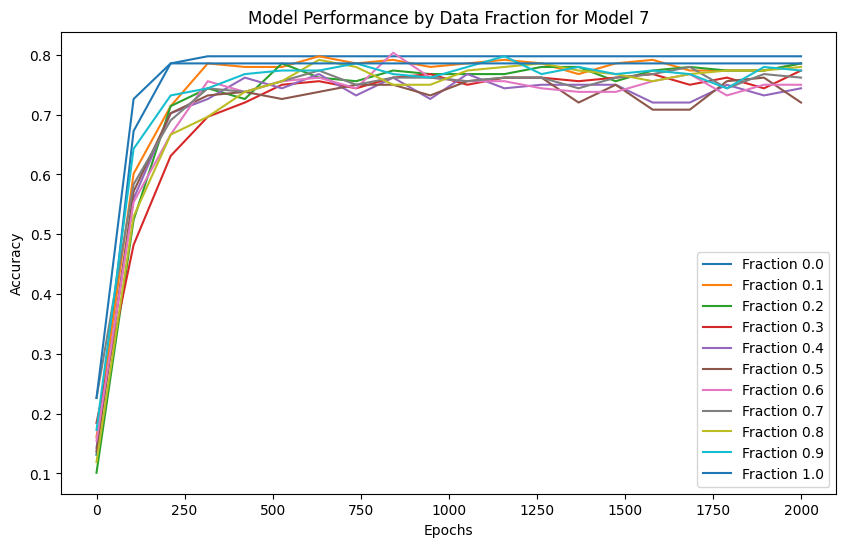

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2094
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.1781
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.6447
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.4696
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.4309
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.4154
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.4080
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.4039
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.4015
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.3994
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.3990
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.3976
prediction shape 

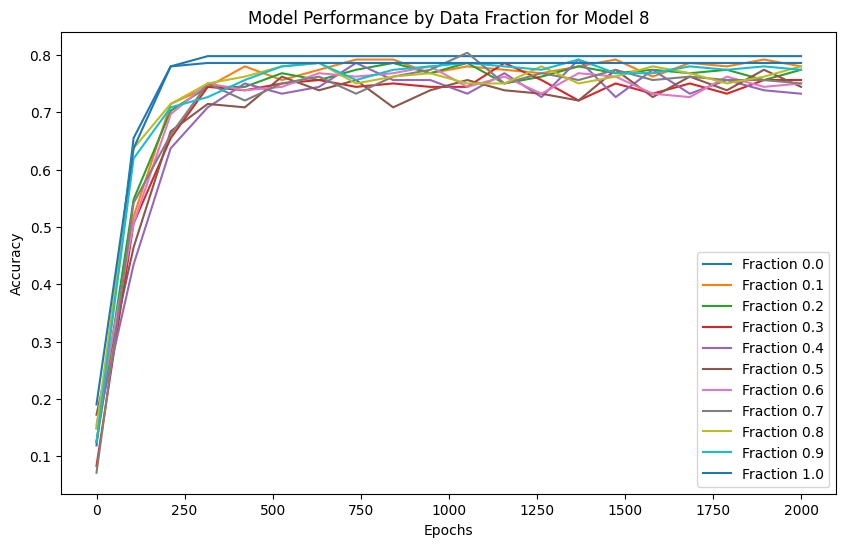

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2471
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.2276
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.6303
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.4673
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.4306
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.4168
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.4087
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.4044
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.4017
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.3998
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.3988
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.3976
prediction shape 

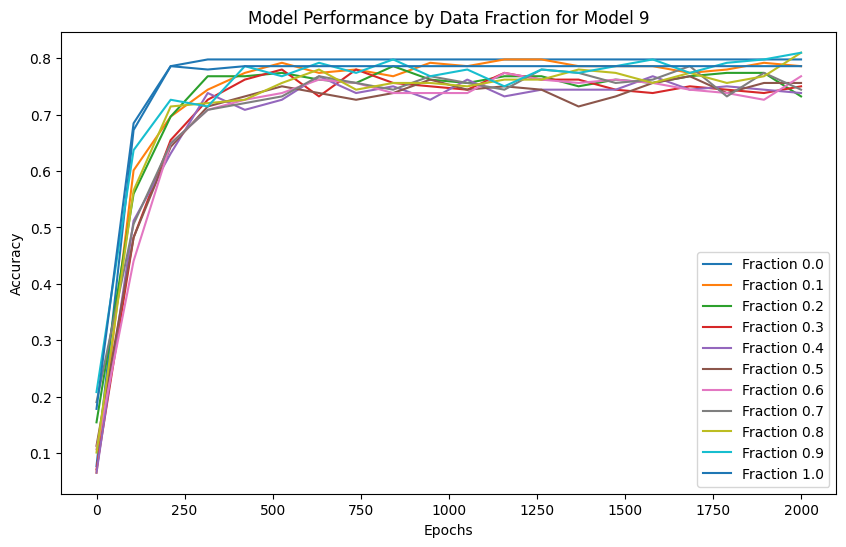

In [89]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 14
nhead = 2
d_hid = 14
nlayers = 4
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 10  # Train 30 different models

songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_different_hard_songs/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [90]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 14
nhead = 2
d_hid = 14
nlayers = 4
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_hard_songs"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0149
  Fraction 0.10, Average Accuracy: 0.6452
  Fraction 0.20, Average Accuracy: 0.6476
  Fraction 0.30, Average Accuracy: 0.6845
  Fraction 0.40, Average Accuracy: 0.7161
  Fraction 0.50, Average Accuracy: 0.7625
  Fraction 0.60, Average Accuracy: 0.7827
  Fraction 0.70, Average Accuracy: 0.7821
  Fraction 0.80, Average Accuracy: 0.7851
  Fraction 0.90, Average Accuracy: 0.7845
  Fraction 1.00, Average Accuracy: 0.7857
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.7976
  Fraction 0.10, Average Accuracy: 0.7964
  Fraction 0.20, Average Accuracy: 0.7964
  Fraction 0.30, Average Accuracy: 0.7786
  Fraction 0.40, Average Accuracy: 0.7607
  Fraction 0.50, Average Accuracy: 0.7173
  Fraction 0.60, Average Accuracy: 0.6988
  Fraction 0.70, Average Accuracy: 0.7006
  Fraction 0.80, Average Accuracy: 0.6952
  Fraction 0.90, Average Accuracy: 0.6940
  Fraction 1.00, Average Accuracy: 0.0607


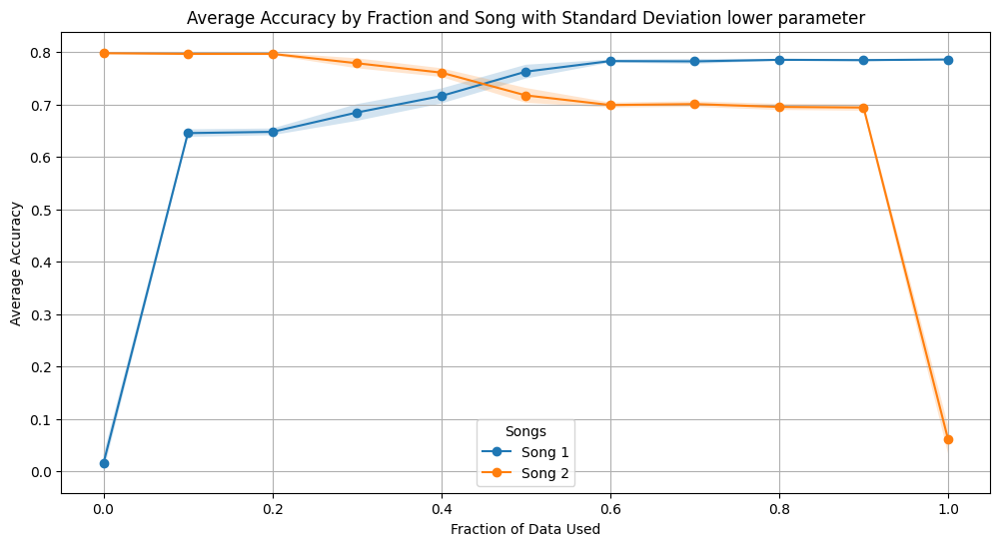

In [92]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension
std_dev_accuracies = accuracies.std(axis=2)  # Standard deviation over the model dimension

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation lower parameter')
plt.xlabel('Fraction of Data Used')
plt.ylabel('Average Accuracy')
plt.legend(title="Songs")
plt.grid(True)
plt.show()


## training and testing for different harder songs with lower parameter

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2012
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_27373/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_27373/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 2.0842
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.6318
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.3767
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 1.2373
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 1.1173
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.9911
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.8925
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.8237
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.7696
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.7233
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.6854
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.6586
prediction sha

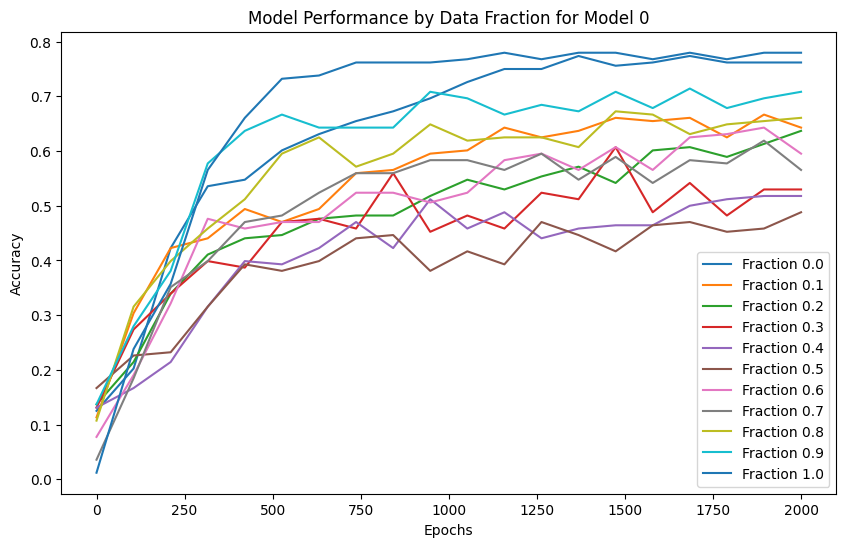

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2016
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.9815
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.5408
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.3354
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 1.2041
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 1.0997
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.9967
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.9130
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.8505
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.8074
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.7743
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.7514
prediction shape 

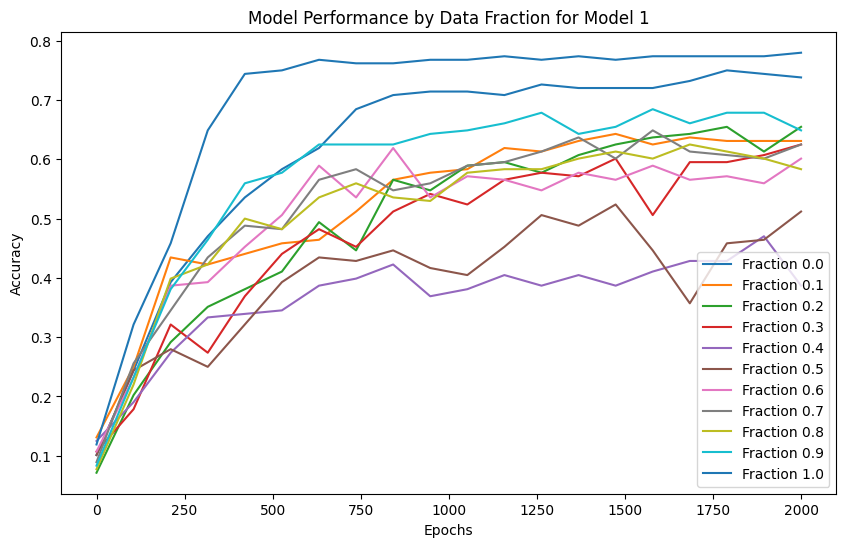

Model 2, Fraction 0.00, Epoch 1, Loss: 2.1930
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.9265
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.6109
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.3370
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 1.1339
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 1.0167
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.9520
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.9035
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.8641
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.8348
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.8074
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.7884
prediction shape 

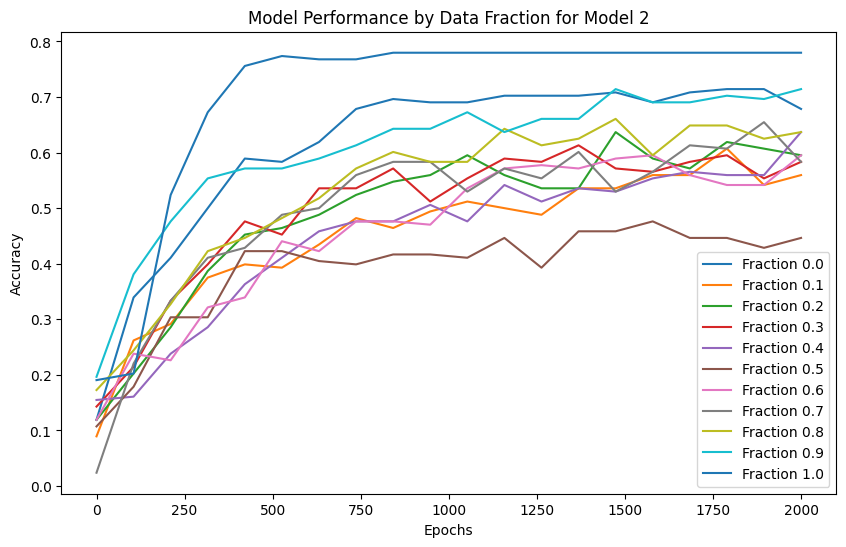

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2129
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 2.0315
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.6245
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.3691
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 1.2423
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 1.1575
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 1.0603
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.9584
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.8776
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.8312
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.7796
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.7545
prediction shape 

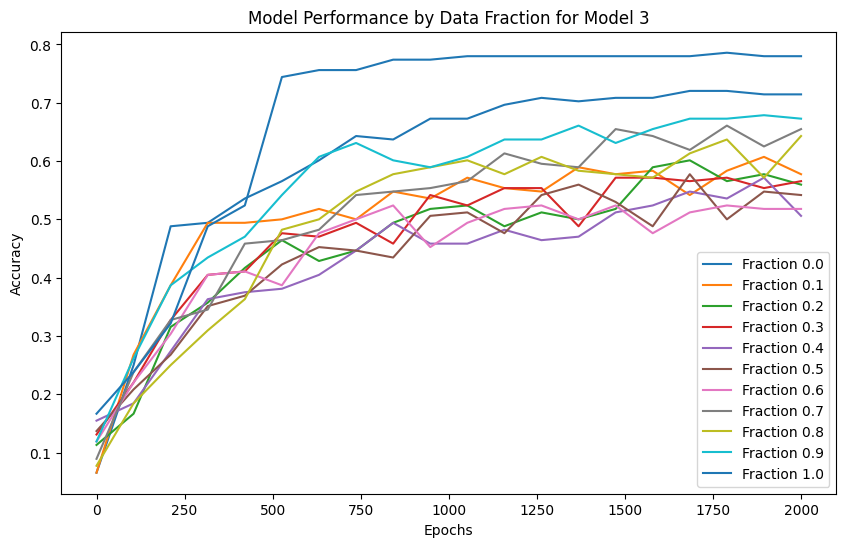

Model 4, Fraction 0.00, Epoch 1, Loss: 2.1939
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.9596
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.6212
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.3962
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 1.2681
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 1.1624
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 1.0838
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 1.0253
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.9698
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.9244
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.8885
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.8541
prediction shape 

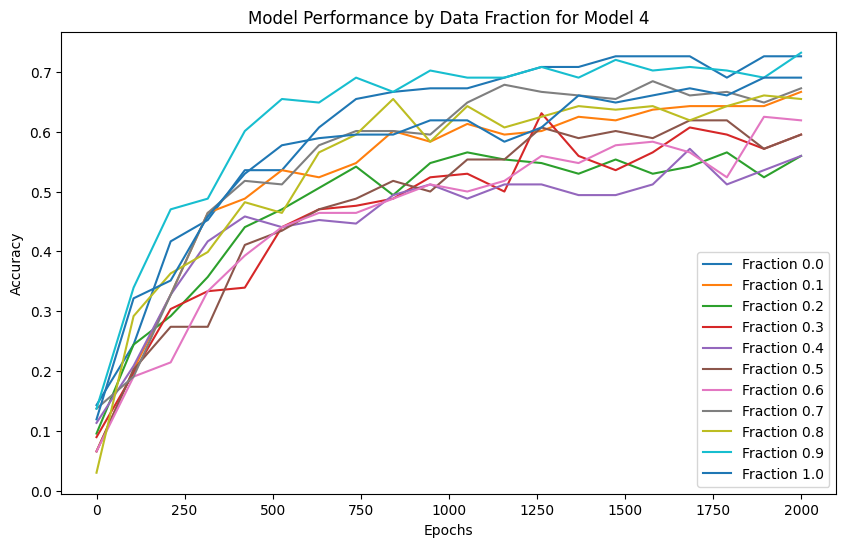

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2063
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 2.0322
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.6941
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 1.3917
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 1.2318
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 1.1226
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 1.0695
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 1.0373
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.9940
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.9688
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.9481
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.9333
prediction shape 

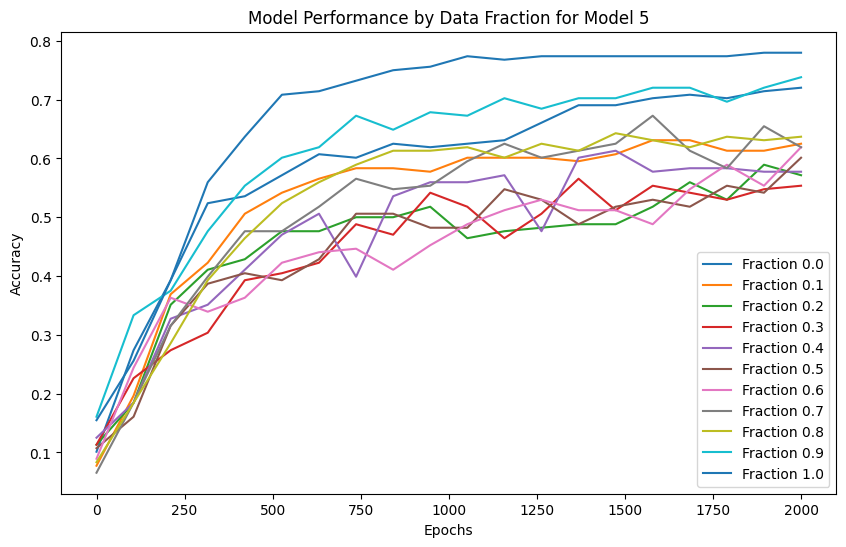

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2031
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 2.0626
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.6928
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 1.3736
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 1.1952
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 1.0640
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.9795
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.9260
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.8901
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.8624
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.8537
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.8122
prediction shape 

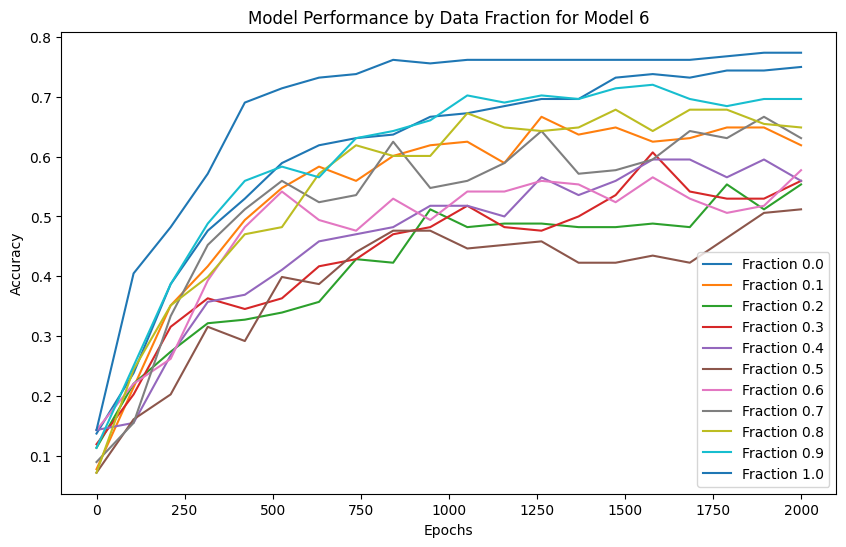

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2094
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.9444
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.6357
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 1.4190
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 1.2810
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 1.1607
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 1.0763
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.9943
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.9185
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.8560
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.8042
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.7698
prediction shape 

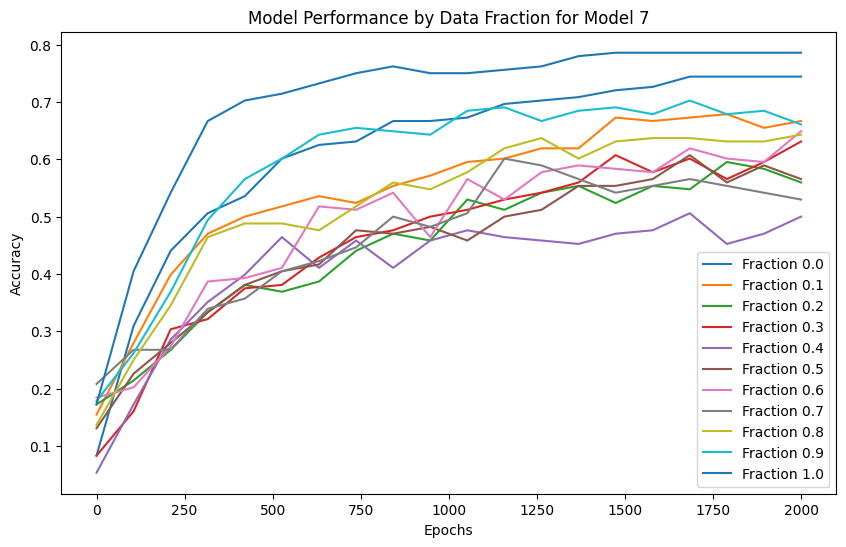

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2085
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 2.0845
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.7088
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.3359
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 1.1437
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 1.0066
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.9411
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.8846
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.8483
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.8143
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.7773
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.7474
prediction shape 

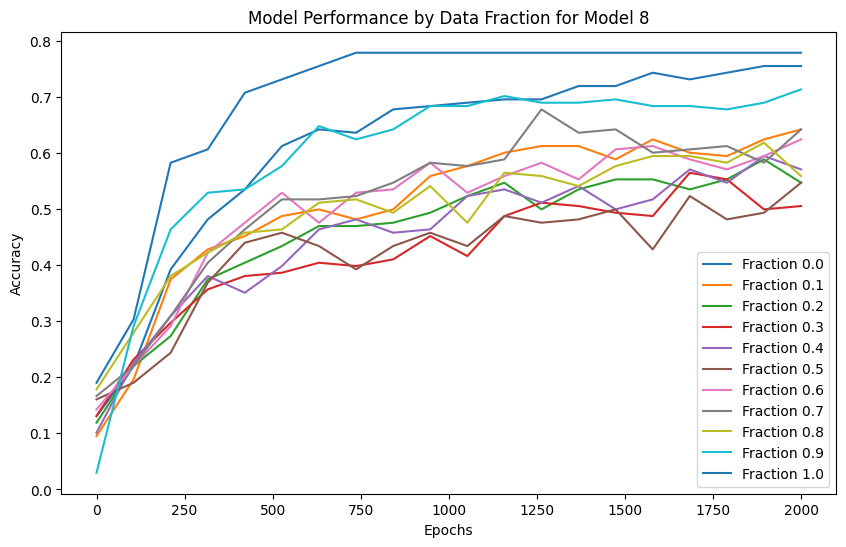

Model 9, Fraction 0.00, Epoch 1, Loss: 2.1995
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 2.0532
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.7132
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.4248
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 1.2159
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 1.0877
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 1.0108
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.9515
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.9069
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.8741
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.8487
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.8263
prediction shape 

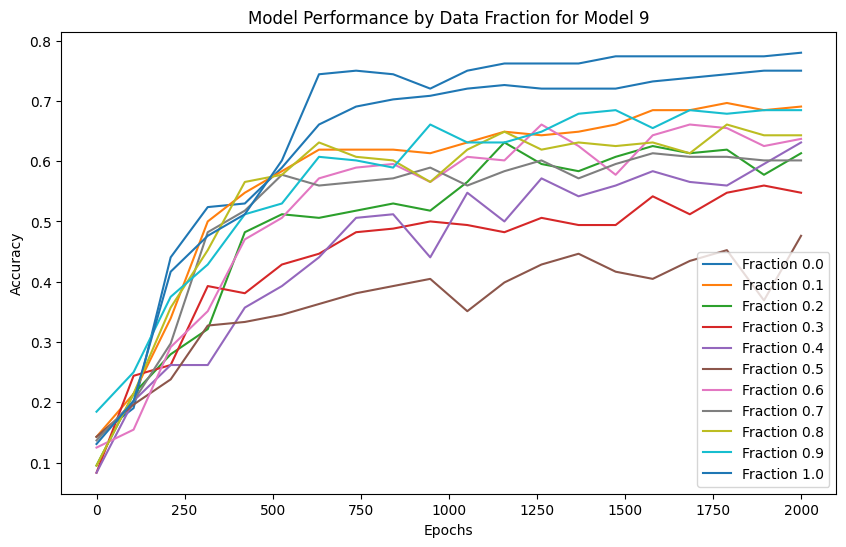

In [94]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 10  # Train 30 different models

songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_different_hard_songs_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [95]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_hard_songs_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0583
  Fraction 0.10, Average Accuracy: 0.1946
  Fraction 0.20, Average Accuracy: 0.3452
  Fraction 0.30, Average Accuracy: 0.4244
  Fraction 0.40, Average Accuracy: 0.5369
  Fraction 0.50, Average Accuracy: 0.5637
  Fraction 0.60, Average Accuracy: 0.6875
  Fraction 0.70, Average Accuracy: 0.7274
  Fraction 0.80, Average Accuracy: 0.7310
  Fraction 0.90, Average Accuracy: 0.7571
  Fraction 1.00, Average Accuracy: 0.7714
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.7405
  Fraction 0.10, Average Accuracy: 0.6863
  Fraction 0.20, Average Accuracy: 0.6470
  Fraction 0.30, Average Accuracy: 0.6238
  Fraction 0.40, Average Accuracy: 0.5435
  Fraction 0.50, Average Accuracy: 0.4720
  Fraction 0.60, Average Accuracy: 0.4452
  Fraction 0.70, Average Accuracy: 0.3774
  Fraction 0.80, Average Accuracy: 0.3143
  Fraction 0.90, Average Accuracy: 0.2452
  Fraction 1.00, Average Accuracy: 0.0696


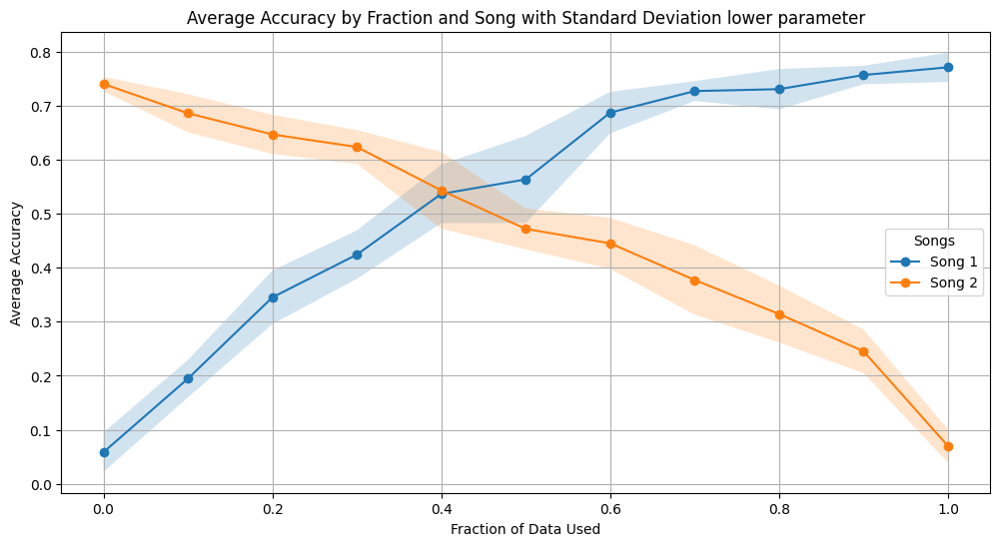

In [96]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension
std_dev_accuracies = accuracies.std(axis=2)  # Standard deviation over the model dimension

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation lower parameter')
plt.xlabel('Fraction of Data Used')
plt.ylabel('Average Accuracy')
plt.legend(title="Songs")
plt.grid(True)
plt.show()
